<a href="https://colab.research.google.com/github/jbeen2/Weather-BigData-Contest/blob/jbeen2/20_LSTM_Sex_Region.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# LSTM

## 0. Data Load

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
import os
os.chdir('/content/drive/MyDrive/Projects/weather')

In [3]:
import numpy as np
import pandas as pd
import datetime
from datetime import timedelta
from tqdm.notebook import tqdm
tqdm.pandas()

import random
from functools import reduce

import matplotlib.pyplot as plt
from matplotlib import rc
import seaborn as sns
%matplotlib inline

rc('font', family='MalgunGothic')
plt.rcParams['axes.unicode_minus'] = False

from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import MinMaxScaler
from keras.models import Sequential
from keras.layers import Dense, LSTM
from sklearn.metrics import mean_squared_error

/usr/local/lib/python3.7/dist-packages/tqdm/std.py:658: FutureWarning: The Panel class is removed from pandas. Accessing it from the top-level namespace will also be removed in the next version
  from pandas import Panel


In [4]:
import tensorflow as tf

device_name = tf.test.gpu_device_name()
if device_name != '/device:GPU:0':
  raise SystemError('GPU device not found')
print('Found GPU at: {}'.format(device_name))

Found GPU at: /device:GPU:0


In [6]:
import torch 

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
n_gpu = torch.cuda.device_count()
torch.cuda.get_device_name(0)

'Tesla P100-PCIE-16GB'

In [7]:
%%time
df_st = pd.read_csv('stationary_causality.csv', encoding='CP949')    # 정상
df_final = pd.read_csv('final_0622.csv', encoding='CP949')           # 날씨지수
weather = pd.read_csv('weather_final2.csv', encoding='CP949')        # 지역별 날씨
loc_weight = pd.read_csv("population_weight.csv", encoding="CP949")  # 지역별 가중치

CPU times: user 16.4 s, sys: 2.38 s, total: 18.8 s
Wall time: 21.2 s


In [8]:
df_st.head(2)

,sm_cat,avg_ta,hm_max,max_pa,max_ta,min_ta,PM10,PM25,avg_ws,sum_ss_hr,total
0,가스온수기,None,None,None,None,None,causality,None,None,None,1
1,가자미,causality,None,None,None,None,None,None,None,None,1


In [9]:
df_final.head(2)

,date,sex,big_cat,sm_cat,qty,ratio,오늘날씨,미세먼지,오늘 비,기상정보,태풍정보,avg_ta,max_ta,min_ta,rn_day,rn_hr1,avg_ws,PM10,PM25,hm_max,sum_ss_hr,max_pa,공휴일여부,주말여부,연_2019,월_2,월_3,월_4,월_5,월_6,월_7,월_8,월_9,월_10,월_11,월_12,분기_2,분기_3,분기_4,요일_1,요일_2,요일_3,요일_4,요일_5,요일_6,봄,여름,가을,겨울,cnt,age_20,age_30,age_40,age_50,age_60
0,2018-01-01,1,식품,가공란,37.0,0.0,10.69387,4.09137,0.0,0.00000,0.04440,0.885198,5.464146,-2.88074,0.0,0.0,2.157094,44.015611,21.477208,61.923313,52.276365,1020.592385,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0.480964,1,0,0,0,0
1,2018-01-01,1,식품,가공란,16.0,0.0,12.42969,6.35294,0.0,0.51282,0.42417,0.885198,5.464146,-2.88074,0.0,0.0,2.157094,44.015611,21.477208,61.923313,52.276365,1020.592385,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0.480964,0,1,0,0,0


In [10]:
weather.head(2)

,날짜,지점번호,평균기온,최고기온,최저기온,일별강수량,1시간최대강수량,평균풍속,지역,PM10,PM25,1시간최대습도,일조시간합,최고현지기압,연,월,일,분기,요일,공휴일명,공휴일여부,주말여부,계절,체감온도,열지수,폭염여부,강수여부,year,month
0,2018-01-01,105,1.3,5.7,-2.1,0.0,0.0,3.7,강릉,20.066667,13.400000,25.4,57.9,1023.0,2018,1,1,1,0,1월1일,1,0,3,7.502056,-39.701524,0,0,2018,1
1,2018-01-01,112,-0.3,2.7,-2.7,0.0,0.0,1.6,인천,37.518681,18.641758,67.2,53.8,1020.3,2018,1,1,1,0,1월1일,1,0,3,9.992379,-42.924922,0,0,2018,1


In [11]:
loc_weight.head(2)

,시도,final_가중치
0,수도권,0.50
1,강원,0.03


In [12]:
df_st['sm_cat'].unique()

array(['가스온수기', '가자미', '감/홍시', '감말랭이', '갓김치', '건강즙/녹용', '건어물 멸치',
       '건어물 황태', '건자두', '견과류', '견과류 땅콩', '견과류 마카다미아', '견과류 잣/은행',
       '견과류 캐슈넛', '견과류 호두', '계란', '공기정화 용품', '공기청정기', '곶감/반건시',
       '과채 음료/주스', '기능성 링클케어 화장품', '기능성 영양보습 화장품', '기초 화장용 에센스',
       '기초 화장용 오일/앰플', '기타 농산물', '기타 한방/환제품', '나물', '남성 메이크업', '남성 스킨',
       '남성 에센스', '남성 크림', '남성 클렌징', '냉풍기', '네일 메이크업 용품', '네일리무버', '네일세트',
       '네일아트', '네일컬러', '네일케어', '녹차', '닭 양념육', '더치커피', '도라지/더덕', '돈풍기',
       '랍스타', '레몬/자몽', '린스', '립앤아이 리무버', '멀티형 에어컨', '메이크업 박스', '무/배추',
       '바나나/파인애플/망고', '바디 세트', '바디케어용 때비누', '바디케어용 슬리밍', '반건조고구마', '반찬류',
       '배/포도/과일즙', '백김치', '베이스 메이크업 세트', '베이스 메이크업용 BB크림',
       '베이스 메이크업용 CC크림', '베이스 메이크업용 메이크업베이스', '베이스 메이크업용 컨실러',
       '베이스 메이크업용 쿠션팩트', '벽걸이형 냉온풍기', '보일러', '뷰티 속눈썹/쌍꺼풀', '뷰티용 기름종이',
       '뷰티용 뷰러', '뷰티용 여드름압출기', '삼치', '색조 메이크업 립글로스', '색조 메이크업 립스틱',
       '색조 메이크업 마스카라', '색조 메이크업 볼터치', '색조 메이크업 속눈썹영양제',
       '색조 메이크업 쉐딩/하이라이터', '색조 메이크업 아이라이너', '생닭/닭부분육', '생선류'

## 1. LSTM

In [13]:
df_final = df_final.fillna(0)

In [14]:
df_final = df_final.rename(columns={"미세먼지" : "미세먼지검색량"})
weather = weather.rename(columns={"PM10" : "미세먼지"})
weather = weather.rename(columns={"PM25" : "초미세먼지"})

In [15]:
# causality 하나라도 있는 소품목만 선택
df_causal = df_st[df_st['total']!=0].reset_index(drop=True)
df_filter = df_final[df_final.sm_cat.isin(df_causal['sm_cat'])].reset_index(drop=True)
df_causal.drop(['total'], axis=1, inplace=True)

In [16]:
# 데이터 형변환
df_lstm = df_filter.copy()
df_group = df_lstm.groupby(['date','sex','age_20','age_30','age_40','age_50','age_60','sm_cat']).mean().reset_index()
df_group.index = pd.to_datetime(df_group['date'], format='%Y-%m-%d')

In [17]:
def MAPE(y_test, y_pred):
	return np.mean(np.abs((y_test - y_pred) / y_test)) * 100 

In [18]:
def region_weather(loc):
    weather_true = weather.drop(['연', '월', '일', '분기', '요일', '공휴일명', '공휴일여부', '주말여부', '계절', 'year', 'month', '지점번호'], axis=1) 
    weather1 = pd.pivot_table(weather_true[weather_true['지역'] == loc], index='날짜', columns='지역').reset_index(level=0)
    weather1.columns = weather1.columns.get_level_values(0)
    return weather1

In [19]:
def loc_weighted_sum(df1, df2, df3, df4, df5, df6, df7, df8, df9) : 
    df = np.sum([np.multiply(df1, loc_weight.loc[0]["final_가중치"]), np.multiply(df2, loc_weight.loc[1]["final_가중치"]), np.multiply(df3, loc_weight.loc[2]["final_가중치"]), 
                 np.multiply(df4, loc_weight.loc[3]["final_가중치"]), np.multiply(df5, loc_weight.loc[4]["final_가중치"]), np.multiply(df6, loc_weight.loc[5]["final_가중치"]), 
                 np.multiply(df7, loc_weight.loc[6]["final_가중치"]), np.multiply(df8, loc_weight.loc[7]["final_가중치"]), np.multiply(df9, loc_weight.loc[8]["final_가중치"])], axis=0)   
    return df

In [20]:
# convert series to supervised learning
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):
	n_vars = 1 if type(data) is list else data.shape[1]
	df = pd.DataFrame(data)
	cols, names = list(), list()
	# input sequence (t-n, ... t-1)
	for i in range(n_in, 0, -1):
		cols.append(df.shift(i))
		names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
	# forecast sequence (t, t+1, ... t+n)
	for i in range(0, n_out):
		cols.append(df.shift(-i))
		if i == 0:
			names += [('var%d(t)' % (j+1)) for j in range(n_vars)]
		else:
			names += [('var%d(t+%d)' % (j+1, i)) for j in range(n_vars)]
	# put it all together
	agg = pd.concat(cols[::-1], axis=1)
	agg.columns = names
	# drop rows with NaN values
	if dropnan:
		agg.dropna(inplace=True)
	return agg

In [21]:
# 지역별 pred 함수
def sm_cat_region_lstm(smcat):
    print('소분류: ', smcat)

    ## 데이터 전처리 ##
    # 각 소분류에 대하여
    df_ex = df_group[df_group['sm_cat']==smcat]

    for regions in ['서울','강릉','대구','부산','광주','전주','대전','청주','제주']:
        # 사용할 변수만 선택
        df_ex = df_ex.rename(columns={"date" : "날짜"})
        default = ['qty', 'ratio','오늘날씨','미세먼지검색량','오늘 비', '기상정보', '태풍정보', 'cnt', '공휴일여부', '주말여부', '날짜']
        causal = []
        df_var = df_causal[df_causal['sm_cat']==smcat]
        for cols in df_var.columns.tolist():
            if len(df_var[df_var[cols]=='causality'])>=1:
                causal.append(cols)
        default.extend(causal)
        df_use = df_ex[default]

        # 지역
        df_merge = df_use.merge(region_weather(regions), on="날짜", how='left')
        df_merge.index = df_merge['날짜']
        df_merge = df_merge.drop(['날짜'], axis=1)

        # 스케일링
        scaler = MinMaxScaler(feature_range=(0, 1))
        df_scale = scaler.fit_transform(df_merge)

        # 데이터 프레임
        n_hours = 7; n_features = df_merge.shape[1]
        df_reframe = series_to_supervised(df_scale, n_hours, 1)

        # 트테분리
        values = df_reframe.values
        n_train_hours = 730 - 90
        train = values[:n_train_hours, :]
        test = values[n_train_hours:, :]
        # split into input and outputs
        n_obs = n_hours * n_features
        train_X, train_y = train[:, :n_obs], train[:, -n_features]
        test_X, test_y = test[:, :n_obs], test[:, -n_features]
        # reshape input to be 3D [samples, timesteps, features]
        train_X = train_X.reshape((train_X.shape[0], n_hours, n_features))
        test_X = test_X.reshape((test_X.shape[0], n_hours, n_features))
        
        ## 모델링 ##
        # design network
        model = Sequential()
        model.add(LSTM(50, input_shape=(train_X.shape[1], train_X.shape[2])))
        model.add(Dense(1))
        model.compile(loss='mae', optimizer='adam')

        # fit network
        # verbose = 0: 결과 출력 안하는 옵션
        history = model.fit(train_X, train_y, epochs=50, batch_size=72, validation_data=(test_X, test_y), verbose=0, shuffle=False)

        # make a prediction
        yhat = model.predict(test_X)
        test_X = test_X.reshape((test_X.shape[0], n_hours*n_features))
        # invert scaling for forecast
        inv_yhat = np.concatenate((yhat, test_X[:, -(n_features-1):]), axis=1)
        inv_yhat = scaler.inverse_transform(inv_yhat)
        inv_yhat = inv_yhat[:,0]
        locals()['pred_'+regions] = inv_yhat
        # invert scaling for actual
        test_y = test_y.reshape((len(test_y), 1))
        inv_y = np.concatenate((test_y, test_X[:, -(n_features-1):]), axis=1)
        inv_y = scaler.inverse_transform(inv_y)
        inv_y = inv_y[:,0]

    # 지역별 가중치 합
    y_pred = loc_weighted_sum(pred_서울, pred_강릉, pred_대구, pred_부산, pred_광주, pred_전주, pred_대전, pred_청주, pred_제주)

    # calculate RMSE
    mse = mean_squared_error(inv_y, y_pred)
    rmse = np.sqrt(mean_squared_error(inv_y, y_pred))
    mape = MAPE(inv_y, y_pred)
    
    # plot predict
    plt.figure(figsize=(15,6))
    plt.plot(df_use.iloc[:n_train_hours,:]['qty'])
    plt.plot(df_use.iloc[n_train_hours:-n_hours,:].index, inv_y, label='true')
    plt.plot(df_use.iloc[n_train_hours:-n_hours,:].index, y_pred, label='pred')
    plt.legend()
    plt.show()
    print('Test MSE: %.3f' % mse)
    print('Test RMSE: %.3f' % rmse)
    print('Test MAPE: %.3f' % mape)
    print('=========='*10)

In [22]:
date = []; sex_ls = []; age_ls = []; sm_cat = []; pred = []

In [23]:
mse_ls = []; rmse_ls = []; mape_ls = []

In [ ]:
# 혜린
df_lstm['sm_cat'].unique()[:29]

array(['가스온수기', '가자미', '감말랭이', '갓김치', '건강즙/녹용', '건어물 멸치', '건어물 황태', '건자두',
       '견과류', '견과류 땅콩', '견과류 마카다미아', '견과류 잣/은행', '견과류 호두', '공기정화 용품',
       '공기청정기', '과채 음료/주스', '기능성 링클케어 화장품', '기능성 영양보습 화장품',
       '기초 화장용 오일/앰플', '기타 농산물', '기타 한방/환제품', '나물', '남성 스킨', '남성 크림',
       '남성 클렌징', '네일리무버', '네일세트', '네일아트', '네일컬러'], dtype=object)

In [24]:
# 재빈
df_lstm['sm_cat'].unique()[29:58]

array(['녹차', '닭 양념육', '더치커피', '돈풍기', '랍스타', '레몬/자몽', '린스', '메이크업 박스',
       '무/배추', '바나나/파인애플/망고', '바디 세트', '반건조고구마', '배/포도/과일즙', '백김치',
       '베이스 메이크업용 BB크림', '베이스 메이크업용 CC크림', '베이스 메이크업용 메이크업베이스',
       '벽걸이형 냉온풍기', '보일러', '뷰티 속눈썹/쌍꺼풀', '뷰티용 기름종이', '뷰티용 뷰러',
       '뷰티용 여드름압출기', '삼치', '색조 메이크업 립글로스', '색조 메이크업 마스카라', '색조 메이크업 볼터치',
       '색조 메이크업 쉐딩/하이라이터', '생수'], dtype=object)

In [ ]:
# 보민
df_lstm['sm_cat'].unique()[58:]

array(['샤워코롱', '선크림', '소고기 등심/안심', '수산 생물', '스킨케어 코팩', '아몬드유/코코넛밀크',
       '에이드', '옻/칡/쑥즙', '의류건조기', '이온음료', '인스턴트커피', '전복 생물', '절임배추/김치속',
       '젓갈류', '제습기', '차/곡물 음료', '천장형 에어컨', '카페 푸드', '클렌징 크림', '클렌징 폼',
       '태닝용 선크림', '팩도구', '표고버섯', '풋워시/스크럽', '풋크림', '해조류 다시마',
       '헤어스타일링용 펌제', '헤어케어세트', '홍어', '화장 비누', '멀티형 에어컨'], dtype=object)

In [ ]:
df_lstm['sm_cat'].unique()

array(['가스온수기', '가자미', '감말랭이', '갓김치', '건강즙/녹용', '건어물 멸치', '건어물 황태', '건자두',
       '견과류', '견과류 땅콩', '견과류 마카다미아', '견과류 잣/은행', '견과류 호두', '공기정화 용품',
       '공기청정기', '과채 음료/주스', '기능성 링클케어 화장품', '기능성 영양보습 화장품',
       '기초 화장용 오일/앰플', '기타 농산물', '기타 한방/환제품', '나물', '남성 스킨', '남성 크림',
       '남성 클렌징', '네일리무버', '네일세트', '네일아트', '네일컬러', '녹차', '닭 양념육', '더치커피',
       '돈풍기', '랍스타', '레몬/자몽', '린스', '메이크업 박스', '무/배추', '바나나/파인애플/망고',
       '바디 세트', '반건조고구마', '배/포도/과일즙', '백김치', '베이스 메이크업용 BB크림',
       '베이스 메이크업용 CC크림', '베이스 메이크업용 메이크업베이스', '벽걸이형 냉온풍기', '보일러',
       '뷰티 속눈썹/쌍꺼풀', '뷰티용 기름종이', '뷰티용 뷰러', '뷰티용 여드름압출기', '삼치',
       '색조 메이크업 립글로스', '색조 메이크업 마스카라', '색조 메이크업 볼터치', '색조 메이크업 쉐딩/하이라이터',
       '생수', '샤워코롱', '선크림', '소고기 등심/안심', '수산 생물', '스킨케어 코팩', '아몬드유/코코넛밀크',
       '에이드', '옻/칡/쑥즙', '의류건조기', '이온음료', '인스턴트커피', '전복 생물', '절임배추/김치속',
       '젓갈류', '제습기', '차/곡물 음료', '천장형 에어컨', '카페 푸드', '클렌징 크림', '클렌징 폼',
       '태닝용 선크림', '팩도구', '표고버섯', '풋워시/스크럽', '풋크림', '해조류 다시마',
       '헤어스타일링용 펌제', '헤어케어세트', '홍어',

소분류:  녹차
성별:  남성 , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  
findfont: Font family ['MalgunGothic'] not found. Falling back to DejaVu Sans.


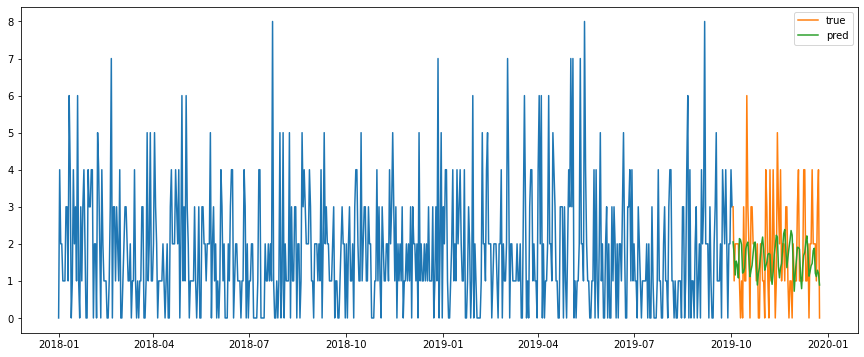

Test MSE: 1.884
Test RMSE: 1.373
Test MAPE: inf
성별:  남성 , 연령:  30대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


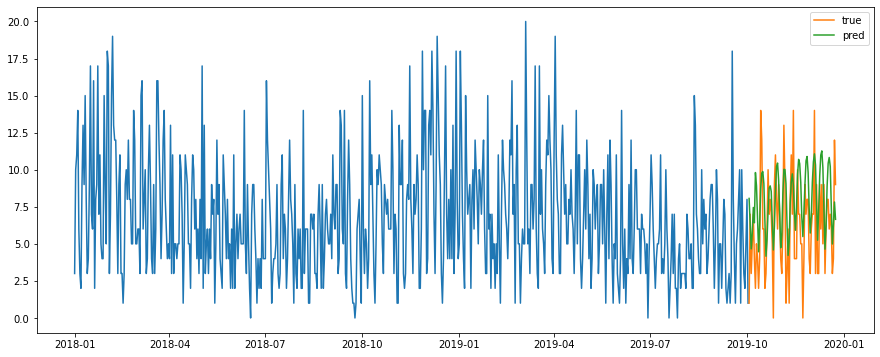

Test MSE: 10.394
Test RMSE: 3.224
Test MAPE: inf
성별:  남성 , 연령:  40대


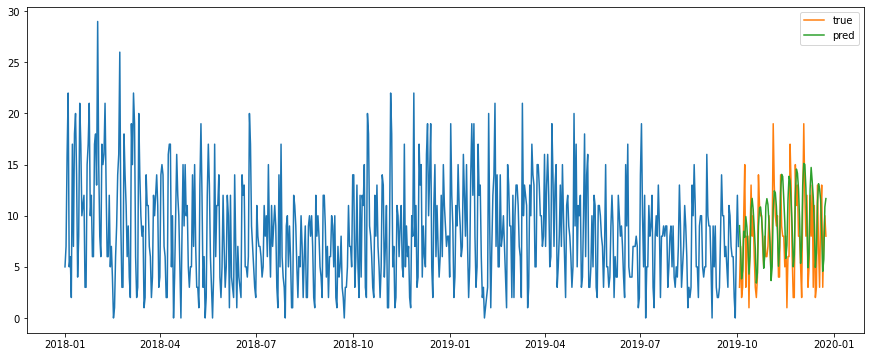

Test MSE: 13.857
Test RMSE: 3.722
Test MAPE: 65.194
성별:  남성 , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


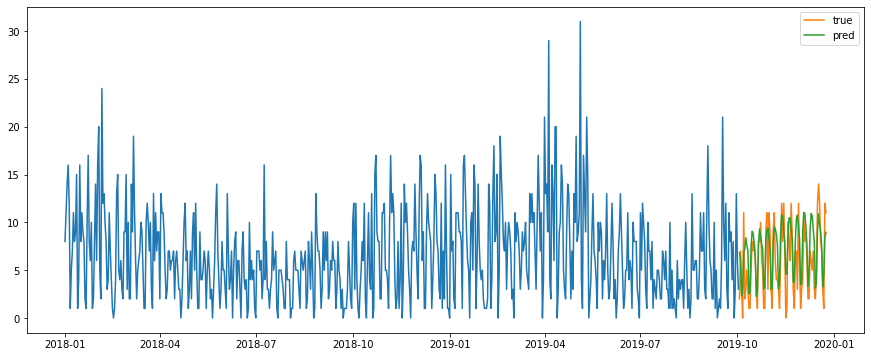

Test MSE: 8.154
Test RMSE: 2.855
Test MAPE: inf
성별:  남성 , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


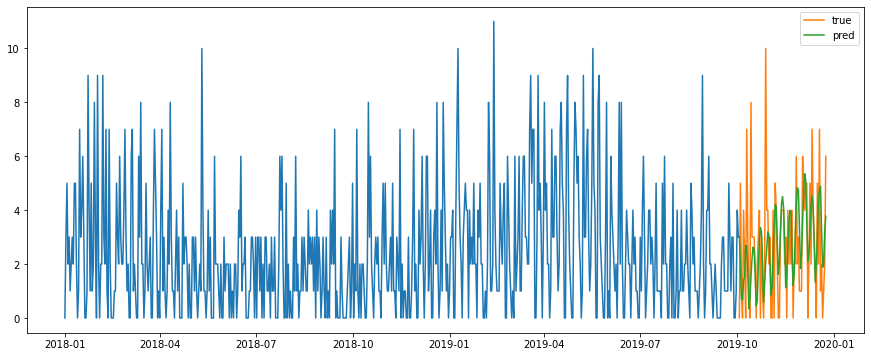

Test MSE: 3.937
Test RMSE: 1.984
Test MAPE: inf
성별:  여성  , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


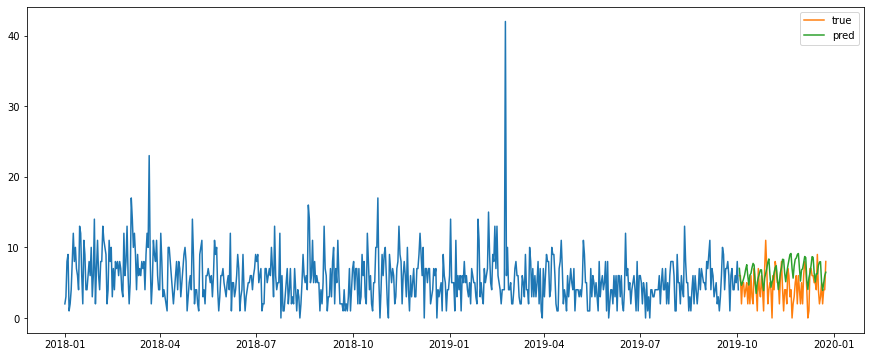

Test MSE: 9.825
Test RMSE: 3.134
Test MAPE: inf
성별:  여성  , 연령:  30대


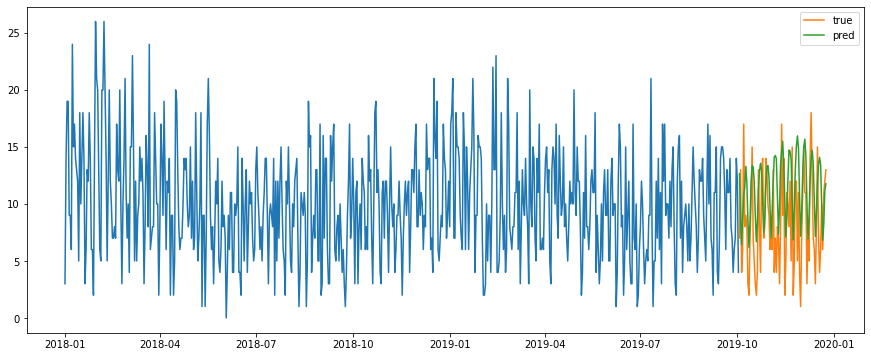

Test MSE: 22.707
Test RMSE: 4.765
Test MAPE: 81.839
성별:  여성  , 연령:  40대


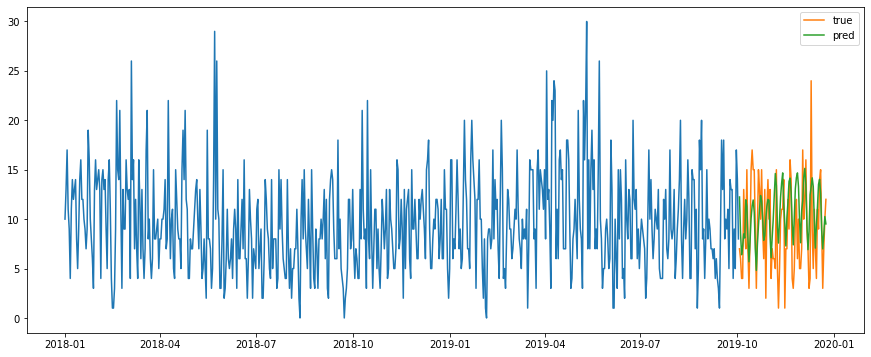

Test MSE: 17.456
Test RMSE: 4.178
Test MAPE: 69.169
성별:  여성  , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


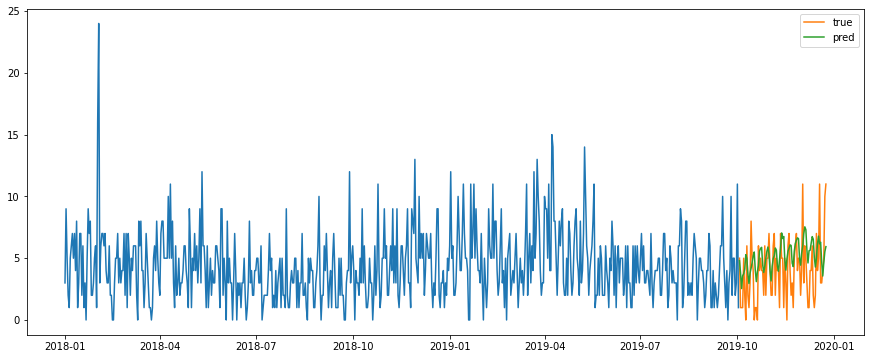

Test MSE: 6.750
Test RMSE: 2.598
Test MAPE: inf
성별:  여성  , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


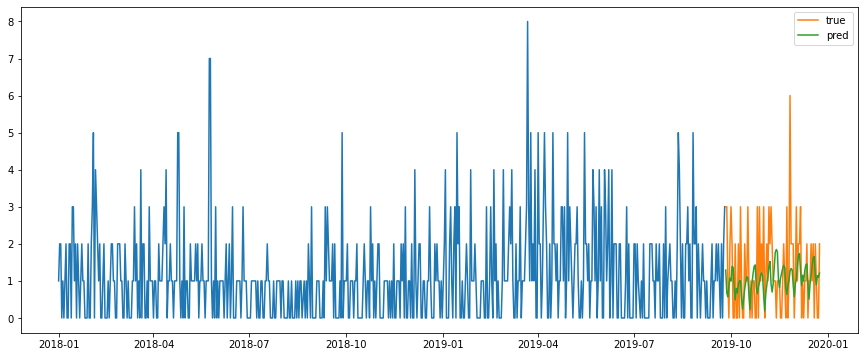

Test MSE: 1.352
Test RMSE: 1.163
Test MAPE: inf
소분류:  닭 양념육
성별:  남성 , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


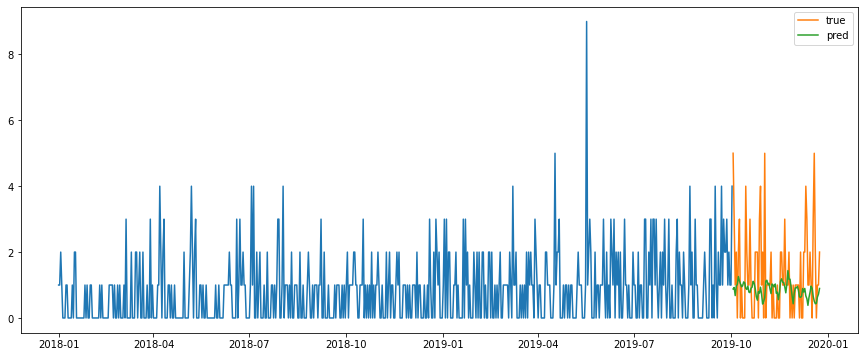

Test MSE: 1.998
Test RMSE: 1.413
Test MAPE: inf
성별:  남성 , 연령:  30대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


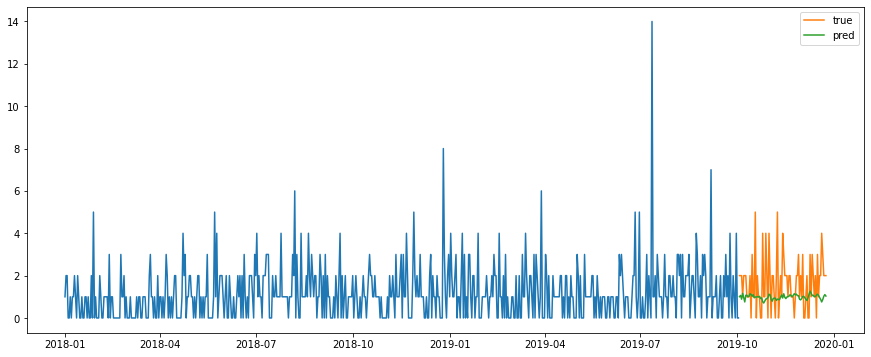

Test MSE: 1.889
Test RMSE: 1.374
Test MAPE: inf
성별:  남성 , 연령:  40대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


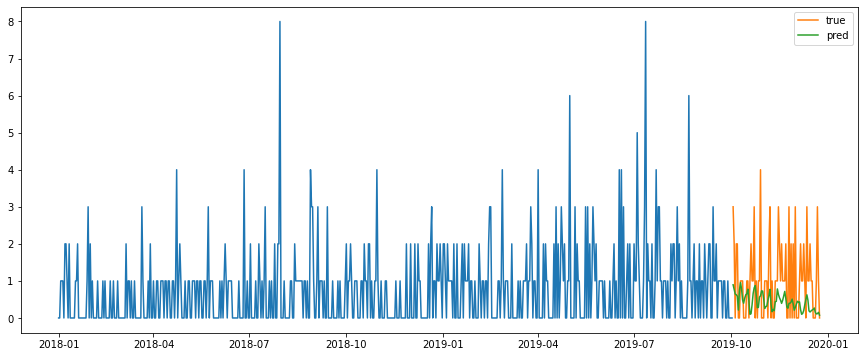

Test MSE: 1.333
Test RMSE: 1.155
Test MAPE: inf
성별:  남성 , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


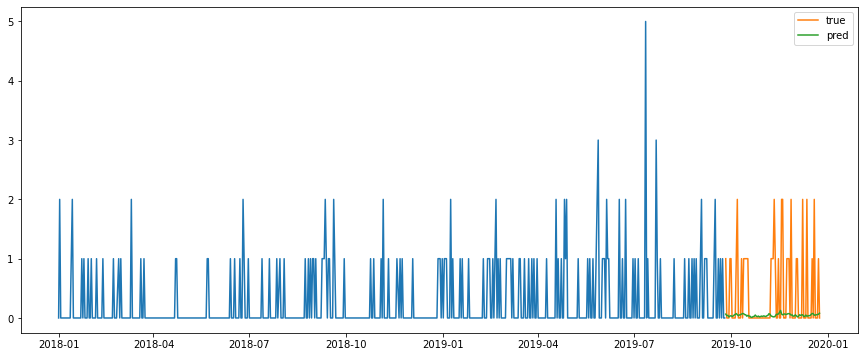

Test MSE: 0.557
Test RMSE: 0.746
Test MAPE: inf
성별:  남성 , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


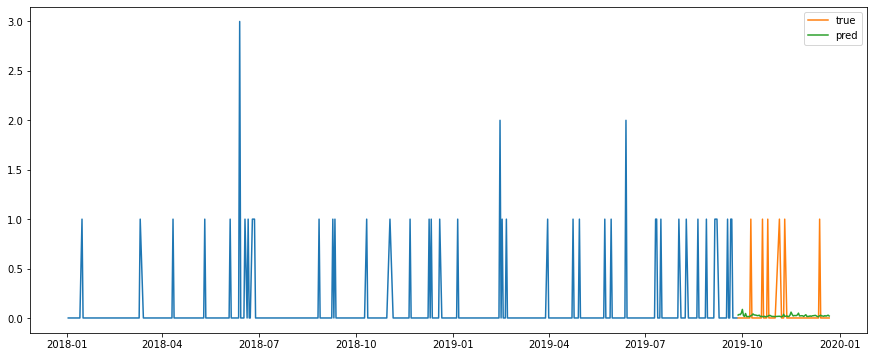

Test MSE: 0.079
Test RMSE: 0.281
Test MAPE: inf
성별:  여성  , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


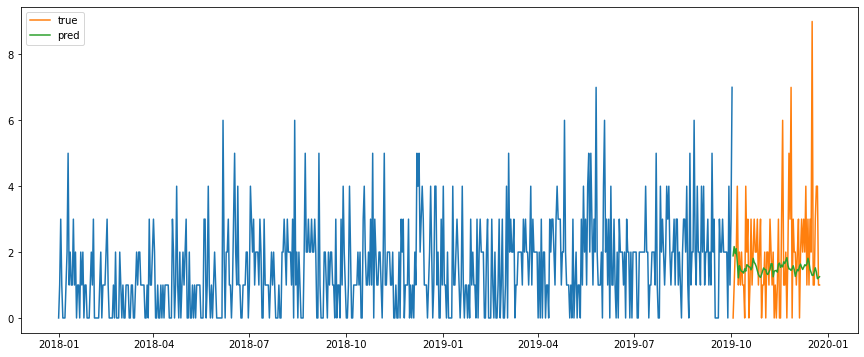

Test MSE: 2.785
Test RMSE: 1.669
Test MAPE: inf
성별:  여성  , 연령:  30대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


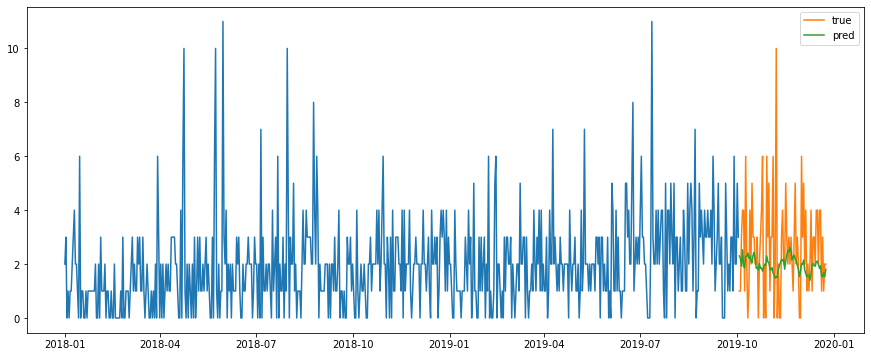

Test MSE: 3.632
Test RMSE: 1.906
Test MAPE: inf
성별:  여성  , 연령:  40대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


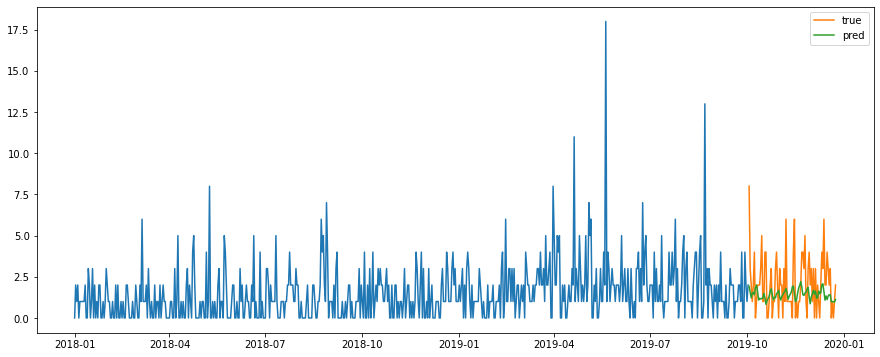

Test MSE: 3.176
Test RMSE: 1.782
Test MAPE: inf
성별:  여성  , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


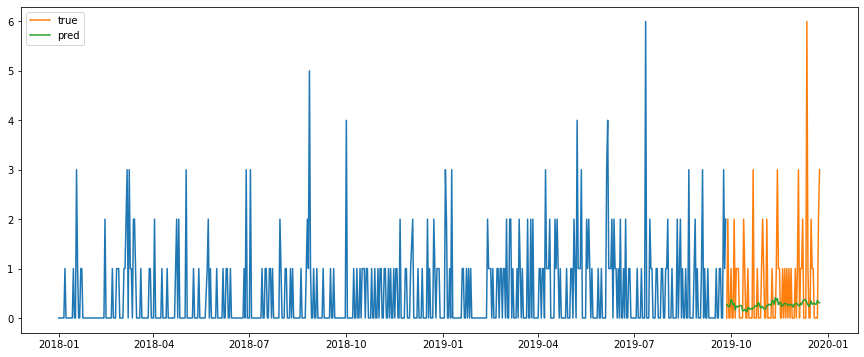

Test MSE: 1.155
Test RMSE: 1.075
Test MAPE: inf
성별:  여성  , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


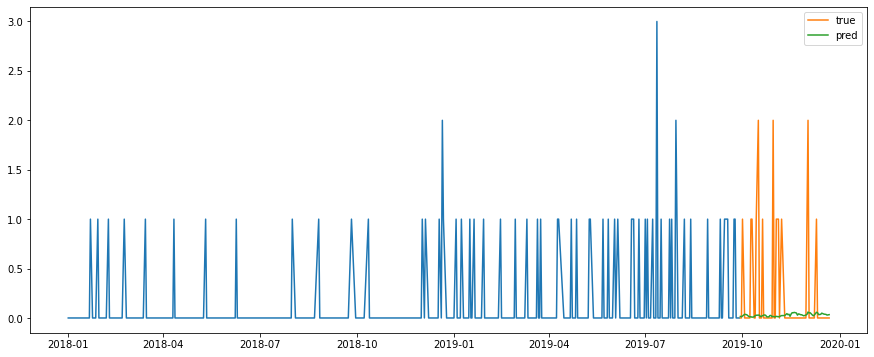

Test MSE: 0.321
Test RMSE: 0.566
Test MAPE: inf
소분류:  더치커피
성별:  남성 , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


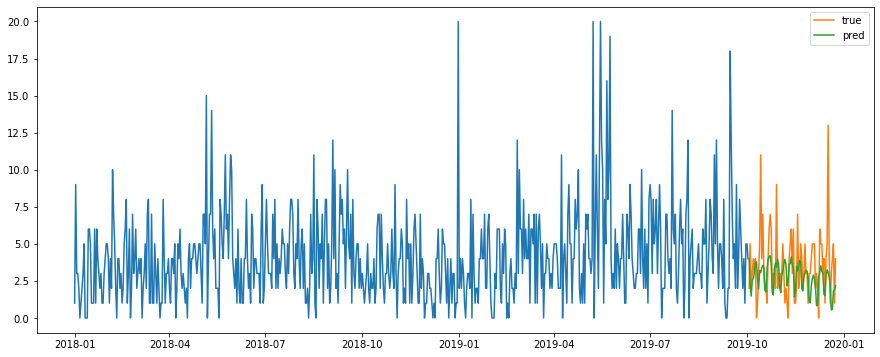

Test MSE: 5.328
Test RMSE: 2.308
Test MAPE: inf
성별:  남성 , 연령:  30대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


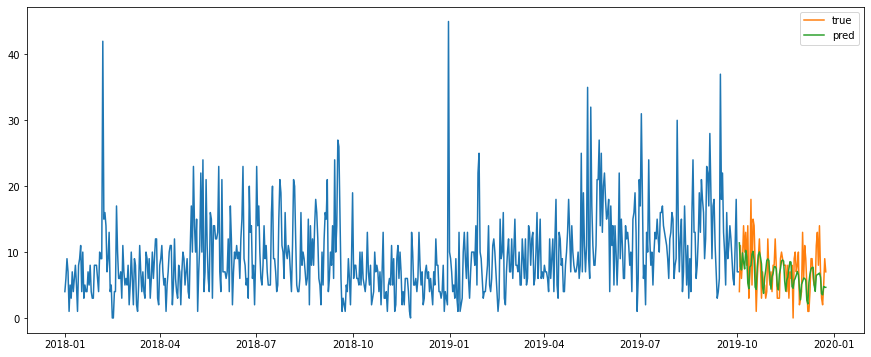

Test MSE: 11.443
Test RMSE: 3.383
Test MAPE: inf
성별:  남성 , 연령:  40대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


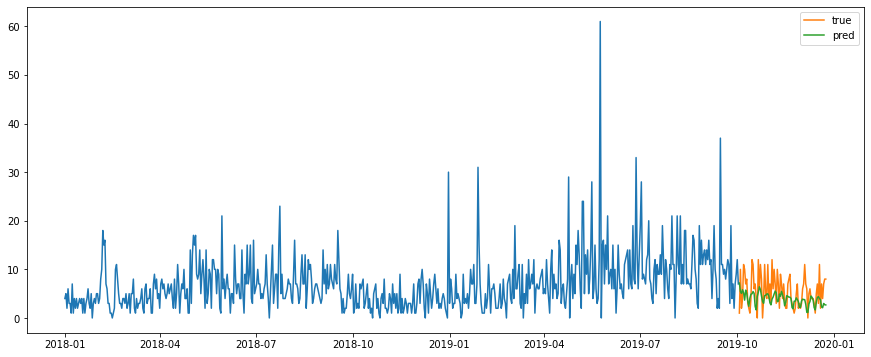

Test MSE: 12.584
Test RMSE: 3.547
Test MAPE: inf
성별:  남성 , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


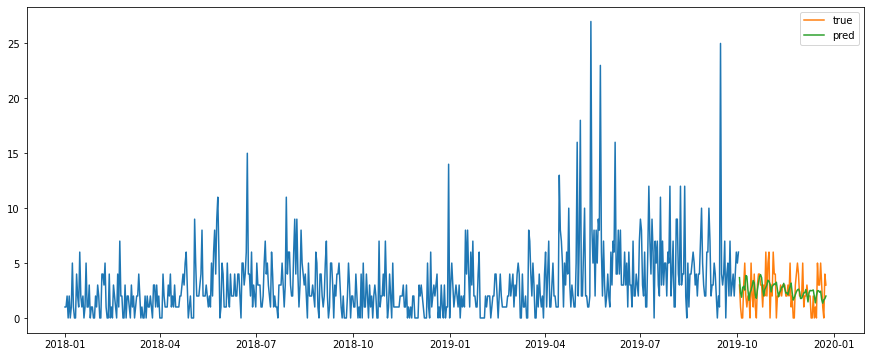

Test MSE: 2.419
Test RMSE: 1.555
Test MAPE: inf
성별:  남성 , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


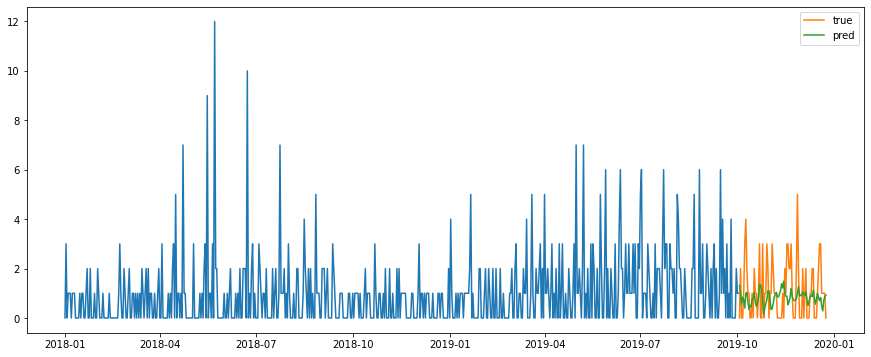

Test MSE: 1.455
Test RMSE: 1.206
Test MAPE: inf
성별:  여성  , 연령:  20대


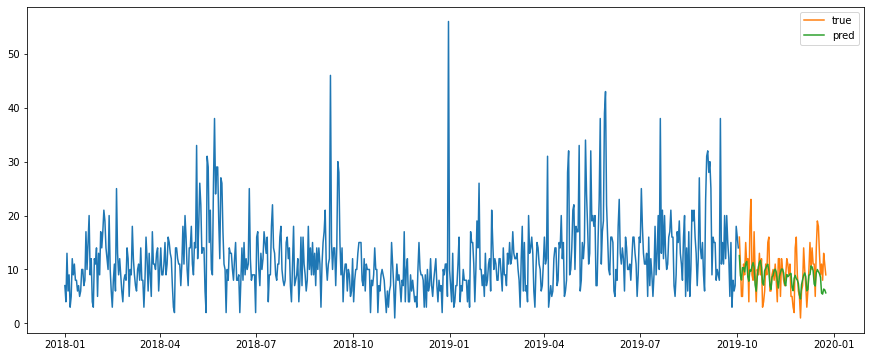

Test MSE: 14.664
Test RMSE: 3.829
Test MAPE: 40.379
성별:  여성  , 연령:  30대


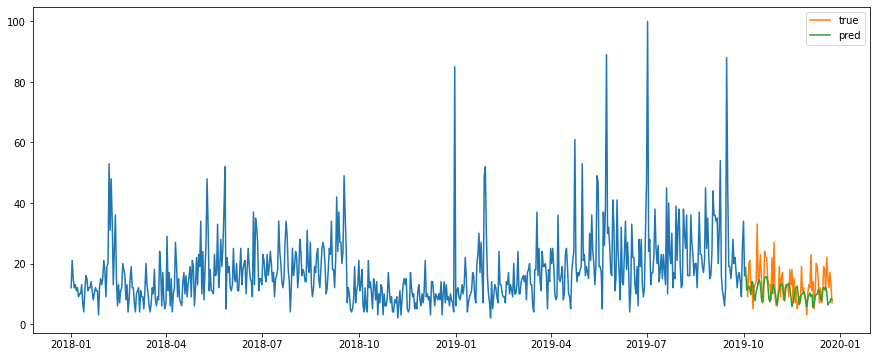

Test MSE: 36.953
Test RMSE: 6.079
Test MAPE: 33.463
성별:  여성  , 연령:  40대


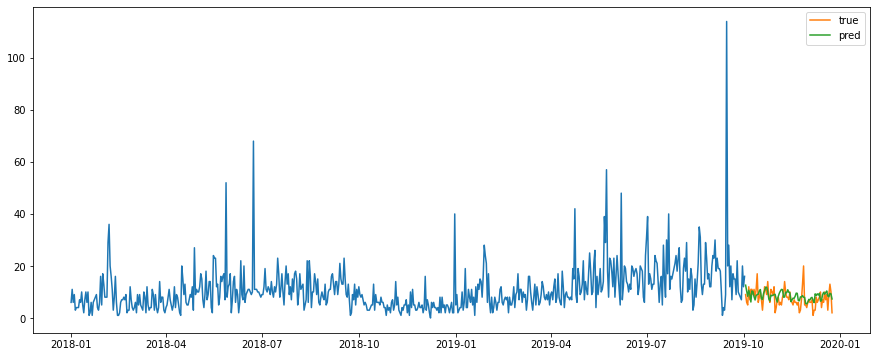

Test MSE: 11.147
Test RMSE: 3.339
Test MAPE: 53.314
성별:  여성  , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


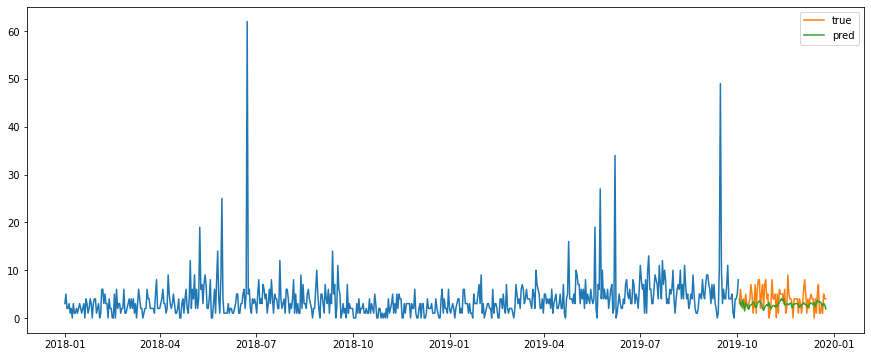

Test MSE: 5.926
Test RMSE: 2.434
Test MAPE: inf
성별:  여성  , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


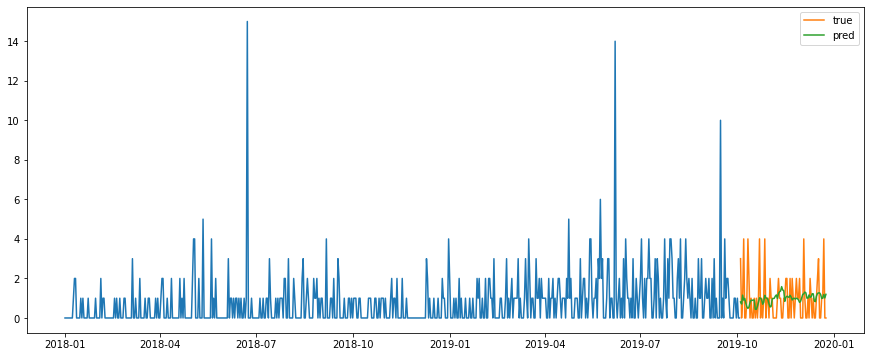

Test MSE: 1.377
Test RMSE: 1.173
Test MAPE: inf
소분류:  돈풍기
성별:  남성 , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


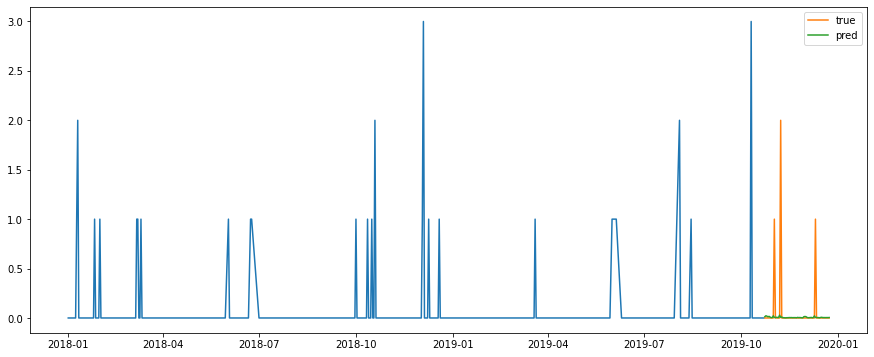

Test MSE: 0.096
Test RMSE: 0.310
Test MAPE: inf
성별:  남성 , 연령:  30대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


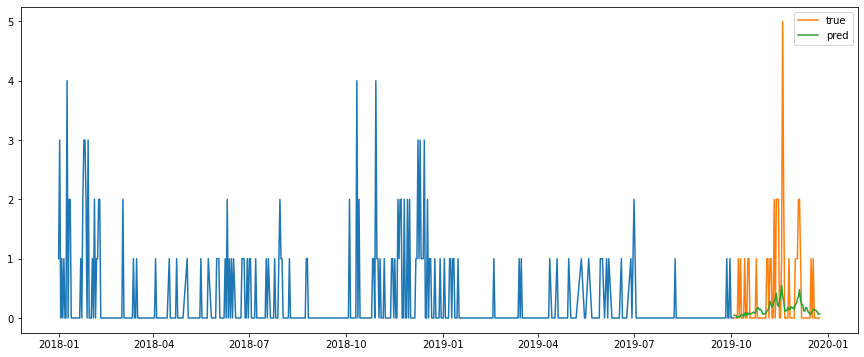

Test MSE: 0.667
Test RMSE: 0.817
Test MAPE: inf
성별:  남성 , 연령:  40대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


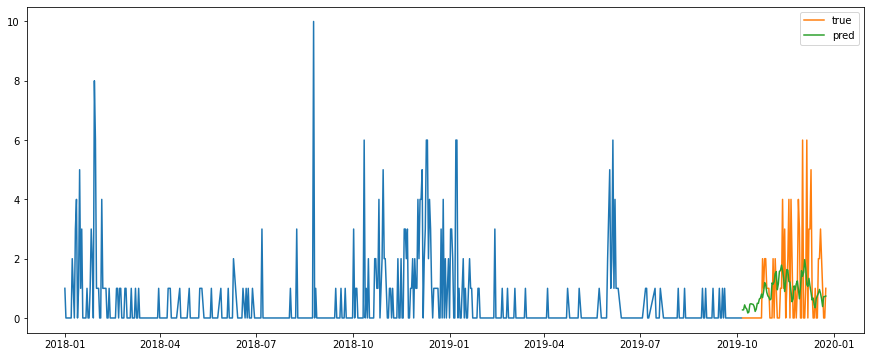

Test MSE: 2.017
Test RMSE: 1.420
Test MAPE: inf
성별:  남성 , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


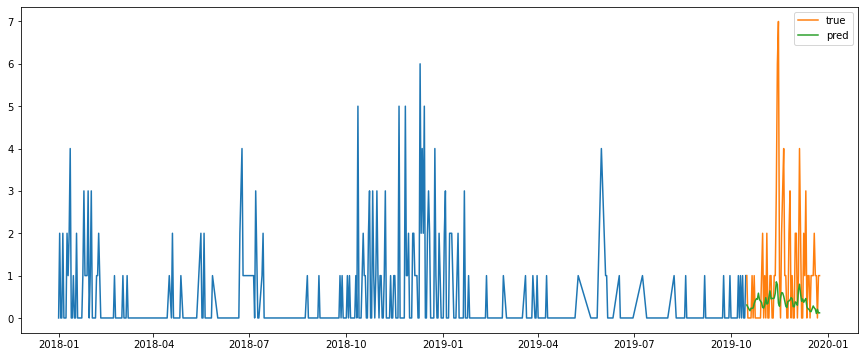

Test MSE: 2.232
Test RMSE: 1.494
Test MAPE: inf
성별:  남성 , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


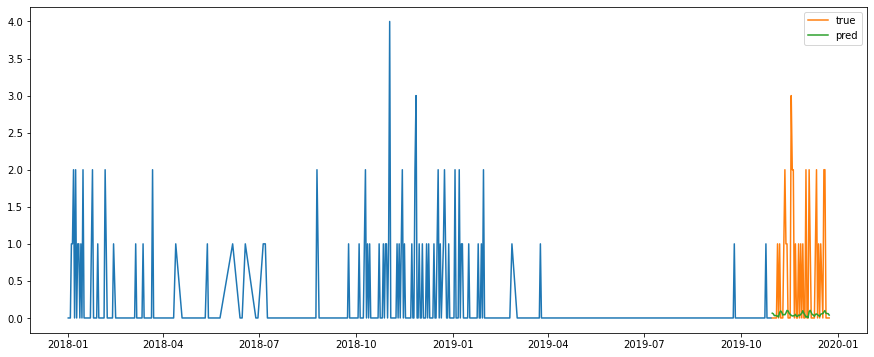

Test MSE: 0.938
Test RMSE: 0.969
Test MAPE: inf
성별:  여성  , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


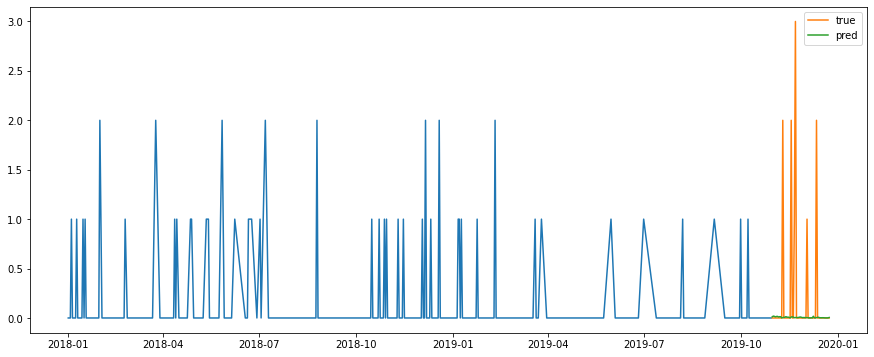

Test MSE: 0.416
Test RMSE: 0.645
Test MAPE: inf
성별:  여성  , 연령:  30대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


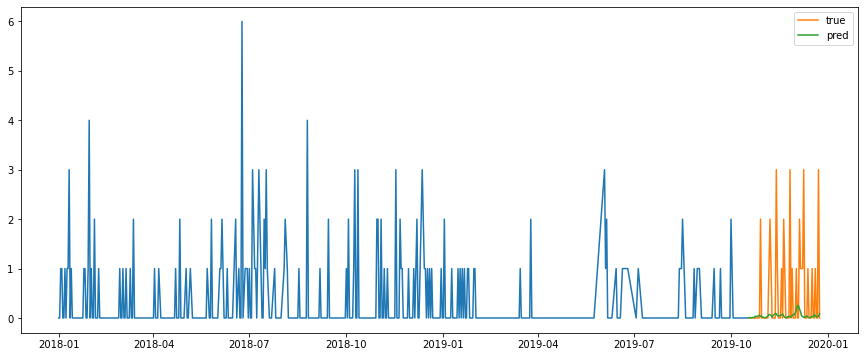

Test MSE: 0.906
Test RMSE: 0.952
Test MAPE: inf
성별:  여성  , 연령:  40대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


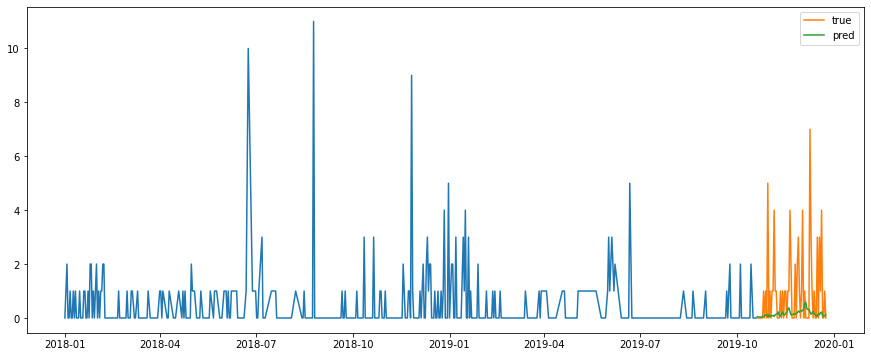

Test MSE: 2.826
Test RMSE: 1.681
Test MAPE: inf
성별:  여성  , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


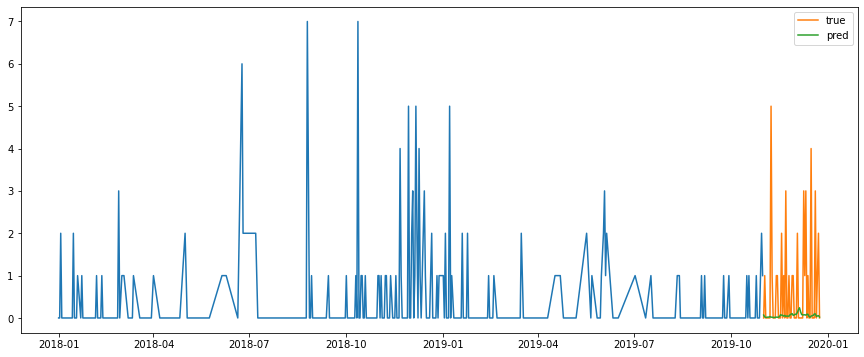

Test MSE: 1.778
Test RMSE: 1.334
Test MAPE: inf
성별:  여성  , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


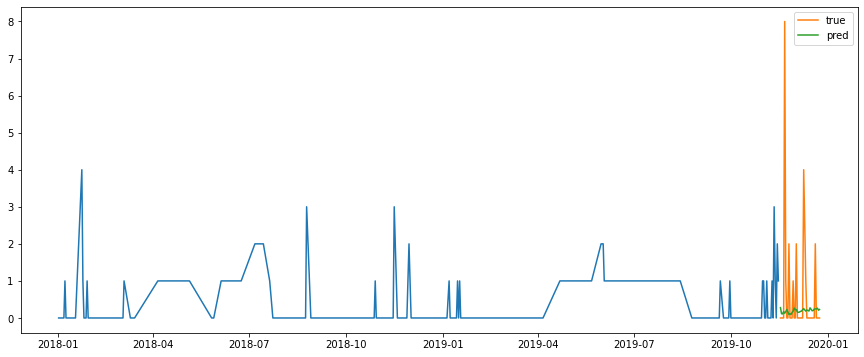

Test MSE: 2.543
Test RMSE: 1.595
Test MAPE: inf
소분류:  랍스타
성별:  남성 , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


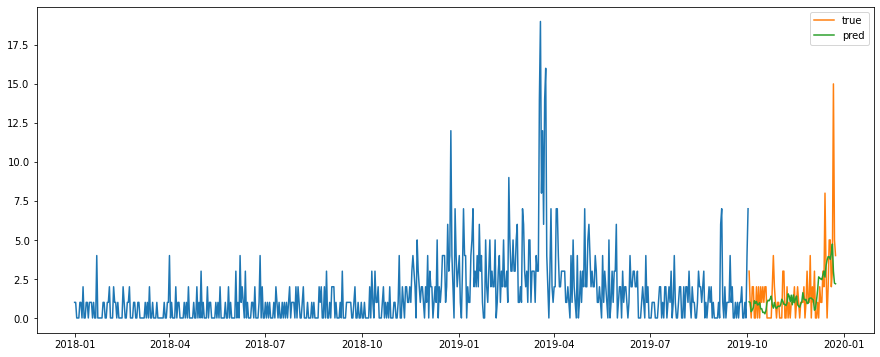

Test MSE: 3.826
Test RMSE: 1.956
Test MAPE: inf
성별:  남성 , 연령:  30대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


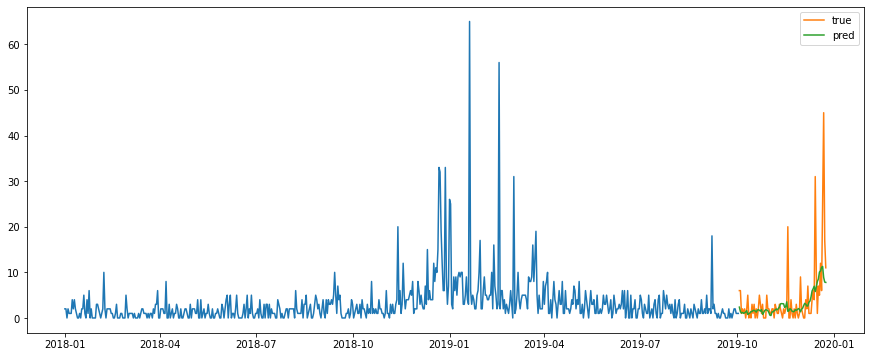

Test MSE: 35.864
Test RMSE: 5.989
Test MAPE: inf
성별:  남성 , 연령:  40대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


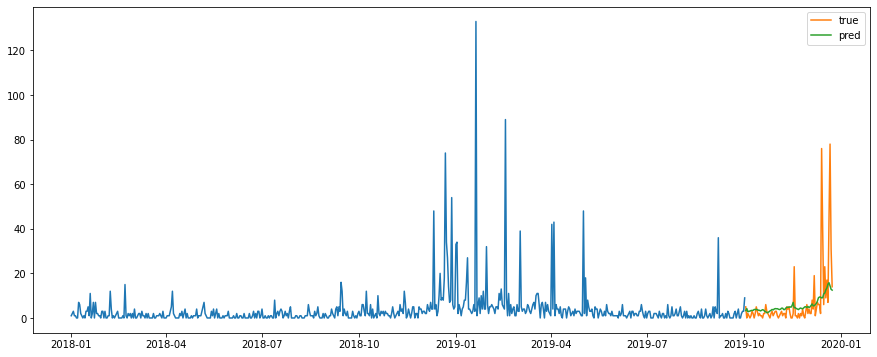

Test MSE: 144.147
Test RMSE: 12.006
Test MAPE: inf
성별:  남성 , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


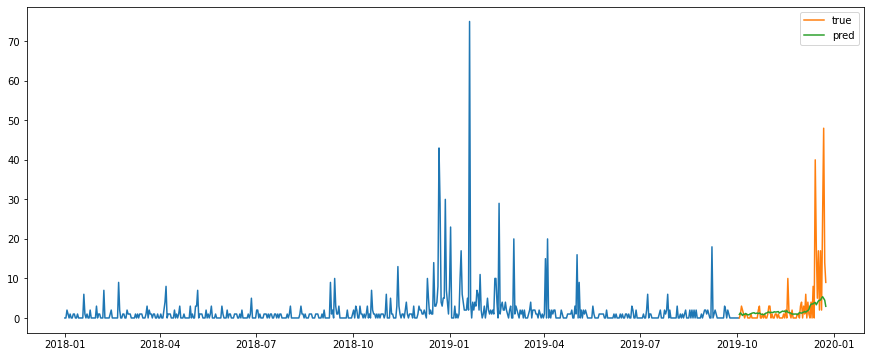

Test MSE: 54.202
Test RMSE: 7.362
Test MAPE: inf
성별:  남성 , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


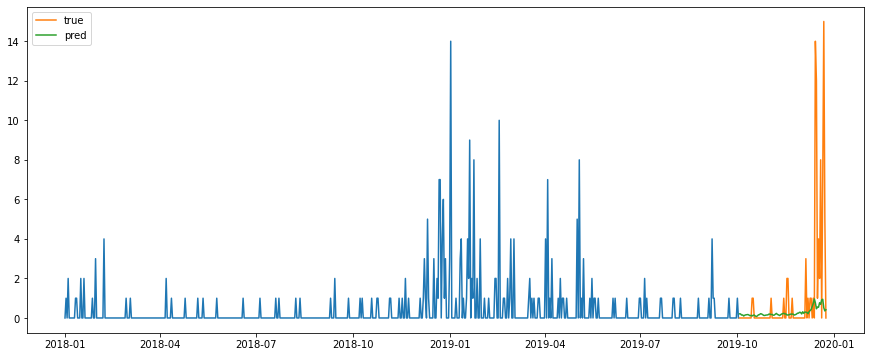

Test MSE: 8.032
Test RMSE: 2.834
Test MAPE: inf
성별:  여성  , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


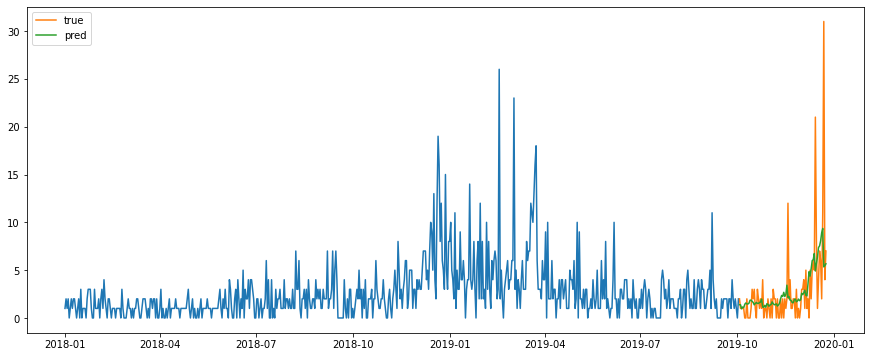

Test MSE: 15.219
Test RMSE: 3.901
Test MAPE: inf
성별:  여성  , 연령:  30대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


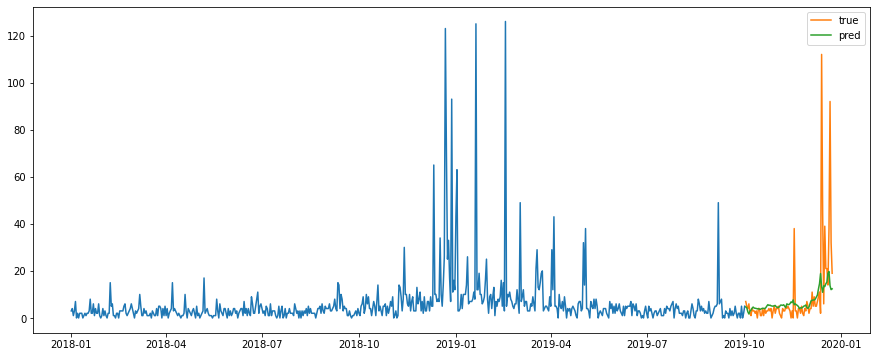

Test MSE: 246.338
Test RMSE: 15.695
Test MAPE: inf
성별:  여성  , 연령:  40대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


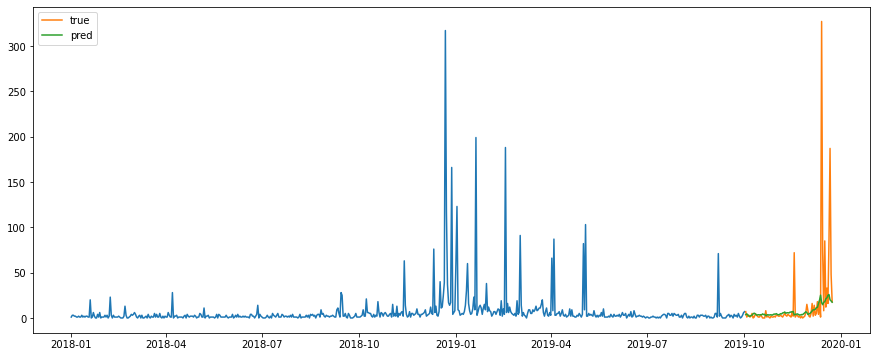

Test MSE: 1724.222
Test RMSE: 41.524
Test MAPE: inf
성별:  여성  , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


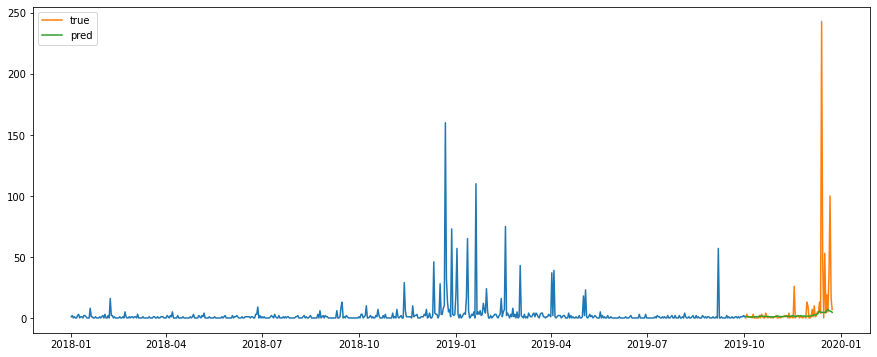

Test MSE: 871.505
Test RMSE: 29.521
Test MAPE: inf
성별:  여성  , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


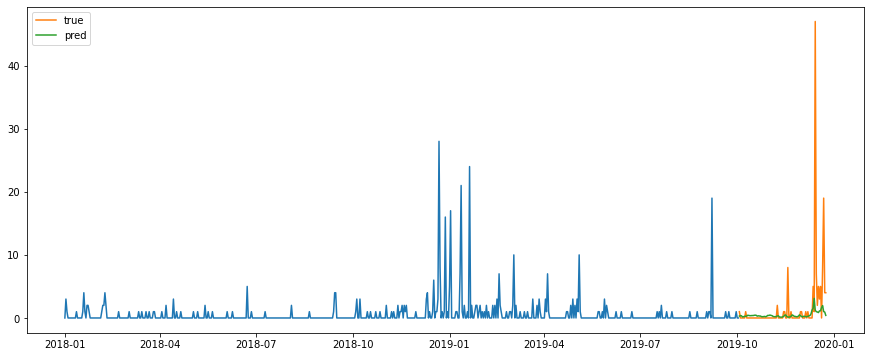

Test MSE: 31.883
Test RMSE: 5.646
Test MAPE: inf
소분류:  레몬/자몽
성별:  남성 , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


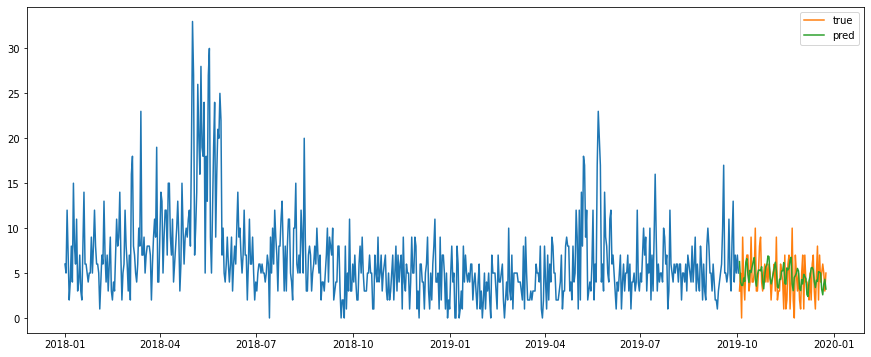

Test MSE: 5.962
Test RMSE: 2.442
Test MAPE: inf
성별:  남성 , 연령:  30대


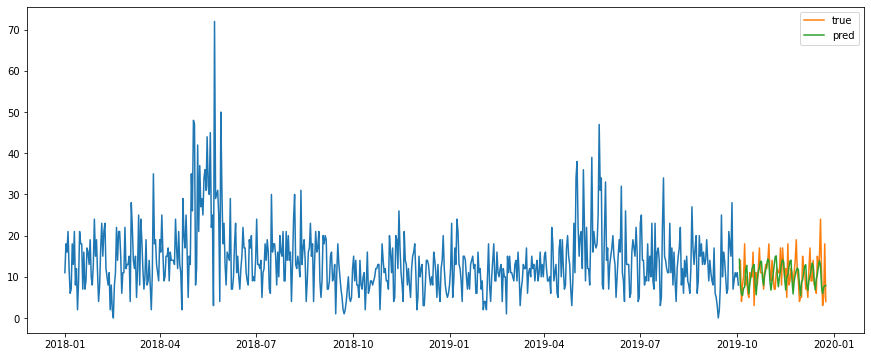

Test MSE: 16.806
Test RMSE: 4.099
Test MAPE: 36.230
성별:  남성 , 연령:  40대


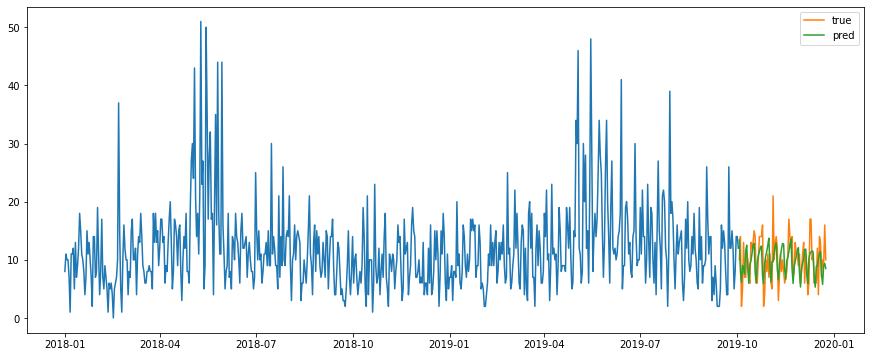

Test MSE: 12.220
Test RMSE: 3.496
Test MAPE: 34.995
성별:  남성 , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


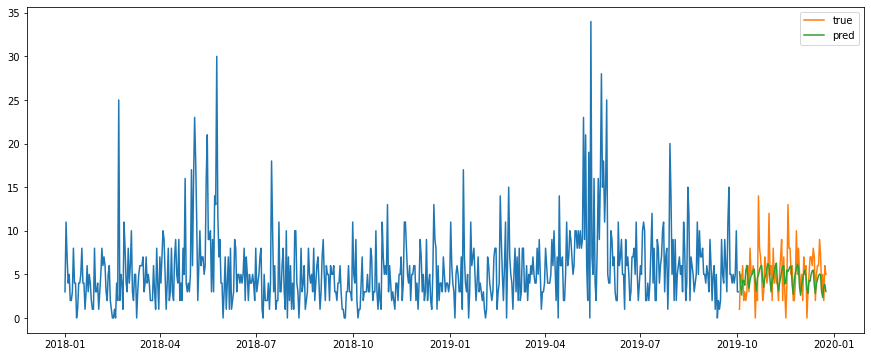

Test MSE: 6.447
Test RMSE: 2.539
Test MAPE: inf
성별:  남성 , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


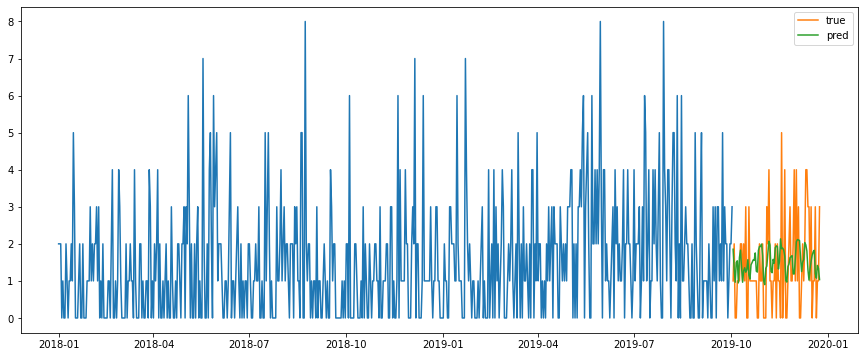

Test MSE: 1.504
Test RMSE: 1.226
Test MAPE: inf
성별:  여성  , 연령:  20대


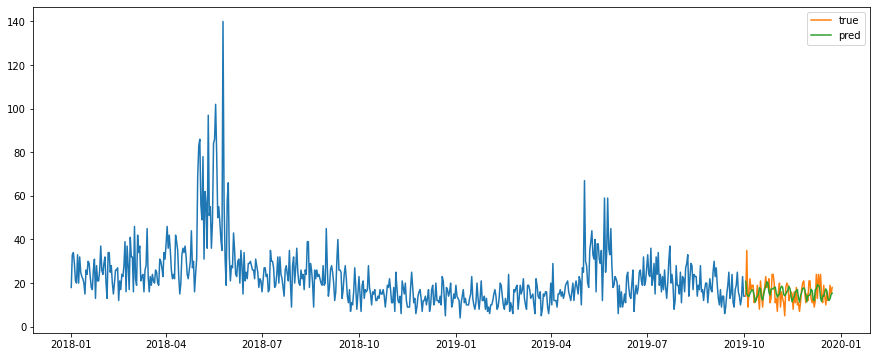

Test MSE: 24.758
Test RMSE: 4.976
Test MAPE: 29.764
성별:  여성  , 연령:  30대


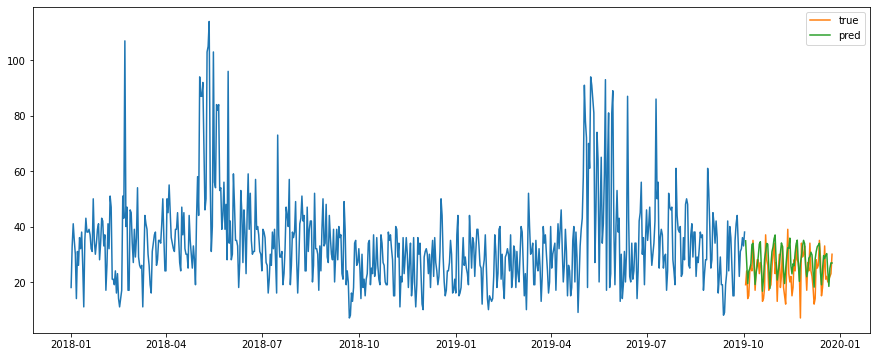

Test MSE: 47.100
Test RMSE: 6.863
Test MAPE: 29.490
성별:  여성  , 연령:  40대


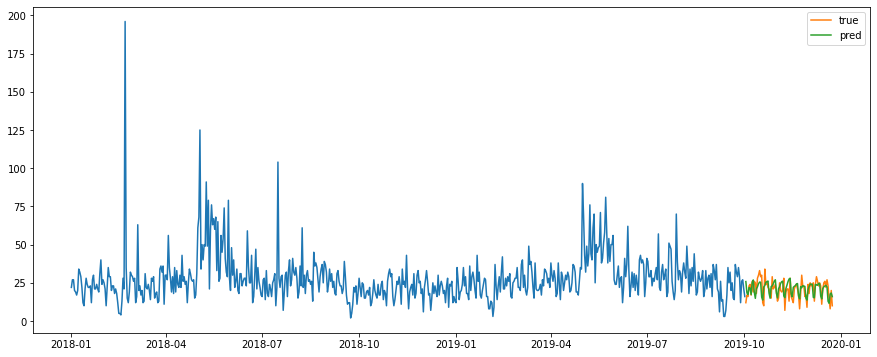

Test MSE: 31.724
Test RMSE: 5.632
Test MAPE: 25.299
성별:  여성  , 연령:  50대


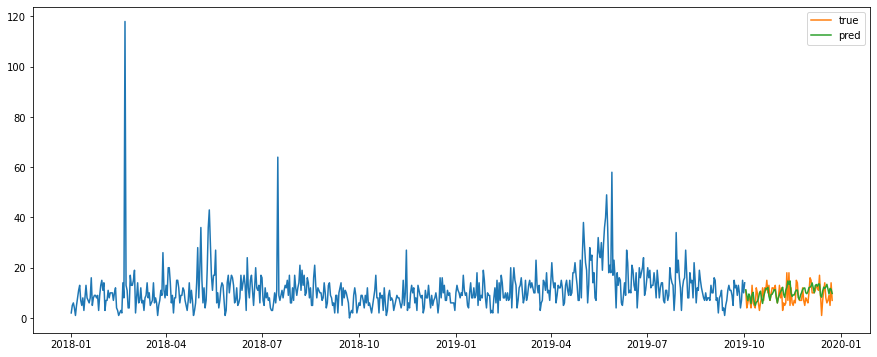

Test MSE: 13.601
Test RMSE: 3.688
Test MAPE: 49.837
성별:  여성  , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


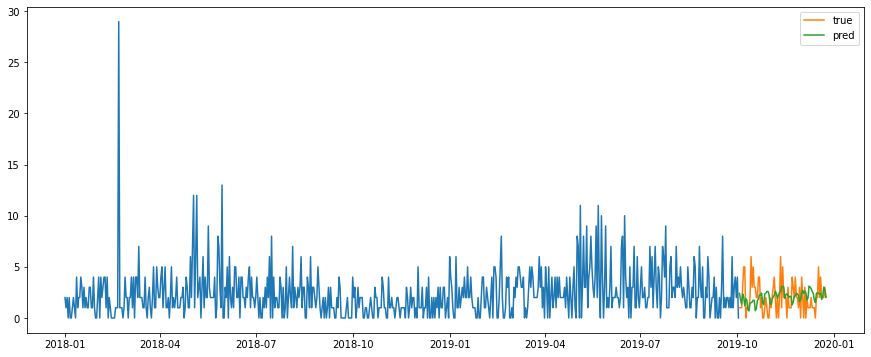

Test MSE: 2.543
Test RMSE: 1.595
Test MAPE: inf
소분류:  린스
성별:  남성 , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


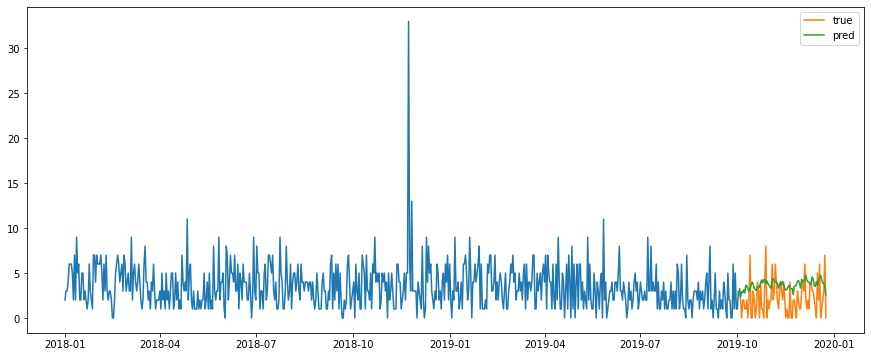

Test MSE: 5.498
Test RMSE: 2.345
Test MAPE: inf
성별:  남성 , 연령:  30대


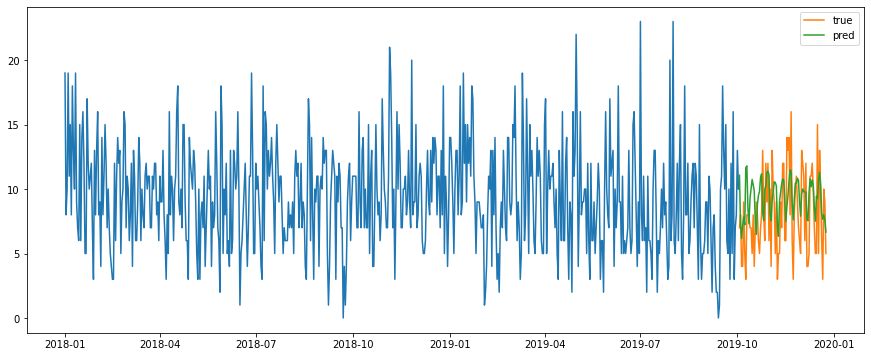

Test MSE: 10.329
Test RMSE: 3.214
Test MAPE: 45.588
성별:  남성 , 연령:  40대


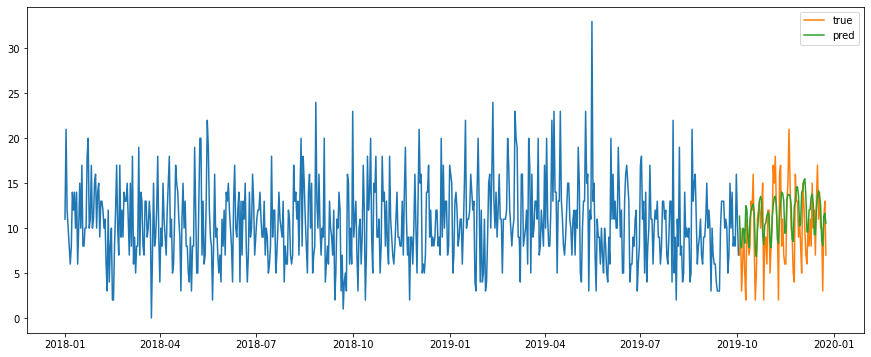

Test MSE: 13.557
Test RMSE: 3.682
Test MAPE: 50.713
성별:  남성 , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


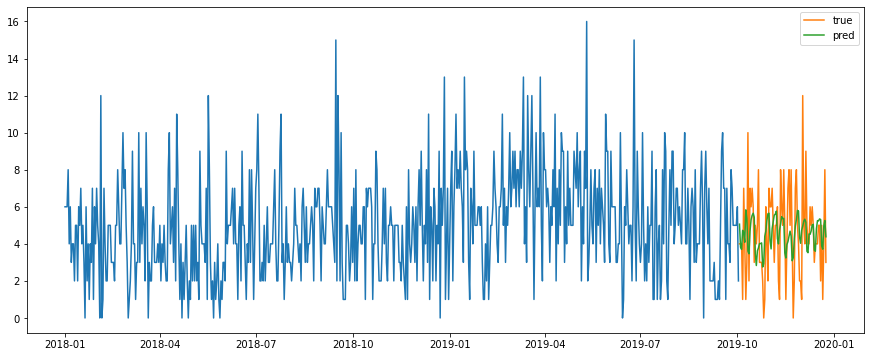

Test MSE: 5.195
Test RMSE: 2.279
Test MAPE: inf
성별:  남성 , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


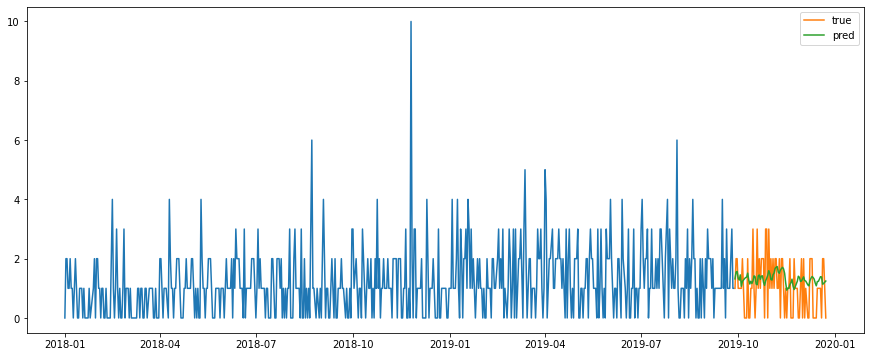

Test MSE: 0.832
Test RMSE: 0.912
Test MAPE: inf
성별:  여성  , 연령:  20대


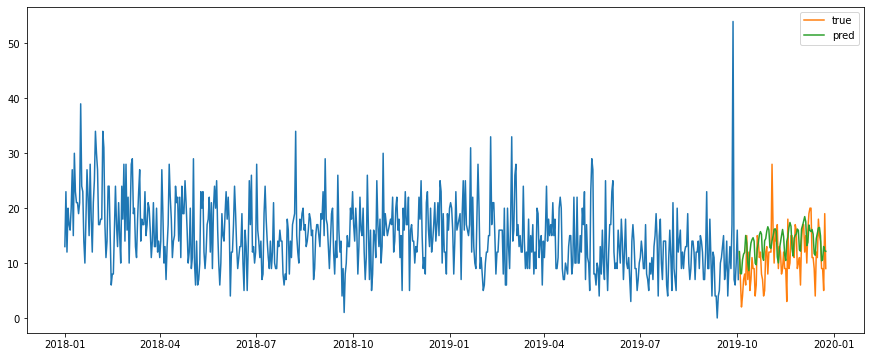

Test MSE: 23.163
Test RMSE: 4.813
Test MAPE: 52.362
성별:  여성  , 연령:  30대


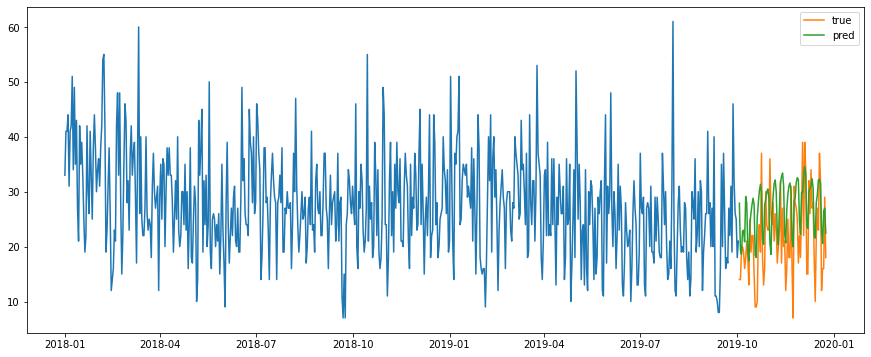

Test MSE: 58.349
Test RMSE: 7.639
Test MAPE: 37.419
성별:  여성  , 연령:  40대


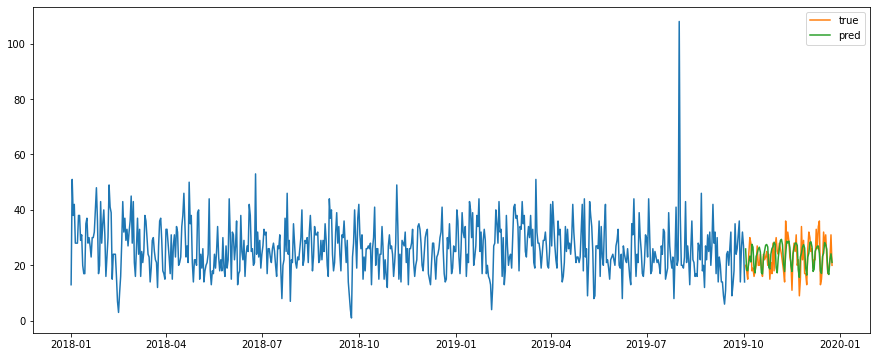

Test MSE: 25.814
Test RMSE: 5.081
Test MAPE: 19.111
성별:  여성  , 연령:  50대


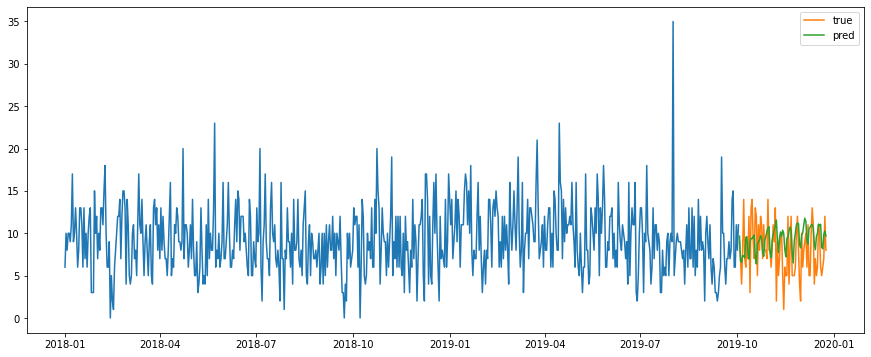

Test MSE: 11.690
Test RMSE: 3.419
Test MAPE: 57.722
성별:  여성  , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


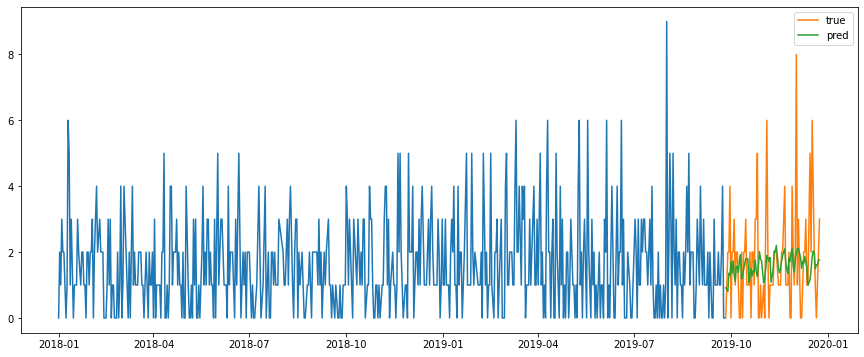

Test MSE: 2.253
Test RMSE: 1.501
Test MAPE: inf
소분류:  메이크업 박스
성별:  남성 , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


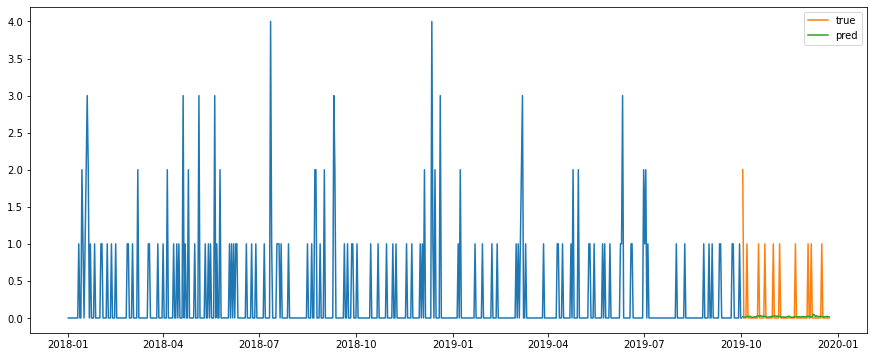

Test MSE: 0.151
Test RMSE: 0.389
Test MAPE: inf
성별:  남성 , 연령:  30대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


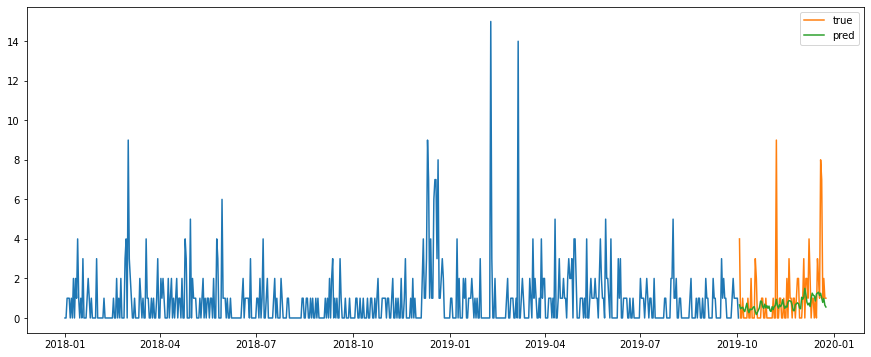

Test MSE: 2.711
Test RMSE: 1.646
Test MAPE: inf
성별:  남성 , 연령:  40대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


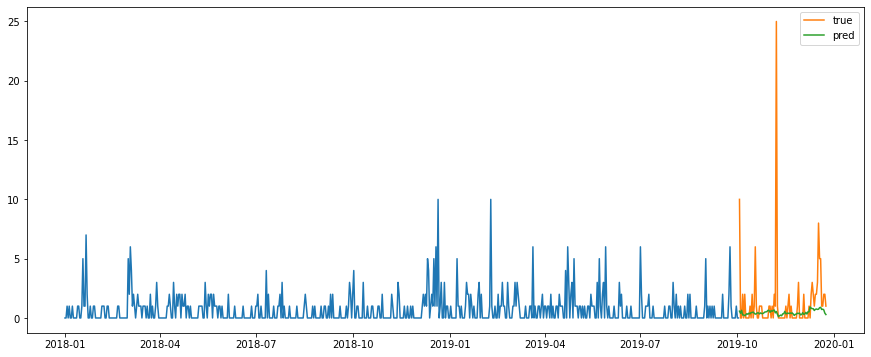

Test MSE: 10.397
Test RMSE: 3.225
Test MAPE: inf
성별:  남성 , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


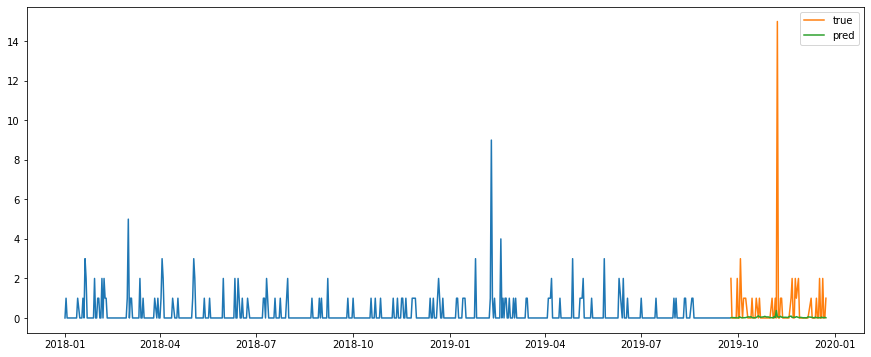

Test MSE: 3.313
Test RMSE: 1.820
Test MAPE: inf
성별:  남성 , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


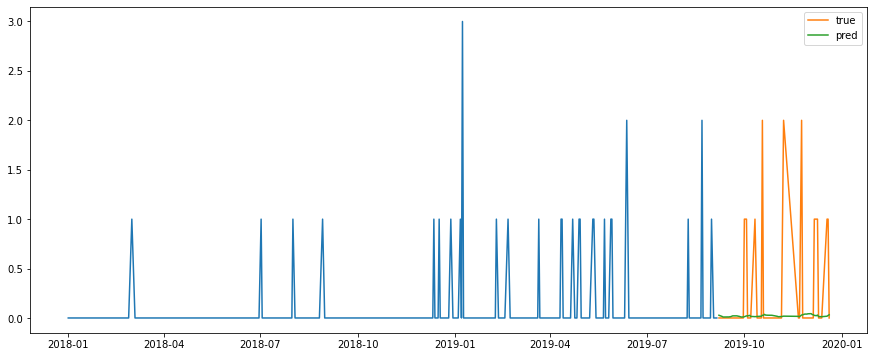

Test MSE: 0.388
Test RMSE: 0.623
Test MAPE: inf
성별:  여성  , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


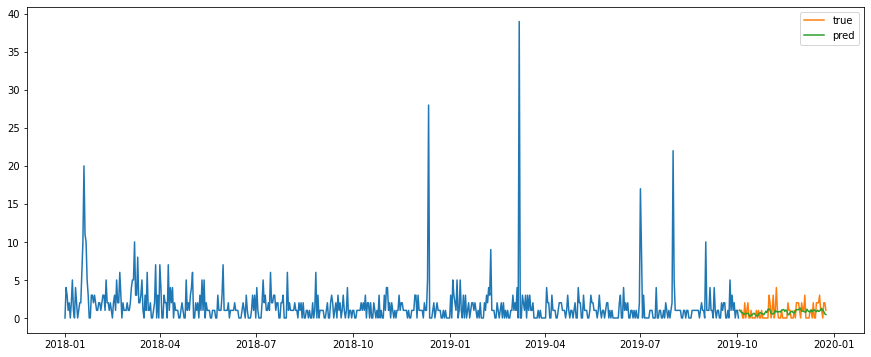

Test MSE: 0.926
Test RMSE: 0.962
Test MAPE: inf
성별:  여성  , 연령:  30대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


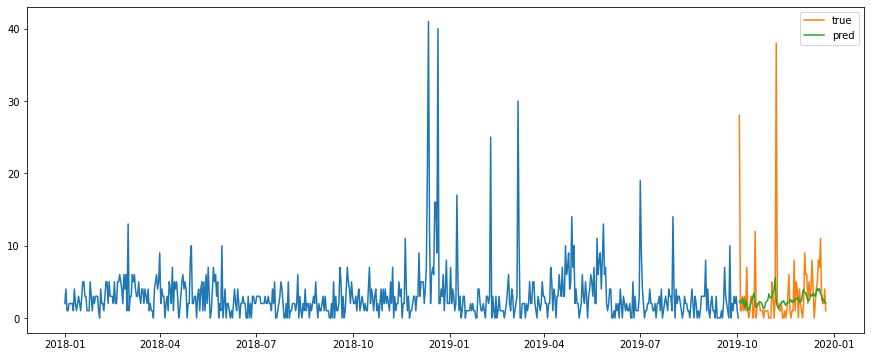

Test MSE: 29.676
Test RMSE: 5.448
Test MAPE: inf
성별:  여성  , 연령:  40대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


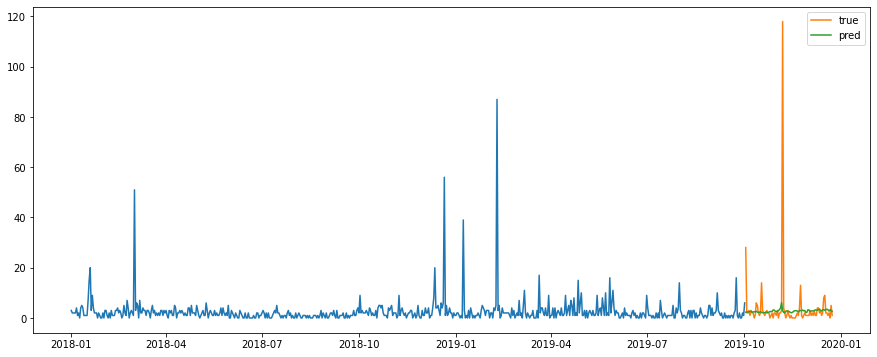

Test MSE: 173.890
Test RMSE: 13.187
Test MAPE: inf
성별:  여성  , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


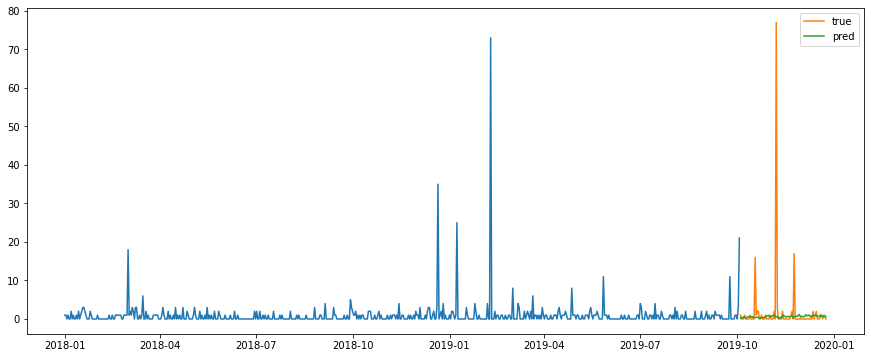

Test MSE: 78.067
Test RMSE: 8.836
Test MAPE: inf
성별:  여성  , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


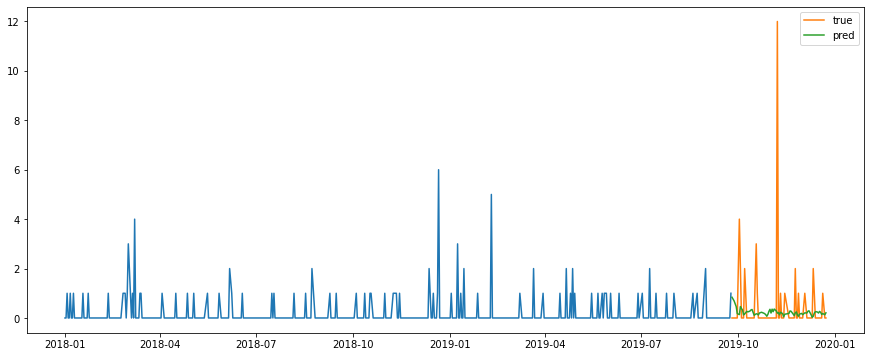

Test MSE: 2.557
Test RMSE: 1.599
Test MAPE: inf
소분류:  무/배추
성별:  남성 , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


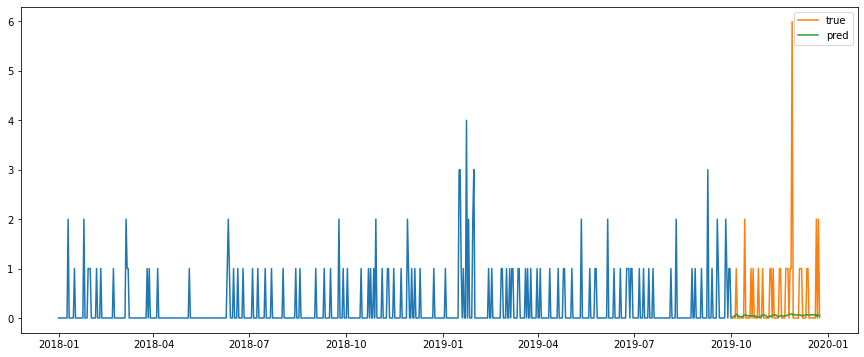

Test MSE: 0.777
Test RMSE: 0.881
Test MAPE: inf
성별:  남성 , 연령:  30대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


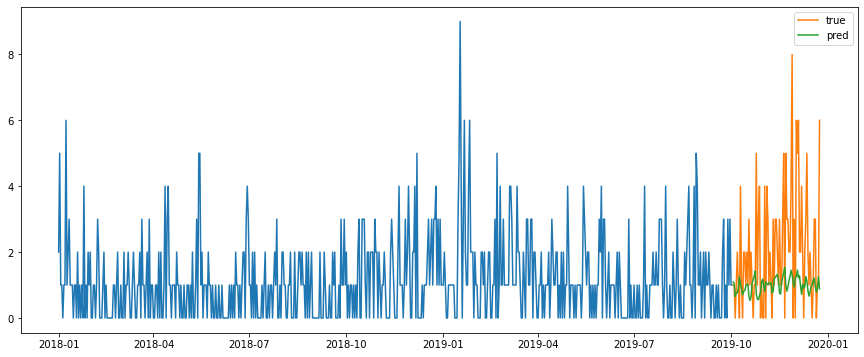

Test MSE: 4.083
Test RMSE: 2.021
Test MAPE: inf
성별:  남성 , 연령:  40대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


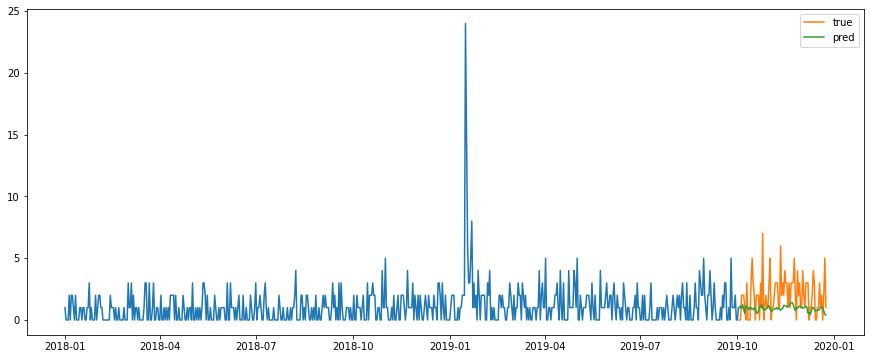

Test MSE: 3.479
Test RMSE: 1.865
Test MAPE: inf
성별:  남성 , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


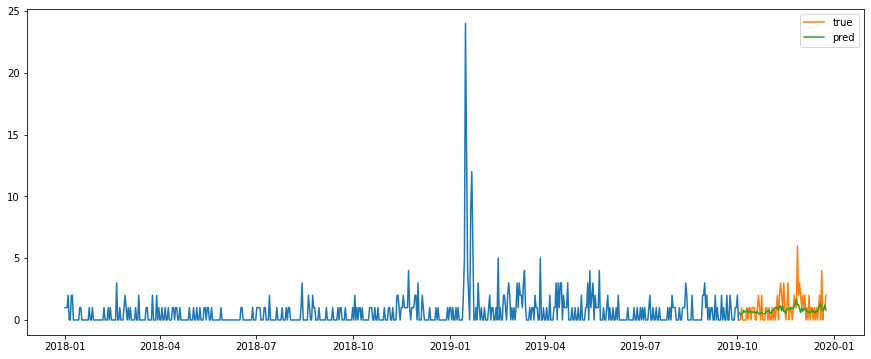

Test MSE: 1.053
Test RMSE: 1.026
Test MAPE: inf
성별:  남성 , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


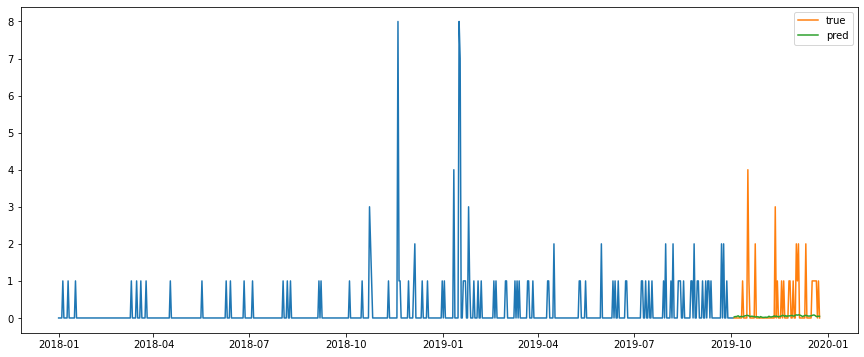

Test MSE: 0.642
Test RMSE: 0.801
Test MAPE: inf
성별:  여성  , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


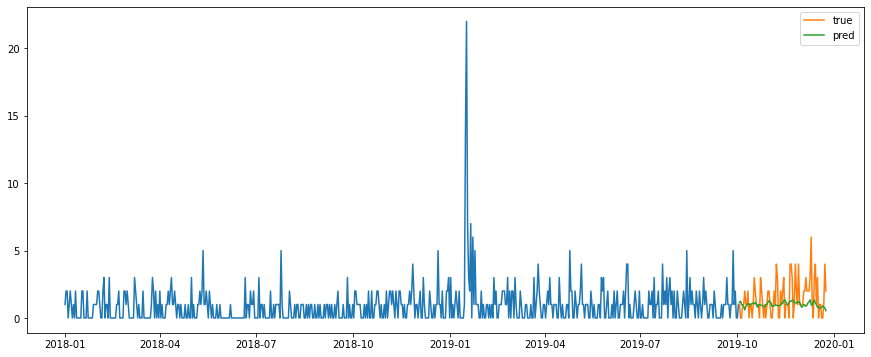

Test MSE: 1.859
Test RMSE: 1.363
Test MAPE: inf
성별:  여성  , 연령:  30대


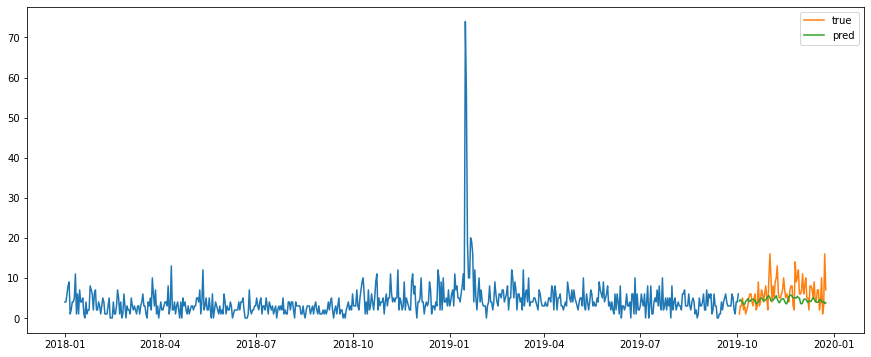

Test MSE: 12.742
Test RMSE: 3.570
Test MAPE: 51.927
성별:  여성  , 연령:  40대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


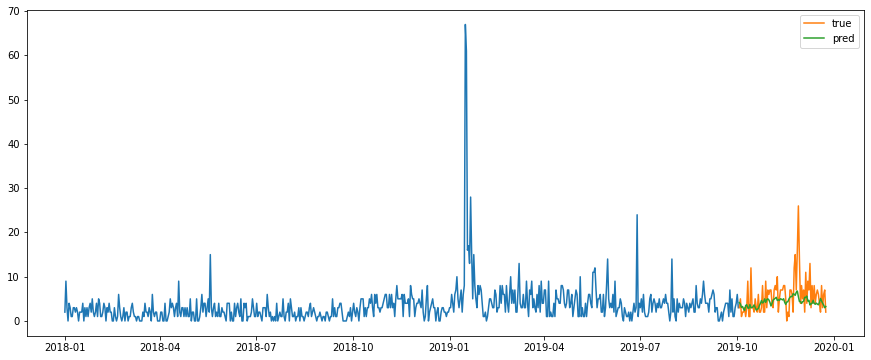

Test MSE: 16.978
Test RMSE: 4.120
Test MAPE: inf
성별:  여성  , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


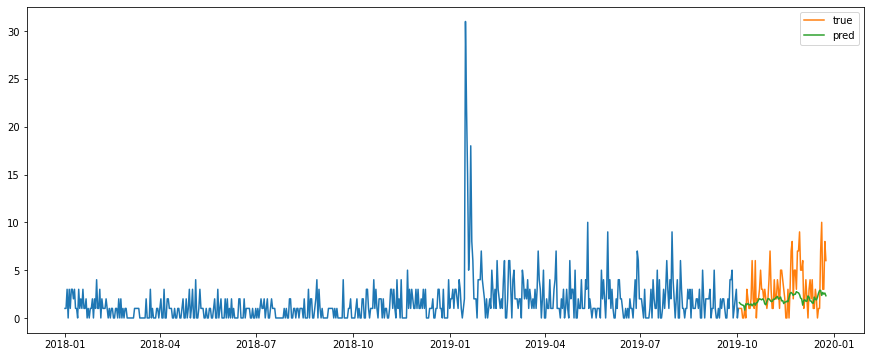

Test MSE: 5.894
Test RMSE: 2.428
Test MAPE: inf
성별:  여성  , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


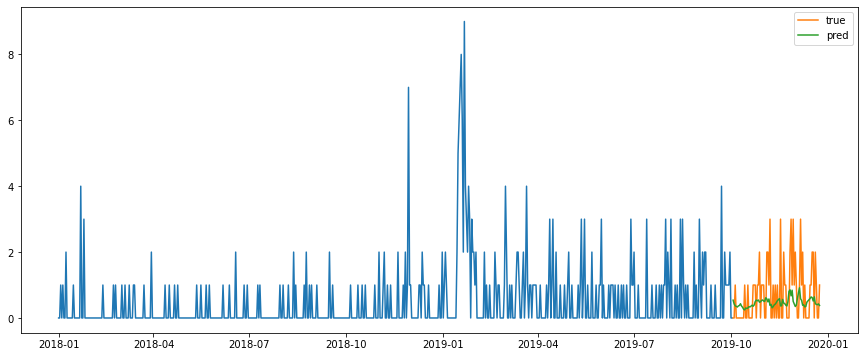

Test MSE: 0.846
Test RMSE: 0.920
Test MAPE: inf
소분류:  바나나/파인애플/망고
성별:  남성 , 연령:  20대


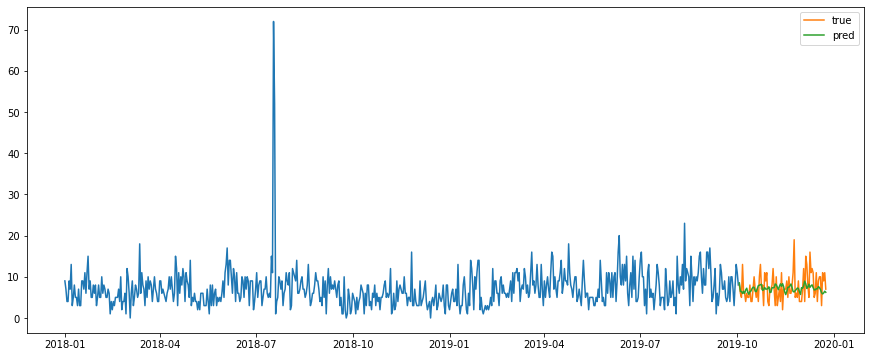

Test MSE: 11.629
Test RMSE: 3.410
Test MAPE: 43.200
성별:  남성 , 연령:  30대


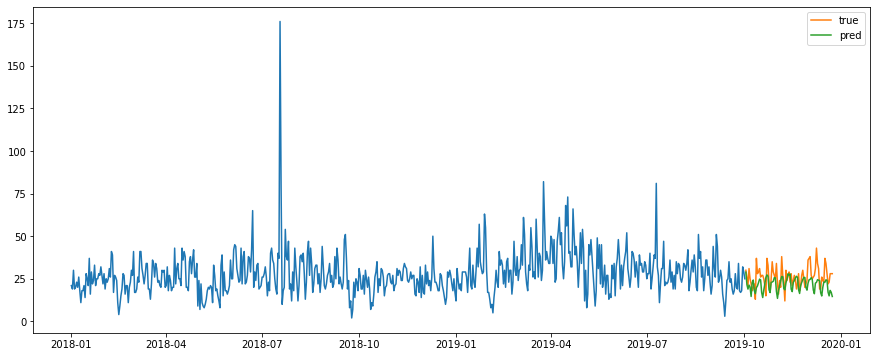

Test MSE: 57.276
Test RMSE: 7.568
Test MAPE: 22.569
성별:  남성 , 연령:  40대


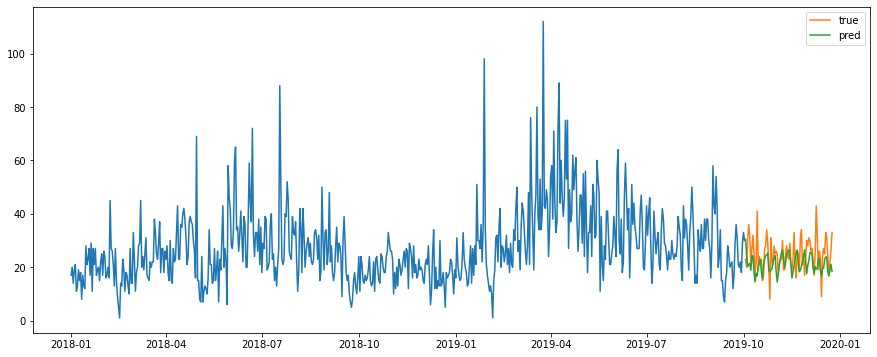

Test MSE: 52.574
Test RMSE: 7.251
Test MAPE: 21.594
성별:  남성 , 연령:  50대


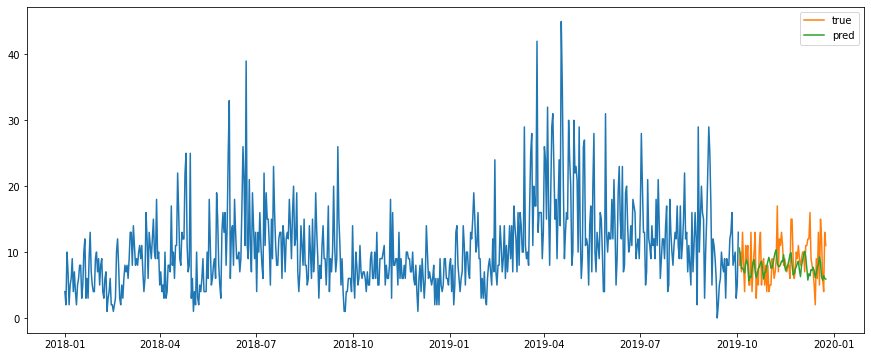

Test MSE: 11.887
Test RMSE: 3.448
Test MAPE: 34.470
성별:  남성 , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


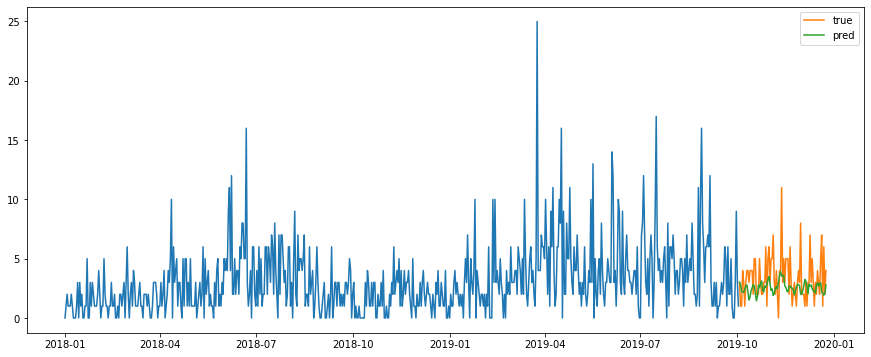

Test MSE: 4.197
Test RMSE: 2.049
Test MAPE: inf
성별:  여성  , 연령:  20대


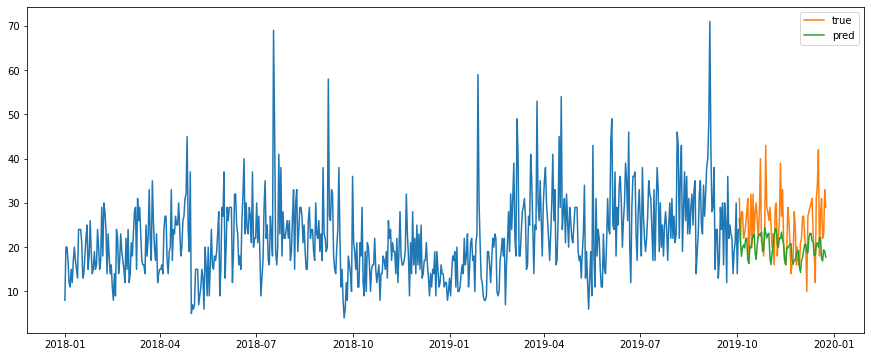

Test MSE: 59.018
Test RMSE: 7.682
Test MAPE: 22.186
성별:  여성  , 연령:  30대


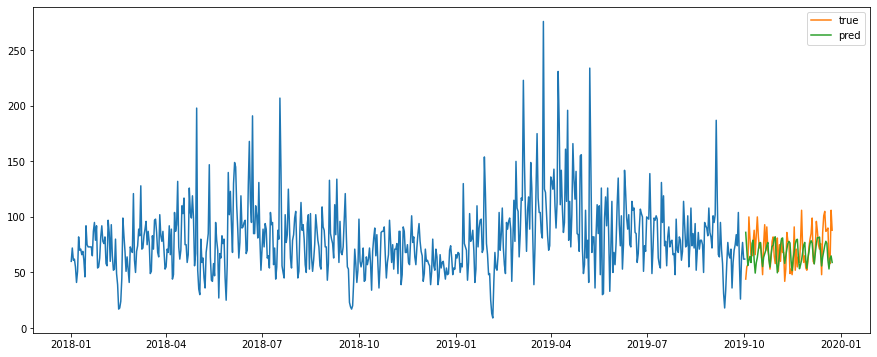

Test MSE: 294.930
Test RMSE: 17.174
Test MAPE: 17.834
성별:  여성  , 연령:  40대


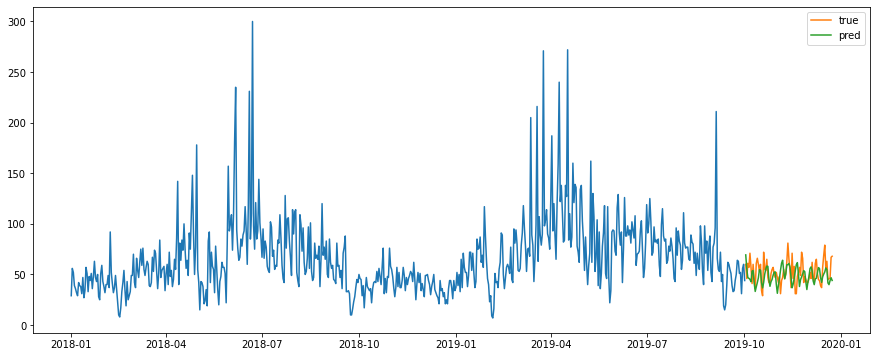

Test MSE: 171.141
Test RMSE: 13.082
Test MAPE: 19.685
성별:  여성  , 연령:  50대


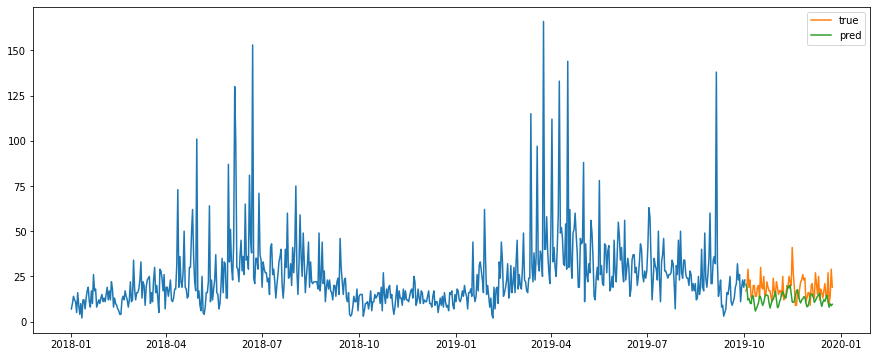

Test MSE: 73.507
Test RMSE: 8.574
Test MAPE: 33.910
성별:  여성  , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


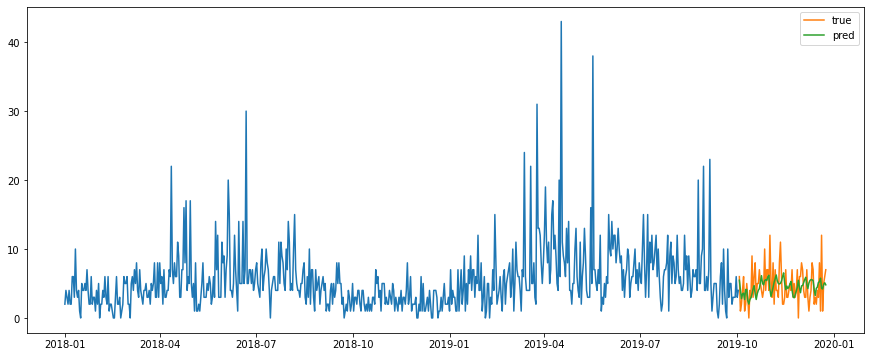

Test MSE: 7.088
Test RMSE: 2.662
Test MAPE: inf
소분류:  바디 세트
성별:  남성 , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


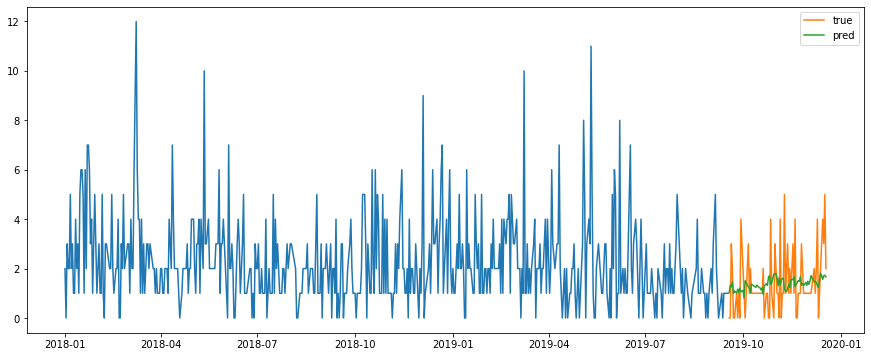

Test MSE: 1.672
Test RMSE: 1.293
Test MAPE: inf
성별:  남성 , 연령:  30대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


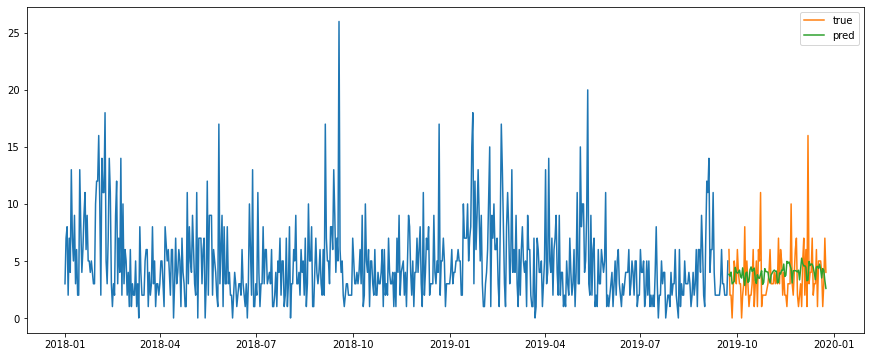

Test MSE: 6.773
Test RMSE: 2.602
Test MAPE: inf
성별:  남성 , 연령:  40대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


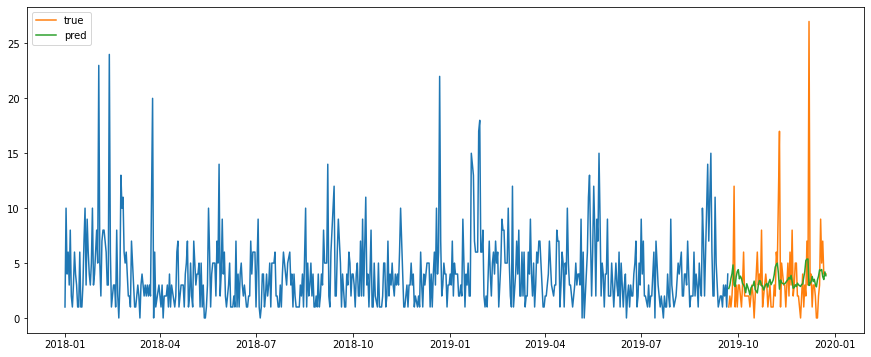

Test MSE: 14.139
Test RMSE: 3.760
Test MAPE: inf
성별:  남성 , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


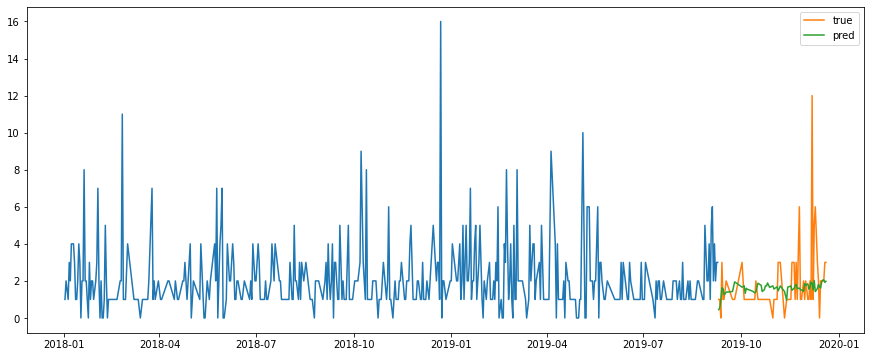

Test MSE: 3.108
Test RMSE: 1.763
Test MAPE: inf
성별:  남성 , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


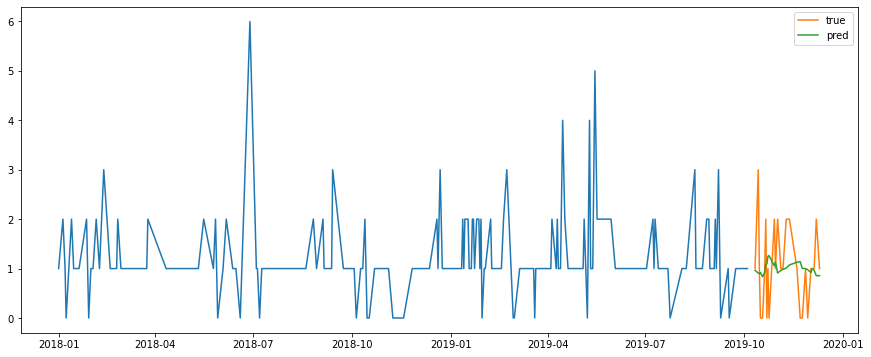

Test MSE: 0.674
Test RMSE: 0.821
Test MAPE: inf
성별:  여성  , 연령:  20대


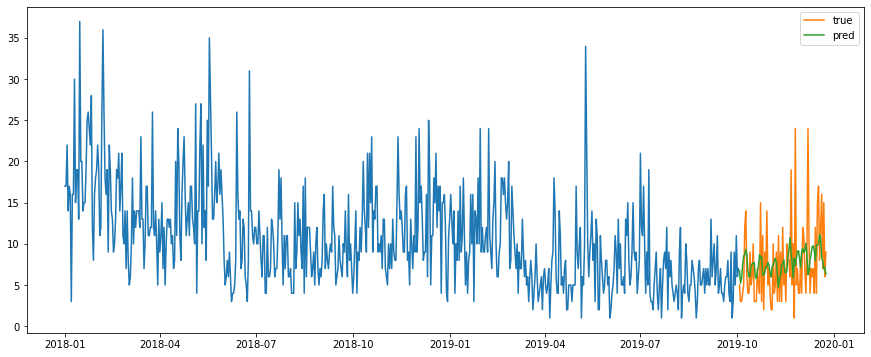

Test MSE: 22.403
Test RMSE: 4.733
Test MAPE: 71.500
성별:  여성  , 연령:  30대


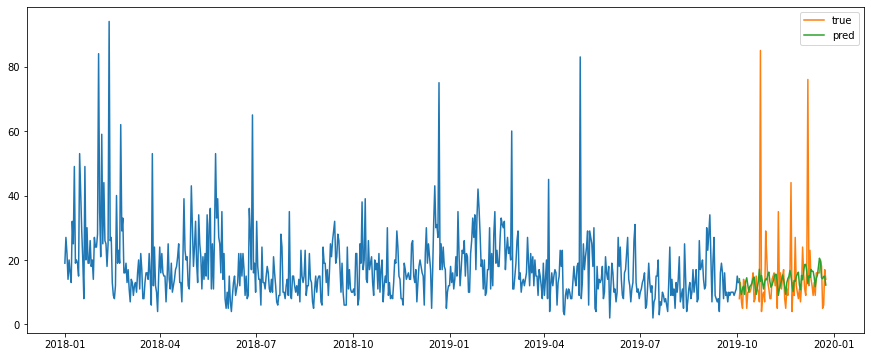

Test MSE: 154.794
Test RMSE: 12.442
Test MAPE: 47.529
성별:  여성  , 연령:  40대


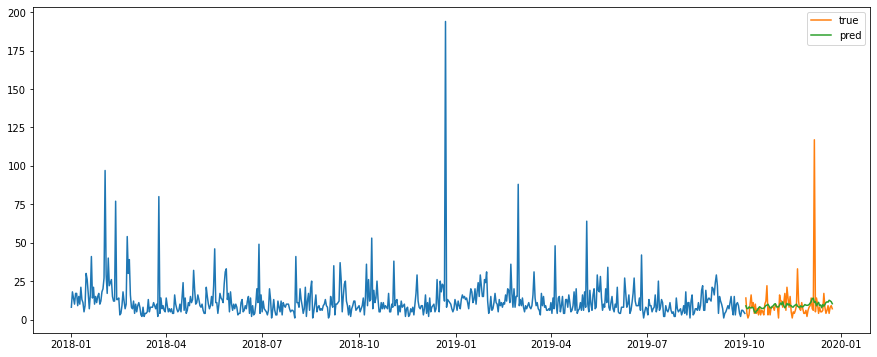

Test MSE: 163.710
Test RMSE: 12.795
Test MAPE: 84.436
성별:  여성  , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


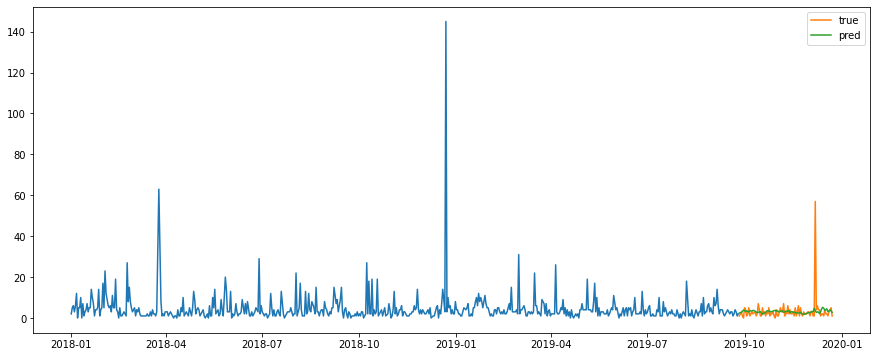

Test MSE: 36.658
Test RMSE: 6.055
Test MAPE: inf
성별:  여성  , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


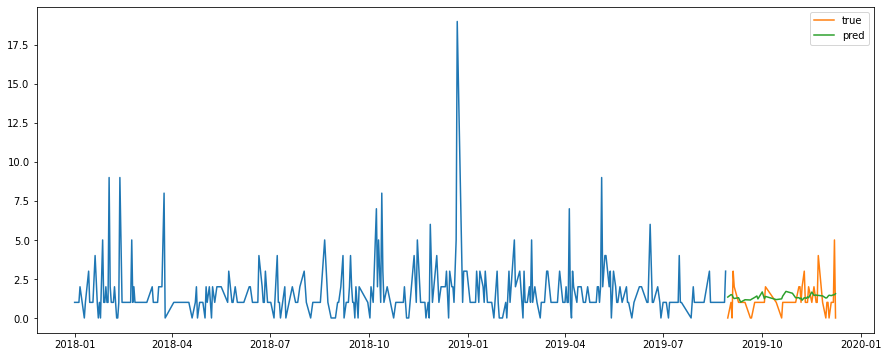

Test MSE: 1.042
Test RMSE: 1.021
Test MAPE: inf
소분류:  반건조고구마
성별:  남성 , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


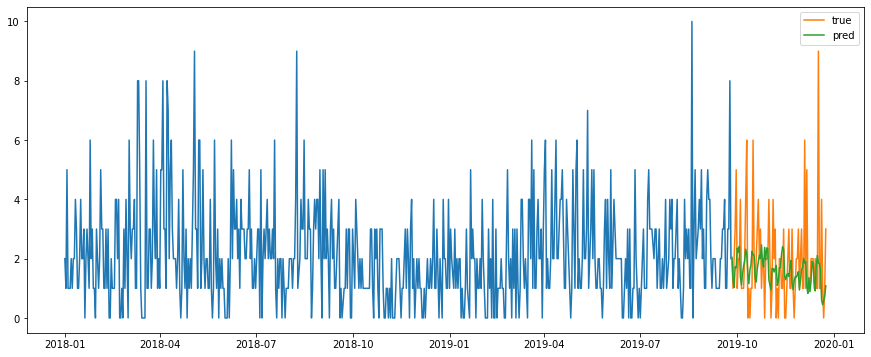

Test MSE: 2.602
Test RMSE: 1.613
Test MAPE: inf
성별:  남성 , 연령:  30대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


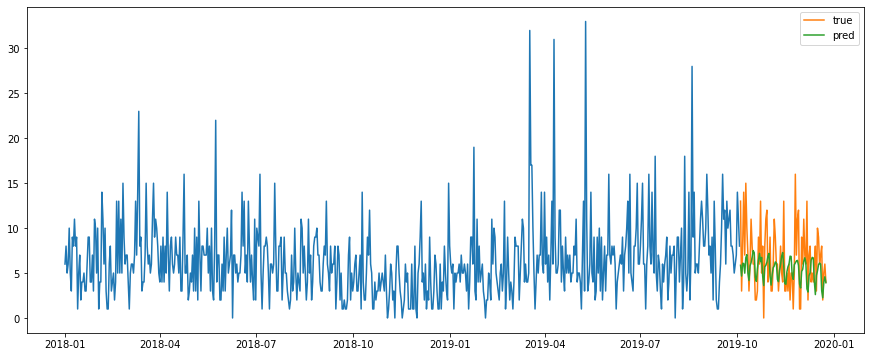

Test MSE: 12.458
Test RMSE: 3.530
Test MAPE: inf
성별:  남성 , 연령:  40대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


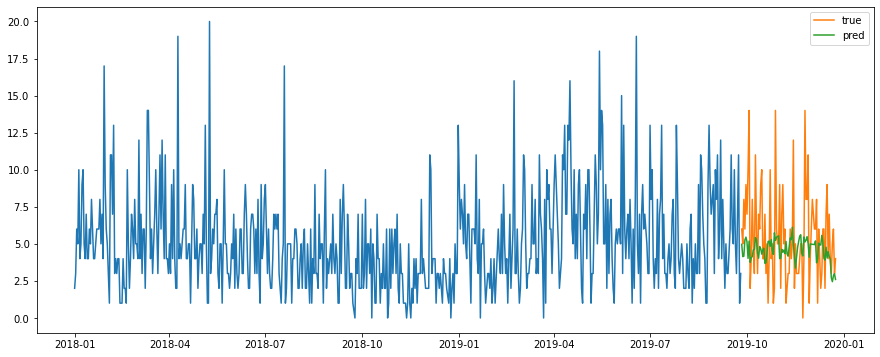

Test MSE: 9.709
Test RMSE: 3.116
Test MAPE: inf
성별:  남성 , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


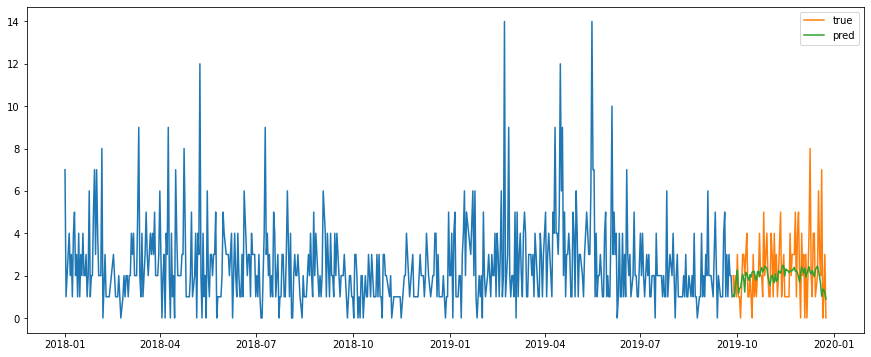

Test MSE: 2.654
Test RMSE: 1.629
Test MAPE: inf
성별:  남성 , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


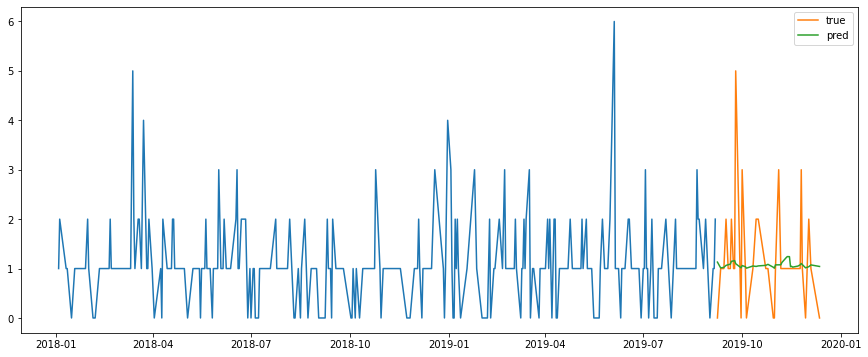

Test MSE: 0.986
Test RMSE: 0.993
Test MAPE: inf
성별:  여성  , 연령:  20대


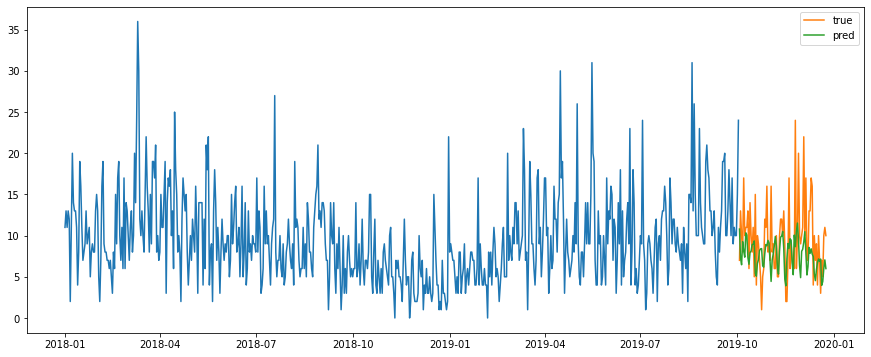

Test MSE: 22.156
Test RMSE: 4.707
Test MAPE: 46.306
성별:  여성  , 연령:  30대


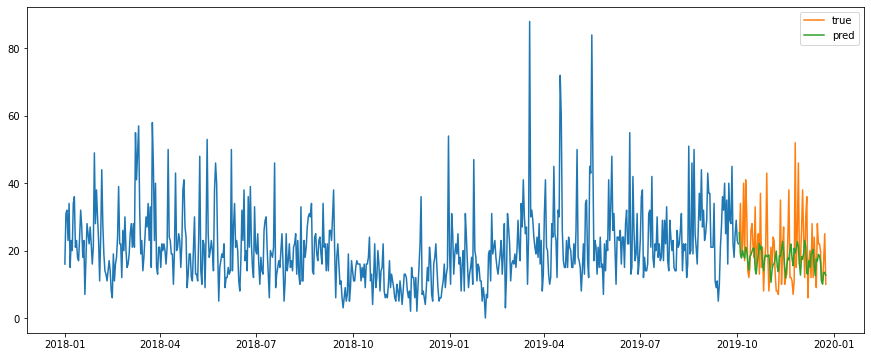

Test MSE: 102.231
Test RMSE: 10.111
Test MAPE: 40.074
성별:  여성  , 연령:  40대


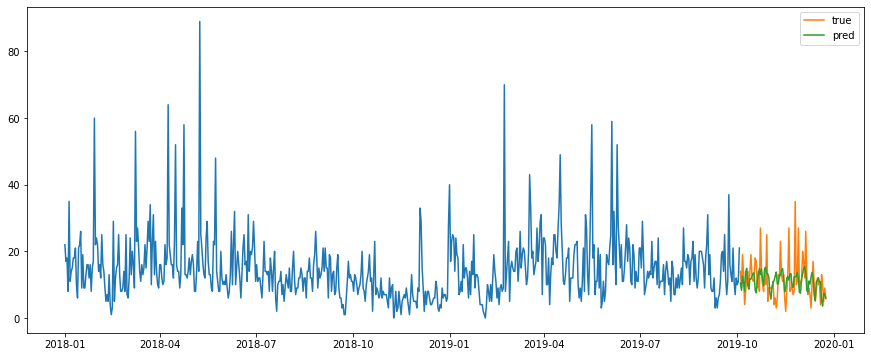

Test MSE: 36.036
Test RMSE: 6.003
Test MAPE: 47.931
성별:  여성  , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


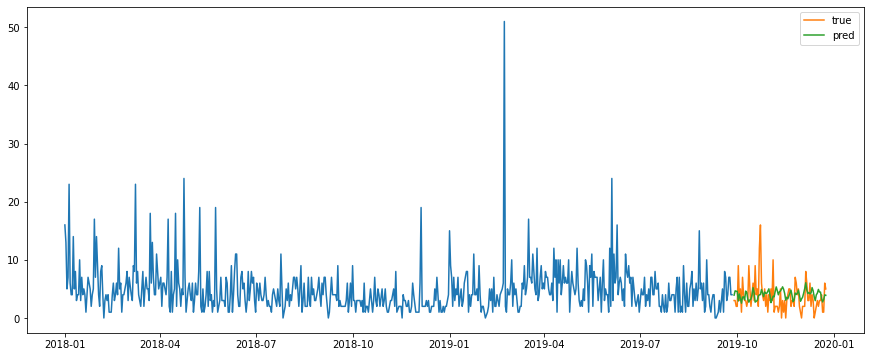

Test MSE: 7.766
Test RMSE: 2.787
Test MAPE: inf
성별:  여성  , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


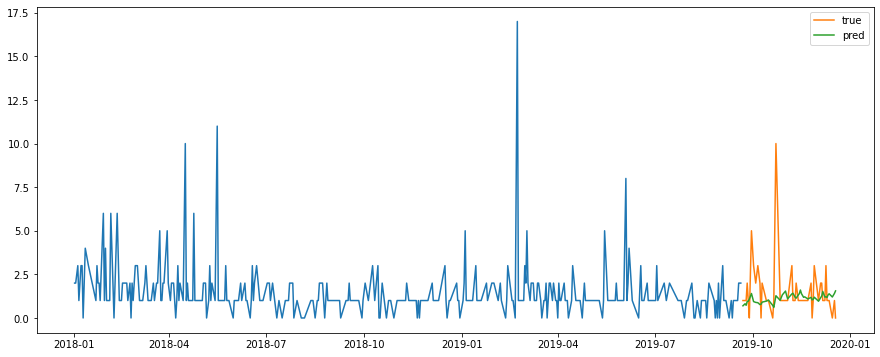

Test MSE: 2.490
Test RMSE: 1.578
Test MAPE: inf
소분류:  배/포도/과일즙
성별:  남성 , 연령:  20대


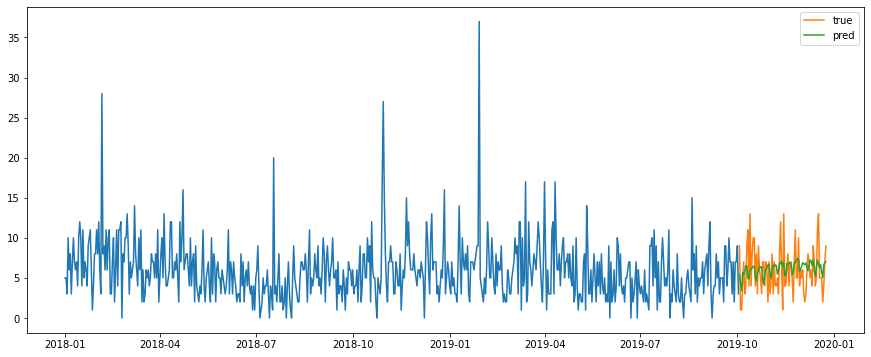

Test MSE: 7.485
Test RMSE: 2.736
Test MAPE: 56.949
성별:  남성 , 연령:  30대


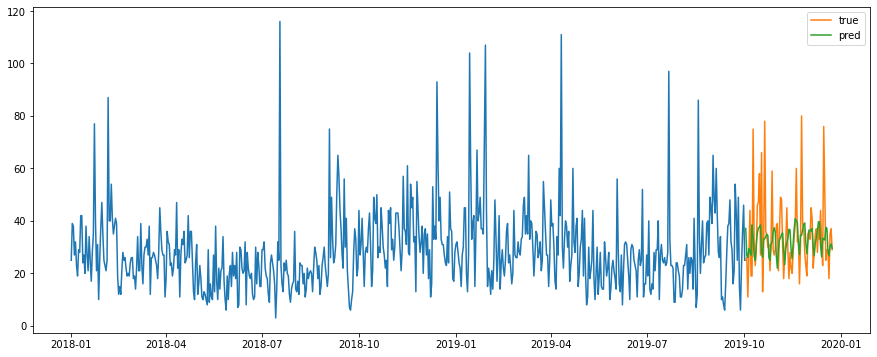

Test MSE: 193.865
Test RMSE: 13.924
Test MAPE: 28.735
성별:  남성 , 연령:  40대


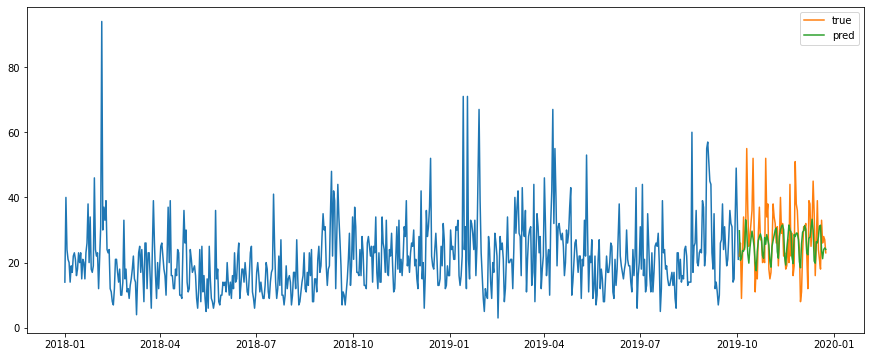

Test MSE: 79.919
Test RMSE: 8.940
Test MAPE: 27.202
성별:  남성 , 연령:  50대


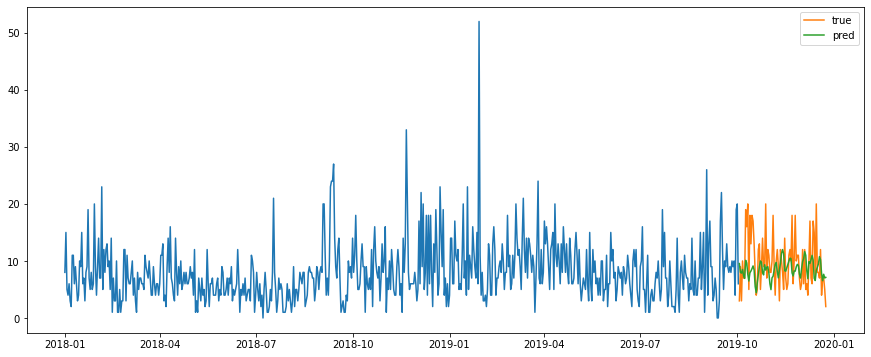

Test MSE: 23.377
Test RMSE: 4.835
Test MAPE: 44.109
성별:  남성 , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


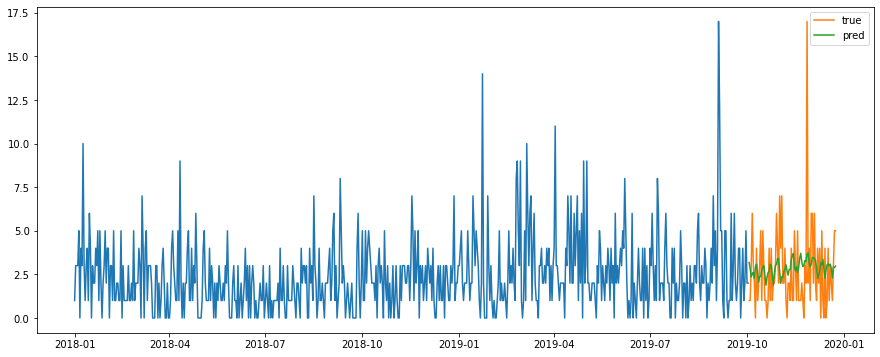

Test MSE: 5.765
Test RMSE: 2.401
Test MAPE: inf
성별:  여성  , 연령:  20대


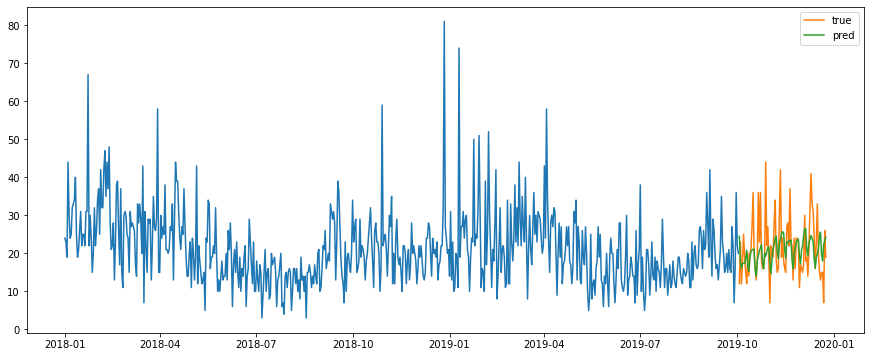

Test MSE: 55.196
Test RMSE: 7.429
Test MAPE: 28.400
성별:  여성  , 연령:  30대


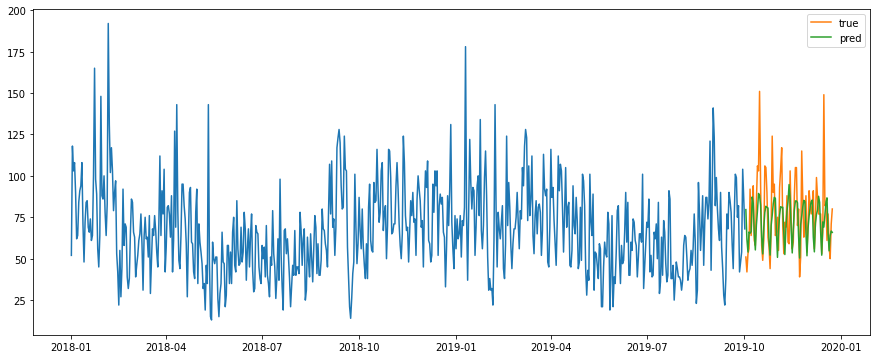

Test MSE: 387.838
Test RMSE: 19.694
Test MAPE: 17.734
성별:  여성  , 연령:  40대


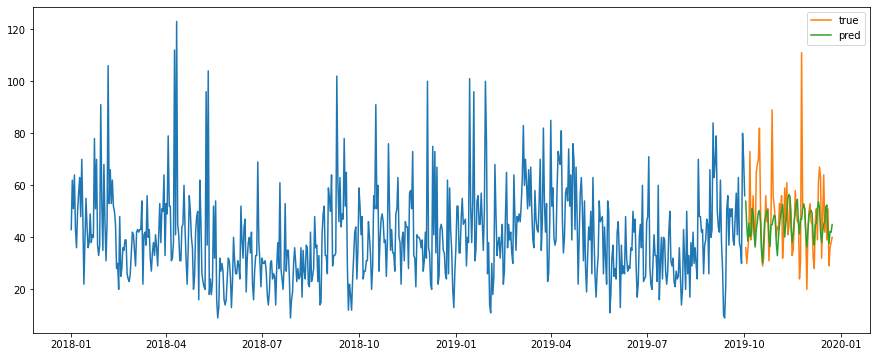

Test MSE: 182.757
Test RMSE: 13.519
Test MAPE: 18.636
성별:  여성  , 연령:  50대


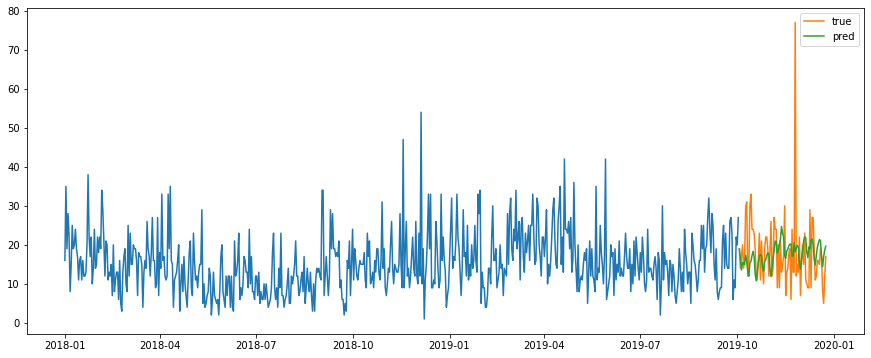

Test MSE: 89.690
Test RMSE: 9.470
Test MAPE: 41.951
성별:  여성  , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


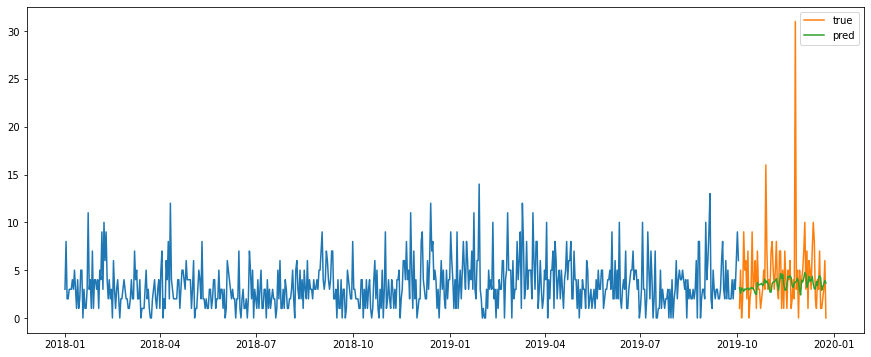

Test MSE: 17.135
Test RMSE: 4.139
Test MAPE: inf
소분류:  백김치
성별:  남성 , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


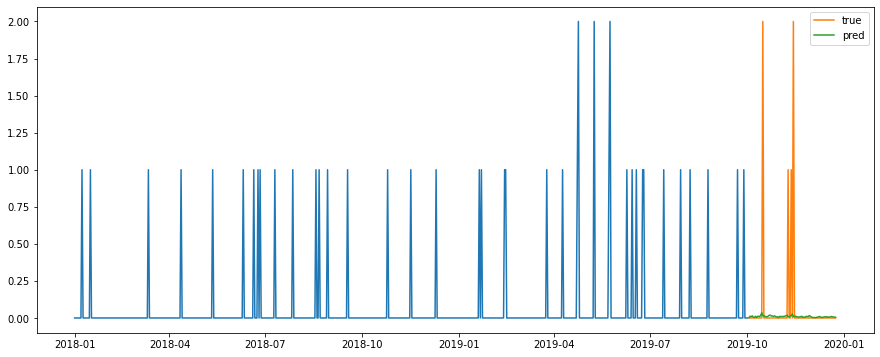

Test MSE: 0.119
Test RMSE: 0.345
Test MAPE: inf
성별:  남성 , 연령:  30대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


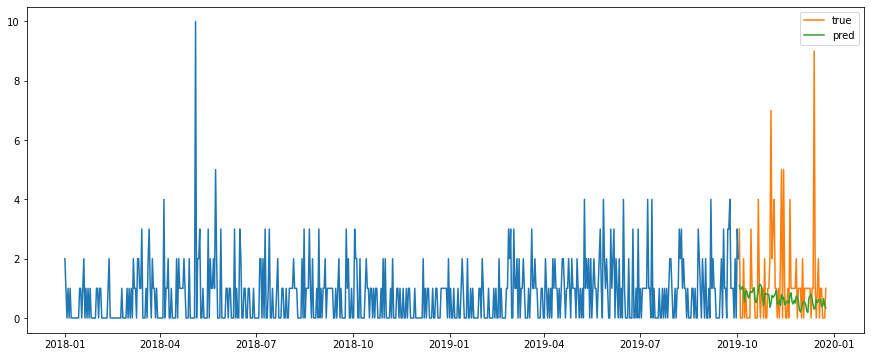

Test MSE: 2.837
Test RMSE: 1.684
Test MAPE: inf
성별:  남성 , 연령:  40대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


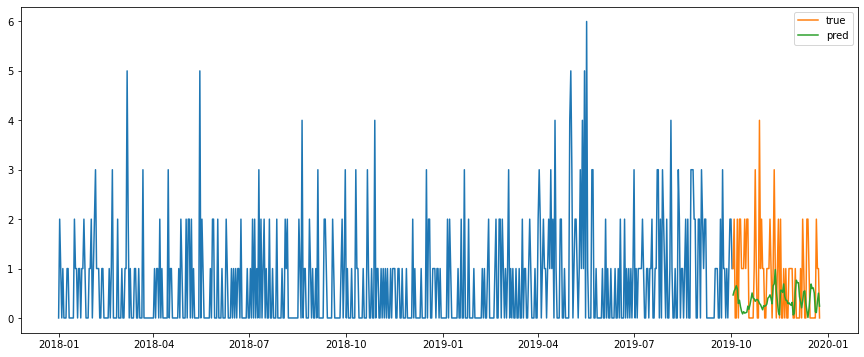

Test MSE: 1.100
Test RMSE: 1.049
Test MAPE: inf
성별:  남성 , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


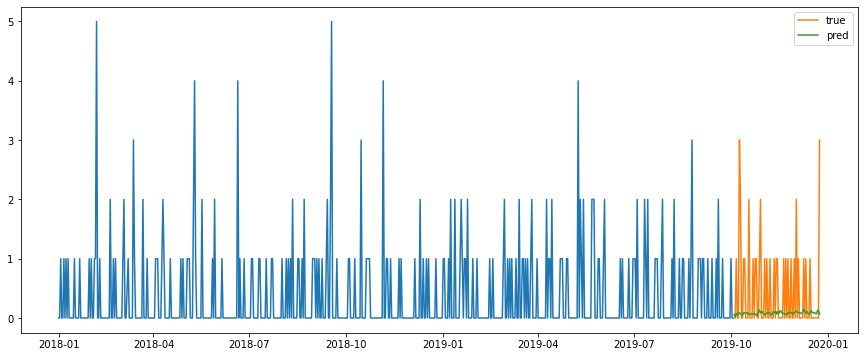

Test MSE: 0.618
Test RMSE: 0.786
Test MAPE: inf
성별:  남성 , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


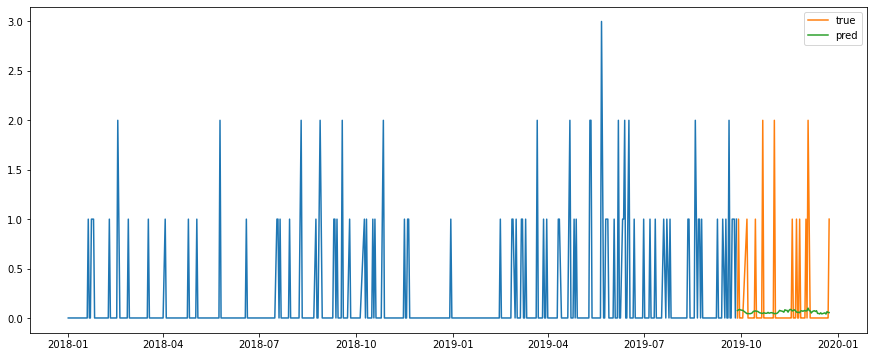

Test MSE: 0.237
Test RMSE: 0.487
Test MAPE: inf
성별:  여성  , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


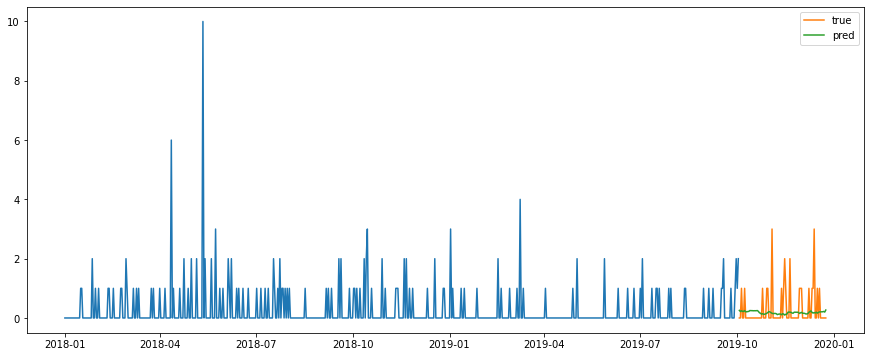

Test MSE: 0.436
Test RMSE: 0.660
Test MAPE: inf
성별:  여성  , 연령:  30대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


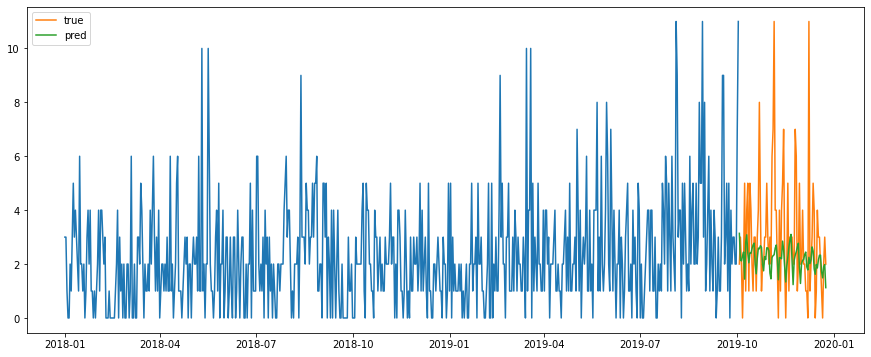

Test MSE: 4.999
Test RMSE: 2.236
Test MAPE: inf
성별:  여성  , 연령:  40대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


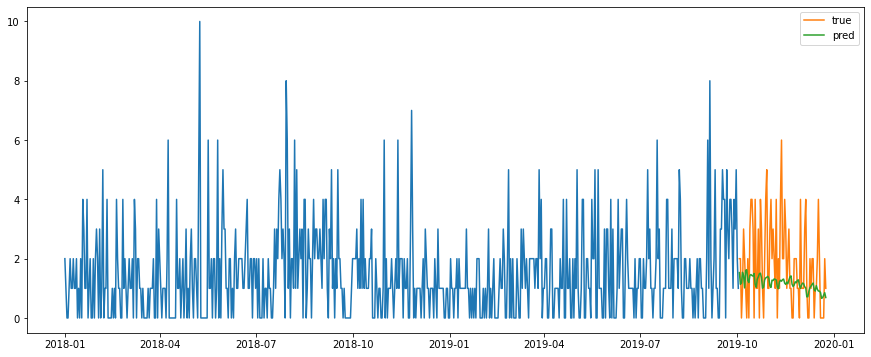

Test MSE: 2.362
Test RMSE: 1.537
Test MAPE: inf
성별:  여성  , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


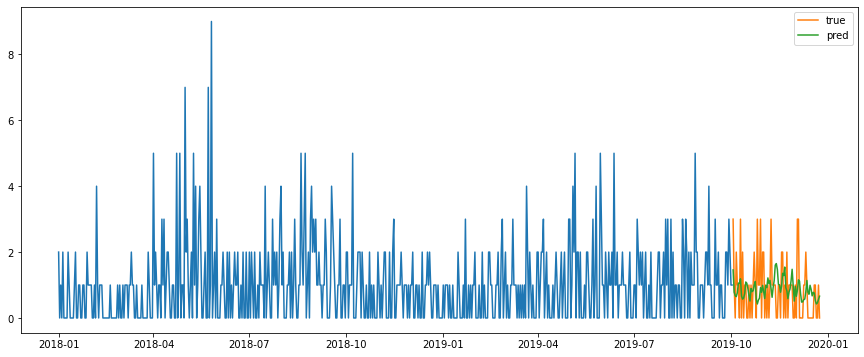

Test MSE: 0.830
Test RMSE: 0.911
Test MAPE: inf
성별:  여성  , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


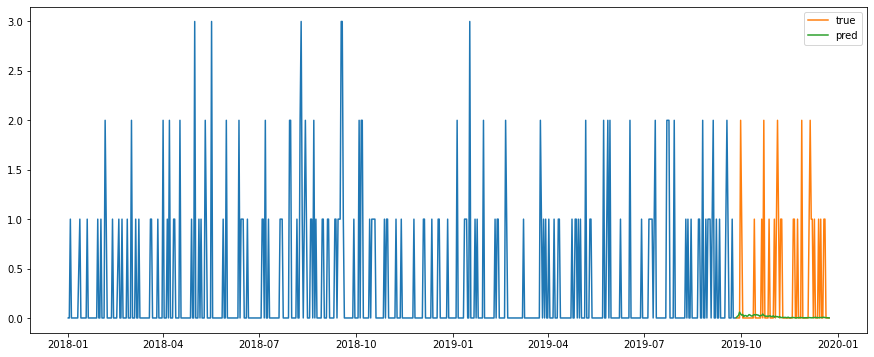

Test MSE: 0.442
Test RMSE: 0.665
Test MAPE: inf
소분류:  베이스 메이크업용 BB크림
성별:  남성 , 연령:  20대


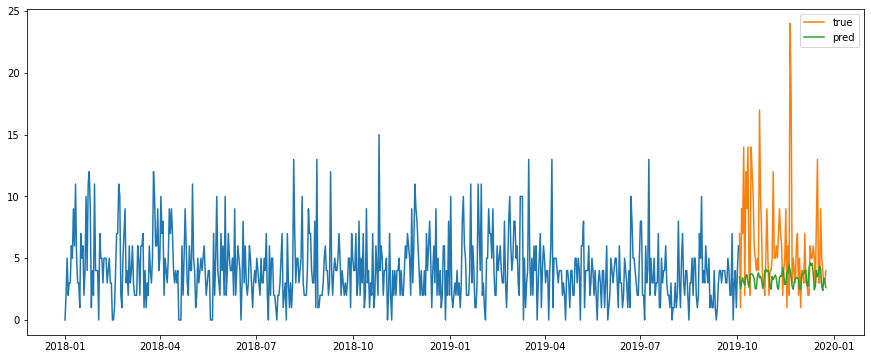

Test MSE: 23.712
Test RMSE: 4.870
Test MAPE: 51.322
성별:  남성 , 연령:  30대


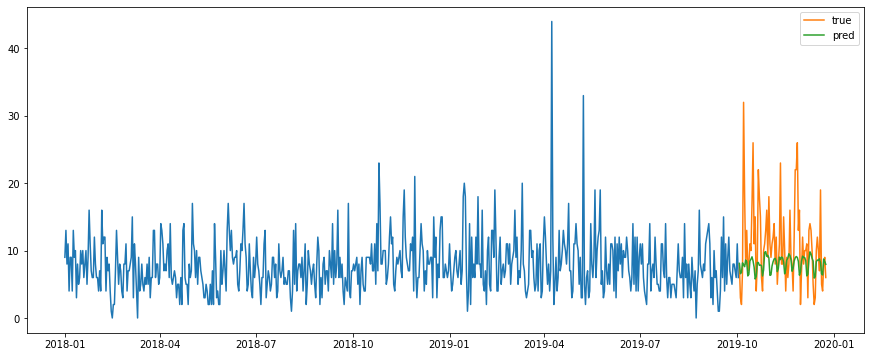

Test MSE: 39.050
Test RMSE: 6.249
Test MAPE: 43.061
성별:  남성 , 연령:  40대


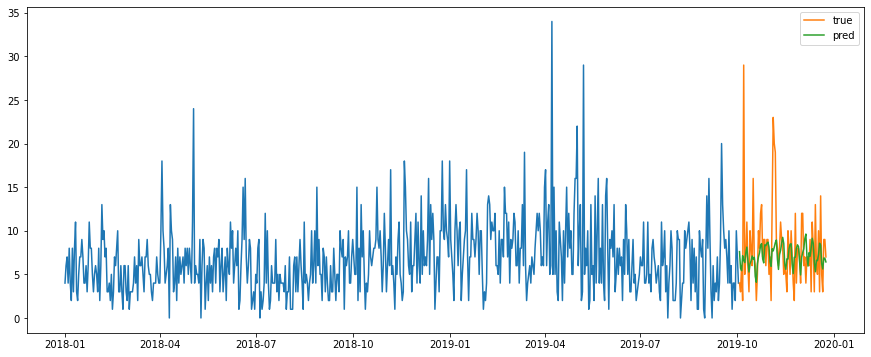

Test MSE: 20.294
Test RMSE: 4.505
Test MAPE: 44.276
성별:  남성 , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


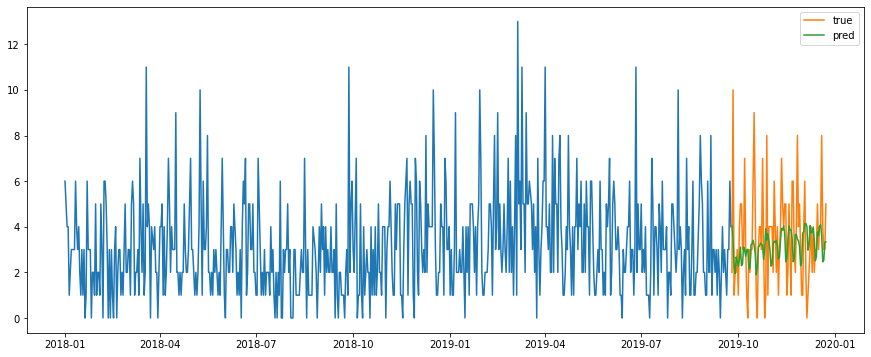

Test MSE: 4.238
Test RMSE: 2.059
Test MAPE: inf
성별:  남성 , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


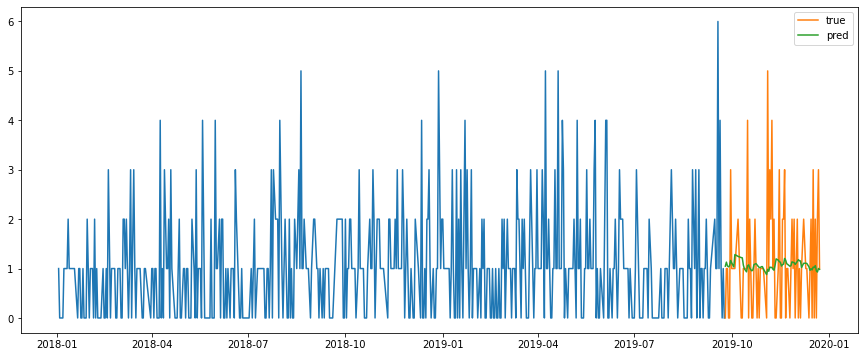

Test MSE: 1.255
Test RMSE: 1.120
Test MAPE: inf
성별:  여성  , 연령:  20대


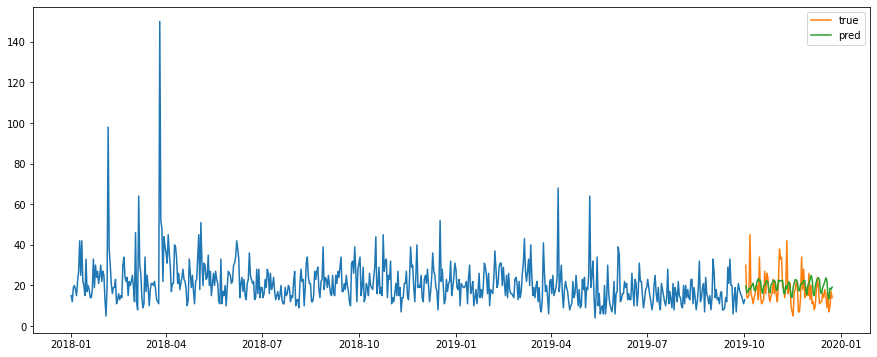

Test MSE: 58.958
Test RMSE: 7.678
Test MAPE: 42.285
성별:  여성  , 연령:  30대


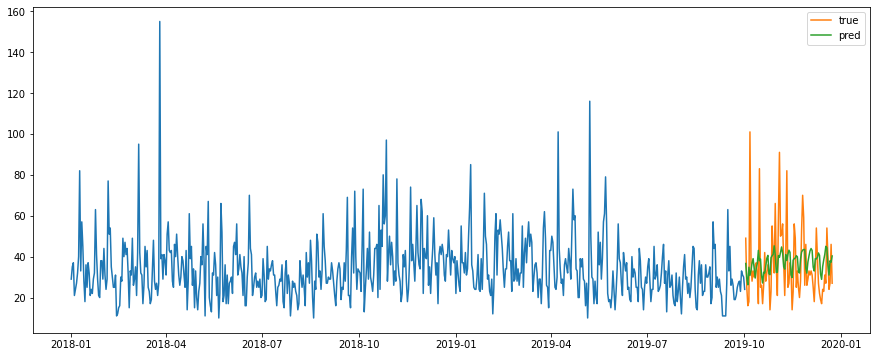

Test MSE: 277.166
Test RMSE: 16.648
Test MAPE: 39.048
성별:  여성  , 연령:  40대


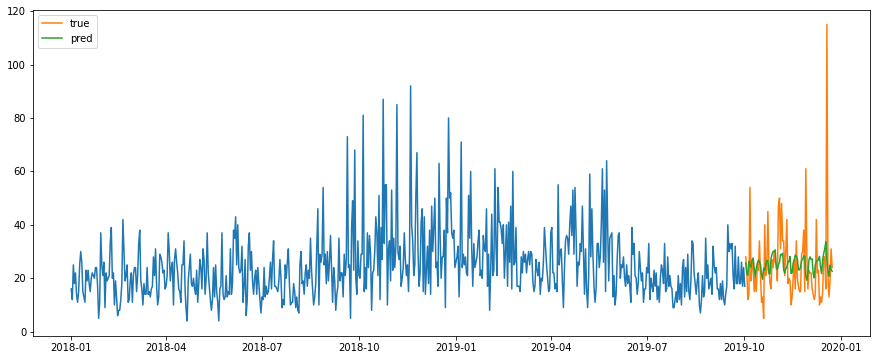

Test MSE: 208.424
Test RMSE: 14.437
Test MAPE: 43.508
성별:  여성  , 연령:  50대


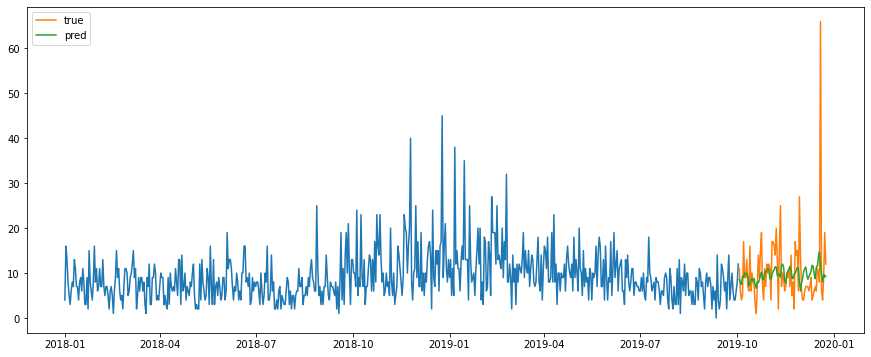

Test MSE: 62.155
Test RMSE: 7.884
Test MAPE: 60.578
성별:  여성  , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


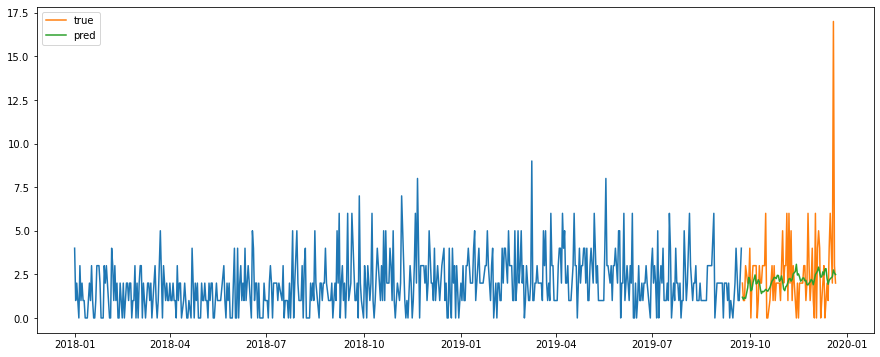

Test MSE: 5.173
Test RMSE: 2.274
Test MAPE: inf
소분류:  베이스 메이크업용 CC크림
성별:  남성 , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


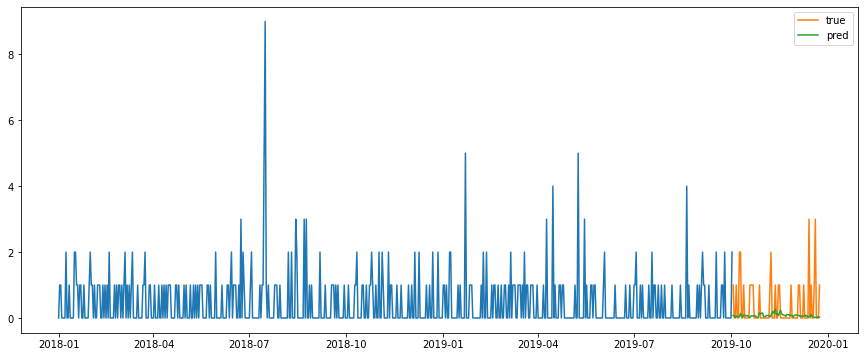

Test MSE: 0.545
Test RMSE: 0.738
Test MAPE: inf
성별:  남성 , 연령:  30대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


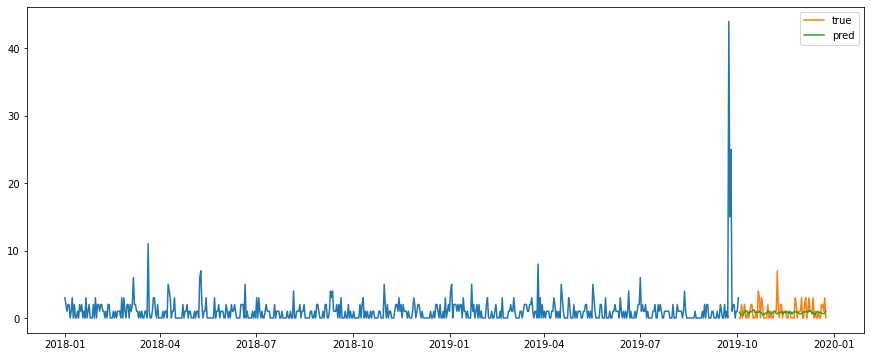

Test MSE: 1.604
Test RMSE: 1.266
Test MAPE: inf
성별:  남성 , 연령:  40대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


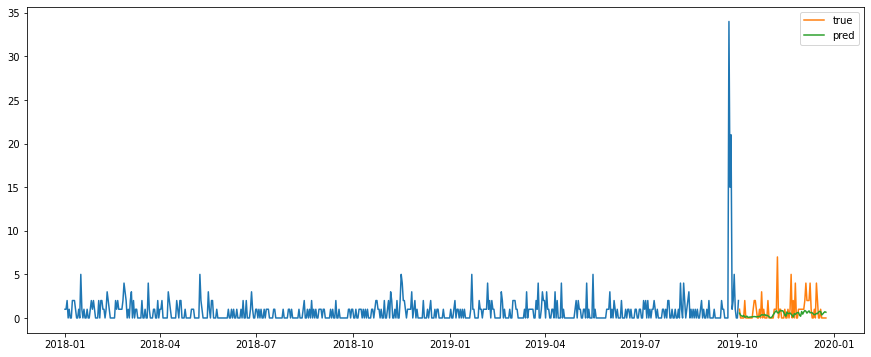

Test MSE: 1.884
Test RMSE: 1.373
Test MAPE: inf
성별:  남성 , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


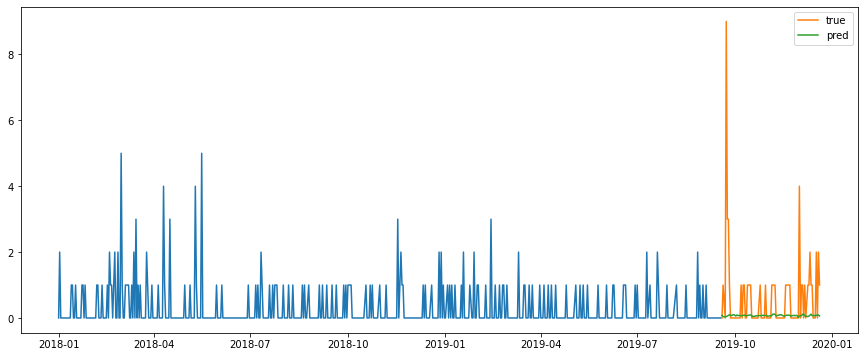

Test MSE: 1.710
Test RMSE: 1.308
Test MAPE: inf
성별:  남성 , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


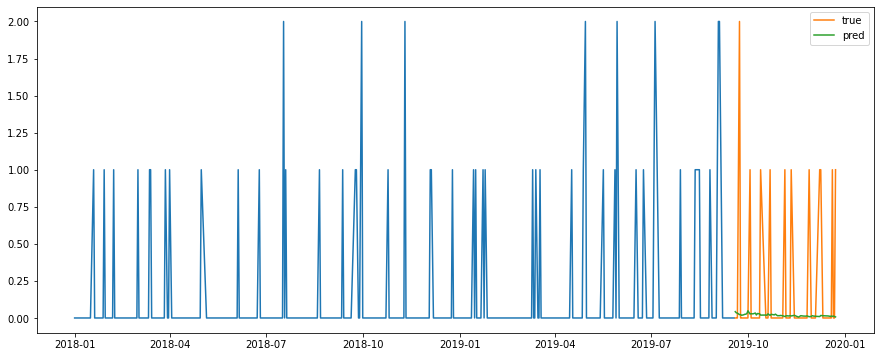

Test MSE: 0.228
Test RMSE: 0.477
Test MAPE: inf
성별:  여성  , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


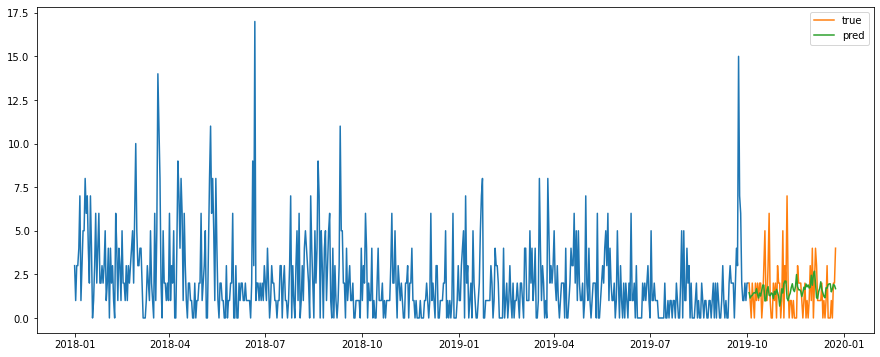

Test MSE: 2.408
Test RMSE: 1.552
Test MAPE: inf
성별:  여성  , 연령:  30대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


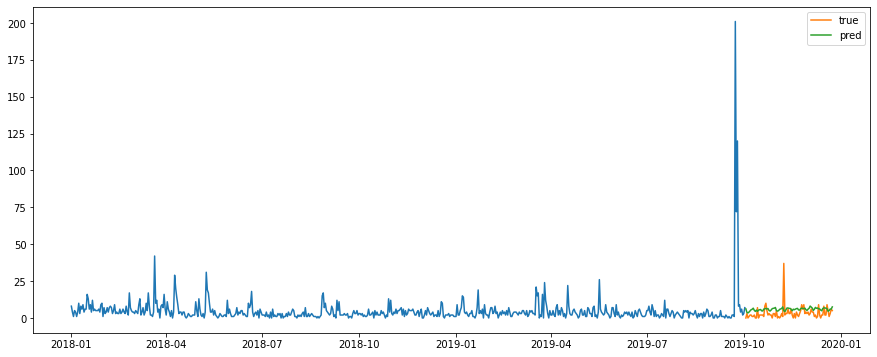

Test MSE: 26.743
Test RMSE: 5.171
Test MAPE: inf
성별:  여성  , 연령:  40대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


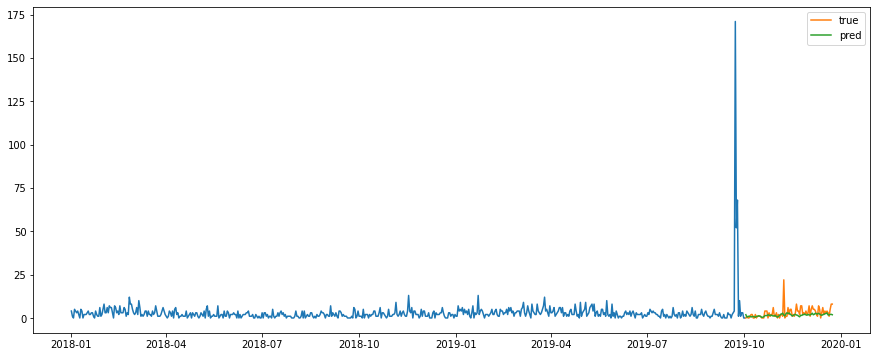

Test MSE: 10.468
Test RMSE: 3.235
Test MAPE: inf
성별:  여성  , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


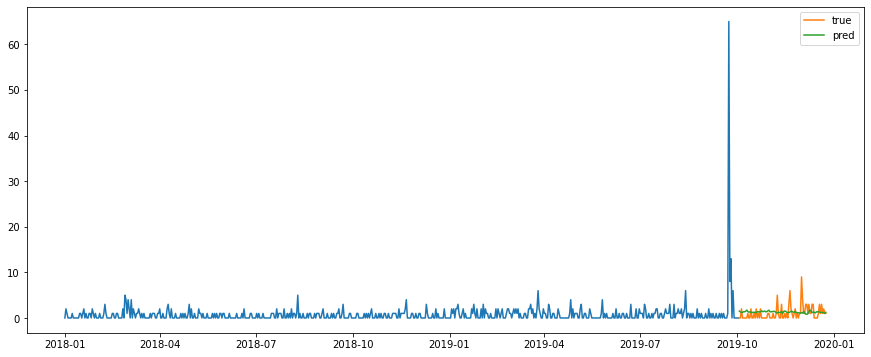

Test MSE: 2.568
Test RMSE: 1.603
Test MAPE: inf
성별:  여성  , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


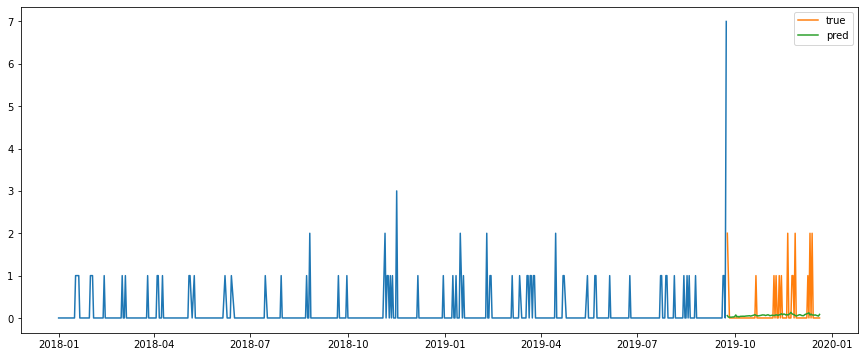

Test MSE: 0.338
Test RMSE: 0.581
Test MAPE: inf
소분류:  베이스 메이크업용 메이크업베이스
성별:  남성 , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


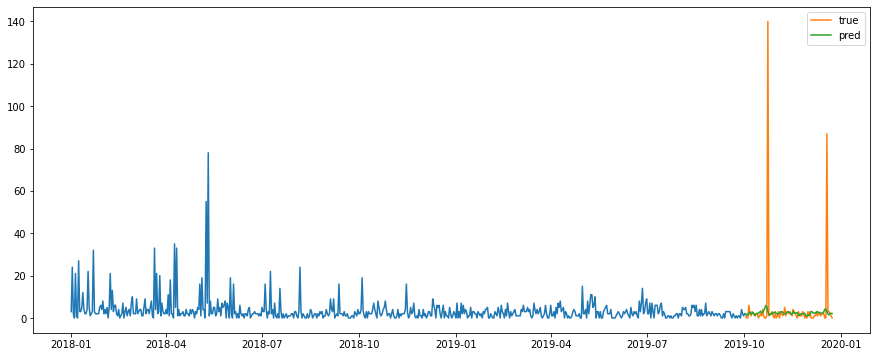

Test MSE: 314.733
Test RMSE: 17.741
Test MAPE: inf
성별:  남성 , 연령:  30대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


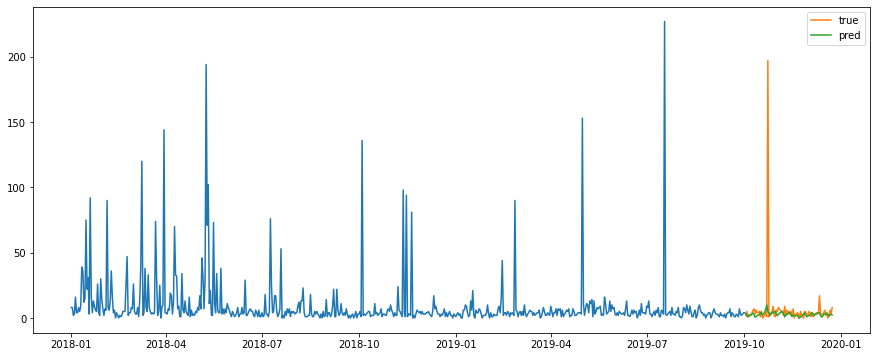

Test MSE: 453.952
Test RMSE: 21.306
Test MAPE: inf
성별:  남성 , 연령:  40대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


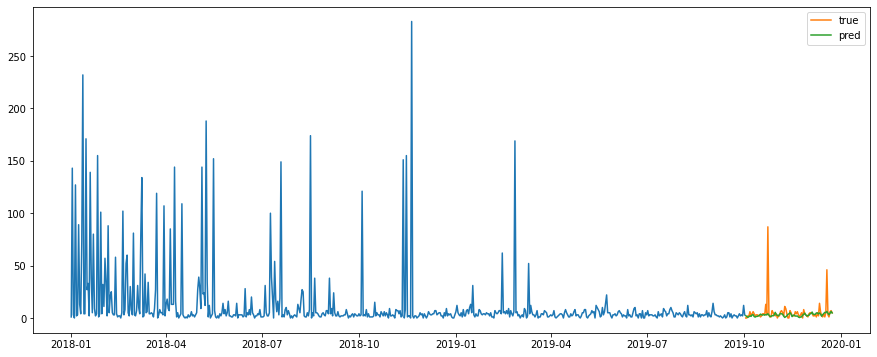

Test MSE: 110.072
Test RMSE: 10.492
Test MAPE: inf
성별:  남성 , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


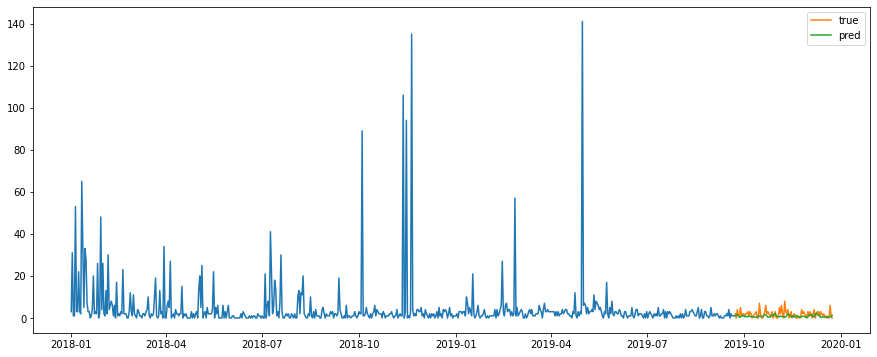

Test MSE: 4.125
Test RMSE: 2.031
Test MAPE: inf
성별:  남성 , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


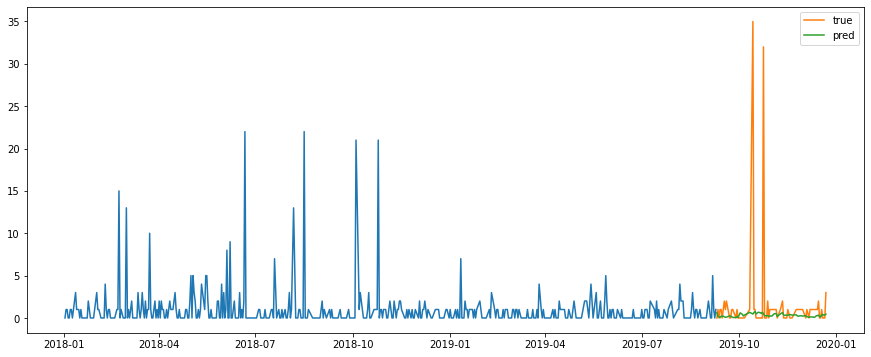

Test MSE: 31.366
Test RMSE: 5.601
Test MAPE: inf
성별:  여성  , 연령:  20대


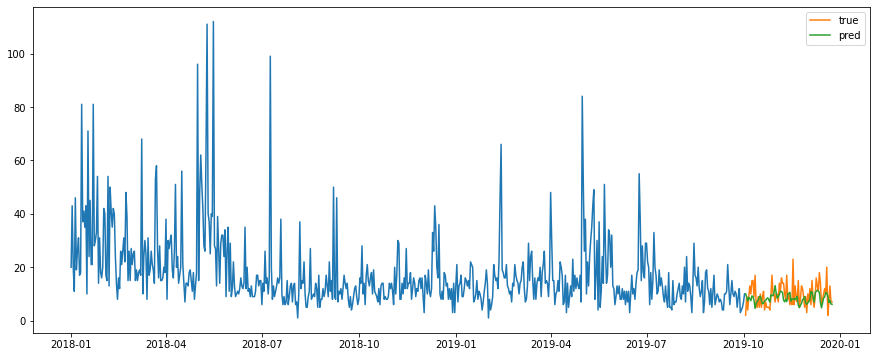

Test MSE: 19.558
Test RMSE: 4.422
Test MAPE: 41.503
성별:  여성  , 연령:  30대


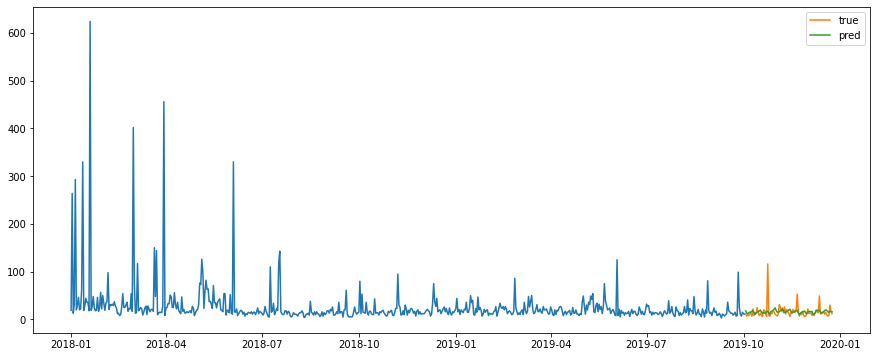

Test MSE: 180.119
Test RMSE: 13.421
Test MAPE: 48.829
성별:  여성  , 연령:  40대


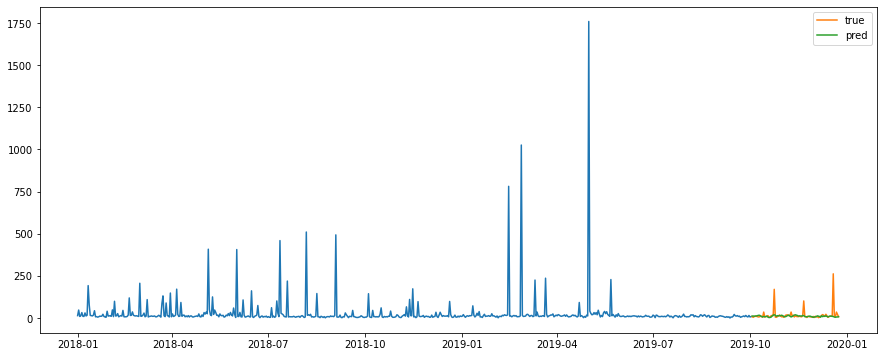

Test MSE: 1191.809
Test RMSE: 34.523
Test MAPE: 58.698
성별:  여성  , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


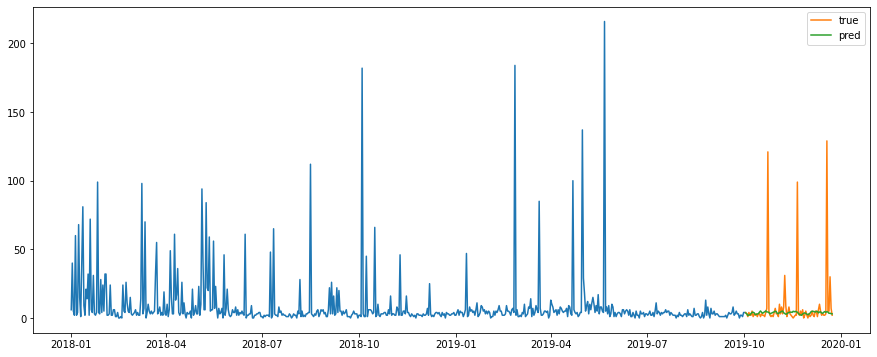

Test MSE: 481.812
Test RMSE: 21.950
Test MAPE: inf
성별:  여성  , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


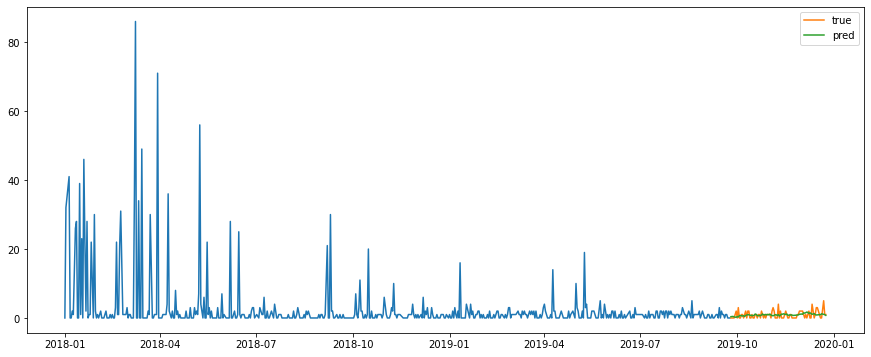

Test MSE: 1.264
Test RMSE: 1.124
Test MAPE: inf
소분류:  벽걸이형 냉온풍기
성별:  남성 , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


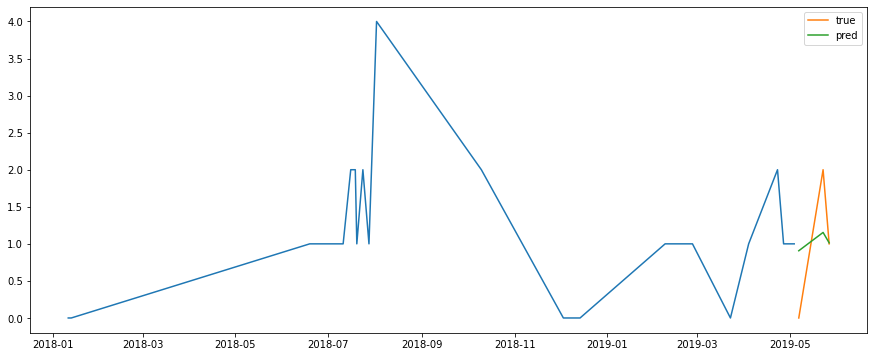

Test MSE: 0.513
Test RMSE: 0.716
Test MAPE: inf
성별:  남성 , 연령:  30대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


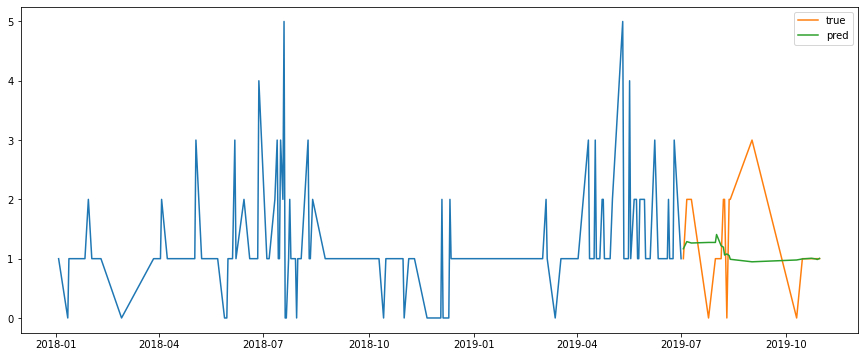

Test MSE: 0.672
Test RMSE: 0.820
Test MAPE: inf
성별:  남성 , 연령:  40대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


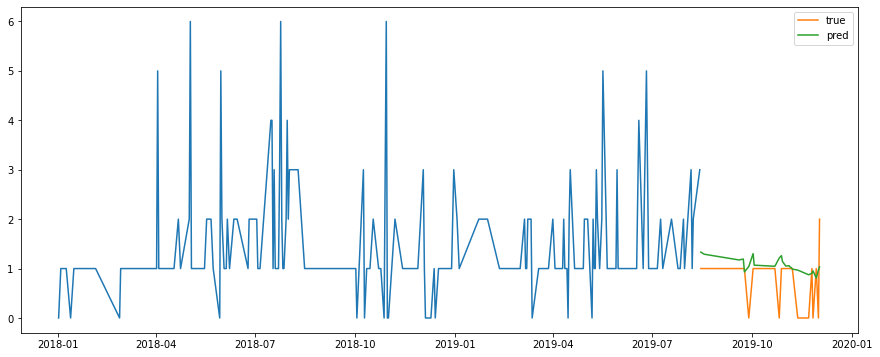

Test MSE: 0.315
Test RMSE: 0.561
Test MAPE: inf
성별:  남성 , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


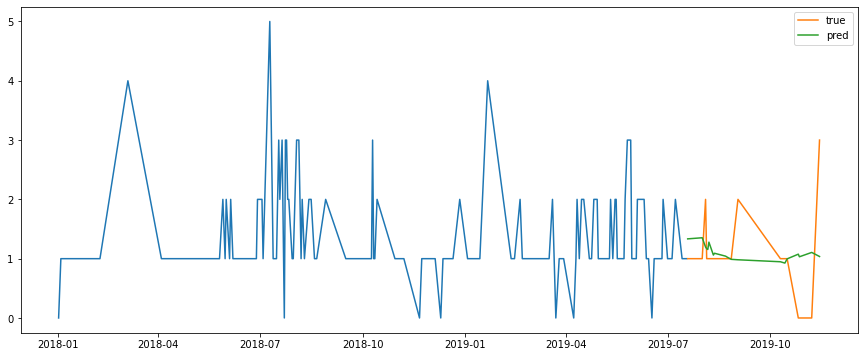

Test MSE: 0.493
Test RMSE: 0.702
Test MAPE: inf
성별:  남성 , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


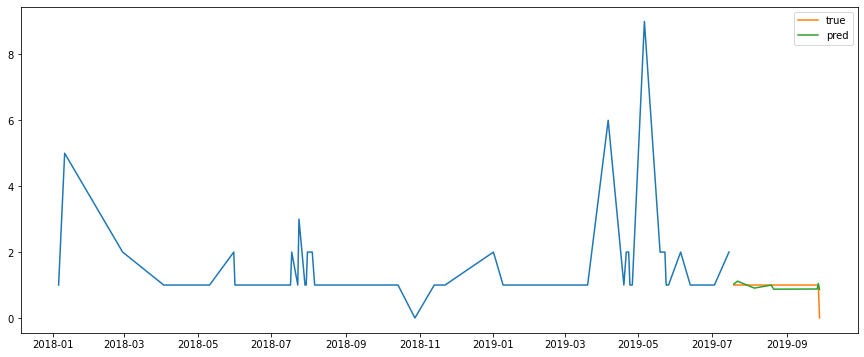

Test MSE: 0.100
Test RMSE: 0.317
Test MAPE: inf
성별:  여성  , 연령:  20대


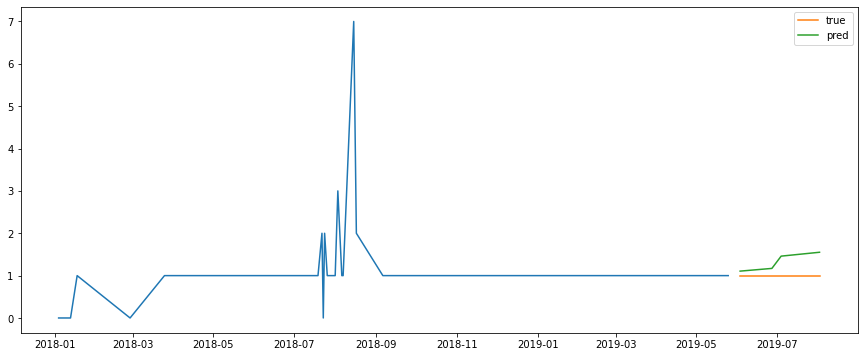

Test MSE: 0.120
Test RMSE: 0.347
Test MAPE: 29.981
성별:  여성  , 연령:  30대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


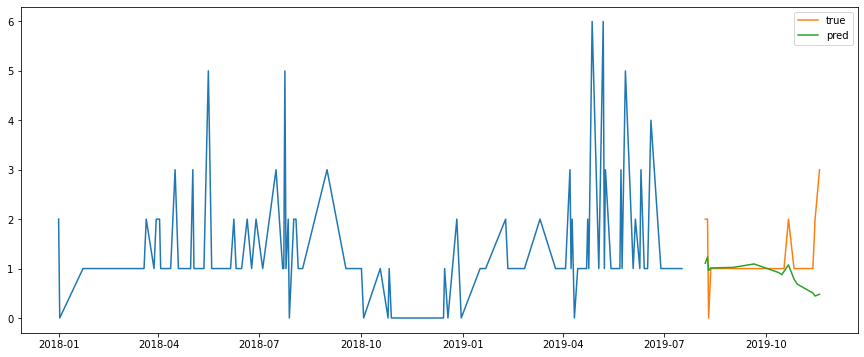

Test MSE: 0.823
Test RMSE: 0.907
Test MAPE: inf
성별:  여성  , 연령:  40대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


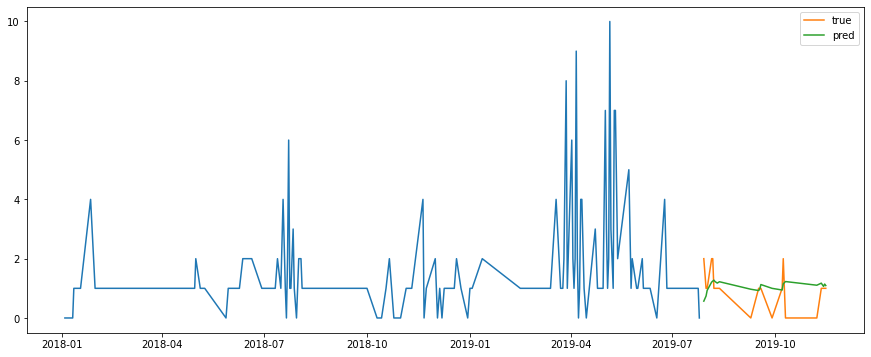

Test MSE: 0.409
Test RMSE: 0.640
Test MAPE: inf
성별:  여성  , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


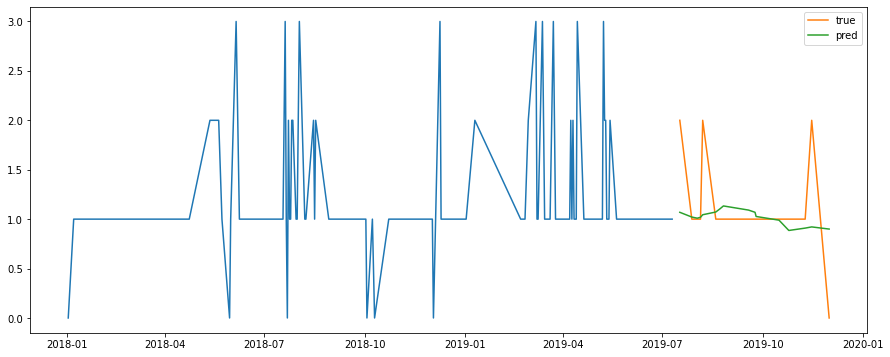

Test MSE: 0.239
Test RMSE: 0.489
Test MAPE: inf
성별:  여성  , 연령:  60대


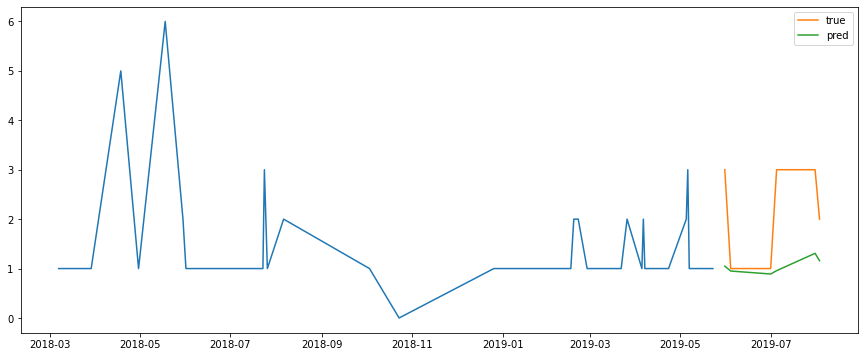

Test MSE: 1.928
Test RMSE: 1.388
Test MAPE: 41.272
소분류:  보일러
성별:  남성 , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


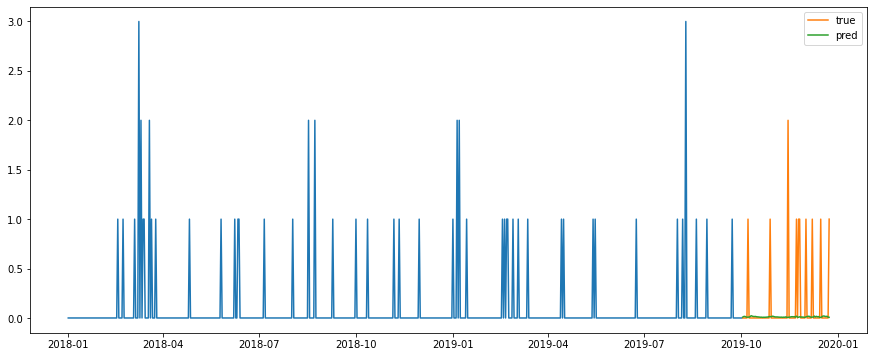

Test MSE: 0.154
Test RMSE: 0.393
Test MAPE: inf
성별:  남성 , 연령:  30대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


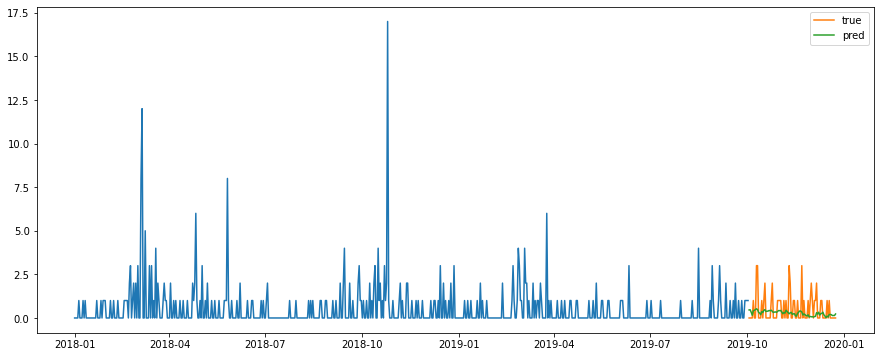

Test MSE: 0.701
Test RMSE: 0.838
Test MAPE: inf
성별:  남성 , 연령:  40대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


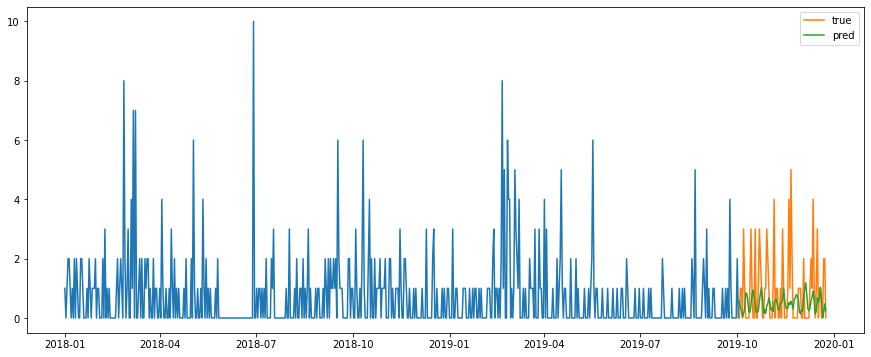

Test MSE: 1.616
Test RMSE: 1.271
Test MAPE: inf
성별:  남성 , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


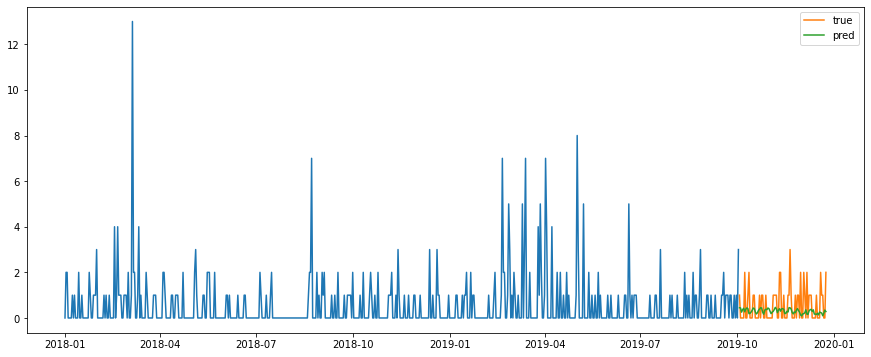

Test MSE: 0.603
Test RMSE: 0.777
Test MAPE: inf
성별:  남성 , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


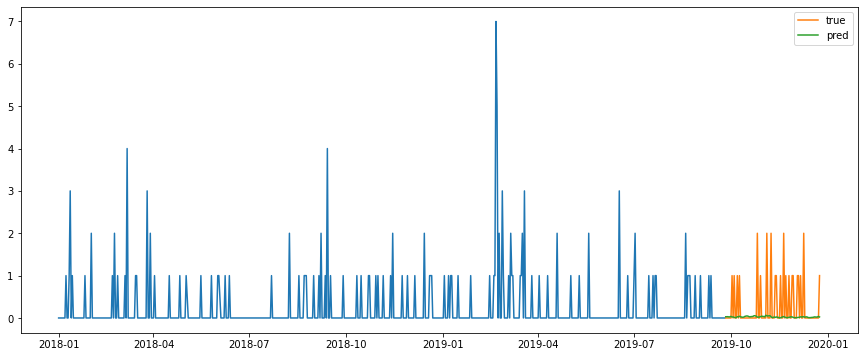

Test MSE: 0.387
Test RMSE: 0.622
Test MAPE: inf
성별:  여성  , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: invalid value encountered in true_divide
  


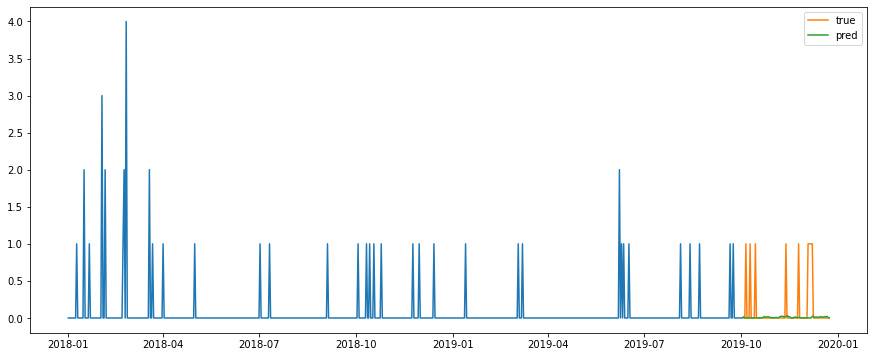

Test MSE: 0.119
Test RMSE: 0.346
Test MAPE: nan
성별:  여성  , 연령:  30대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


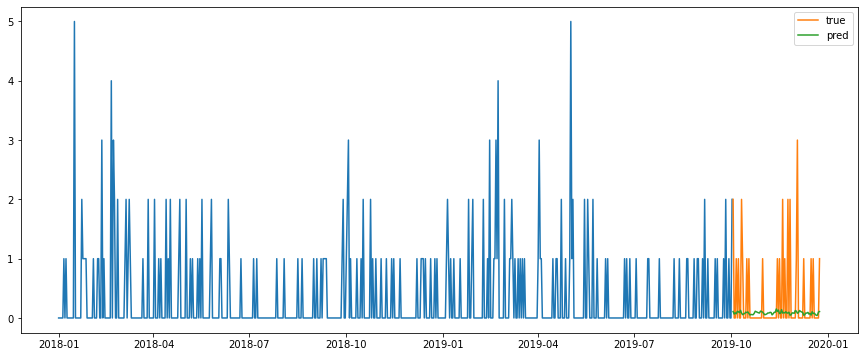

Test MSE: 0.473
Test RMSE: 0.688
Test MAPE: inf
성별:  여성  , 연령:  40대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


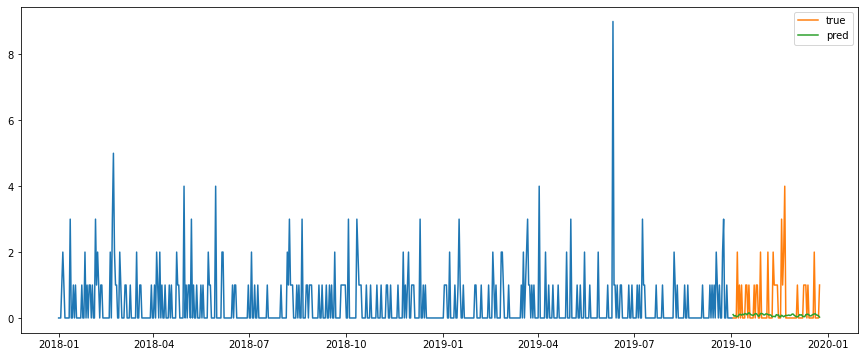

Test MSE: 0.754
Test RMSE: 0.868
Test MAPE: inf
성별:  여성  , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: invalid value encountered in true_divide
  


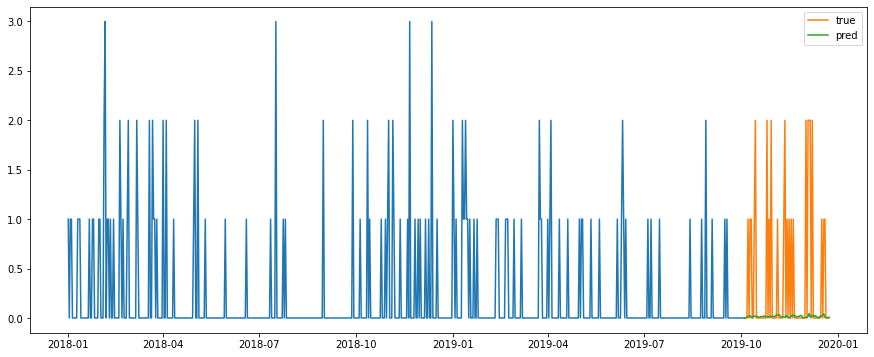

Test MSE: 0.598
Test RMSE: 0.773
Test MAPE: nan
성별:  여성  , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


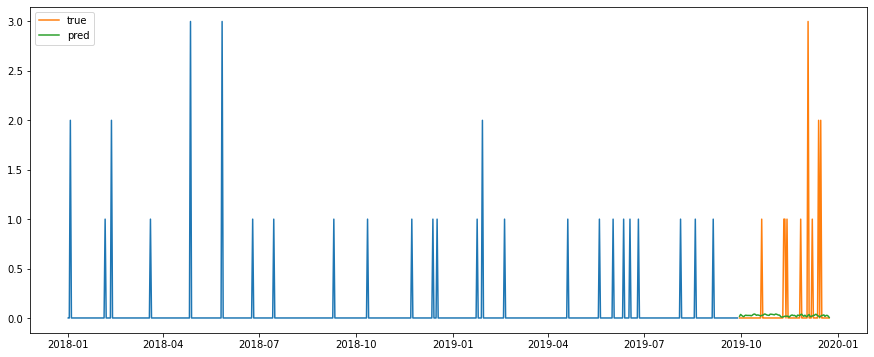

Test MSE: 0.261
Test RMSE: 0.511
Test MAPE: inf
소분류:  뷰티 속눈썹/쌍꺼풀
성별:  남성 , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


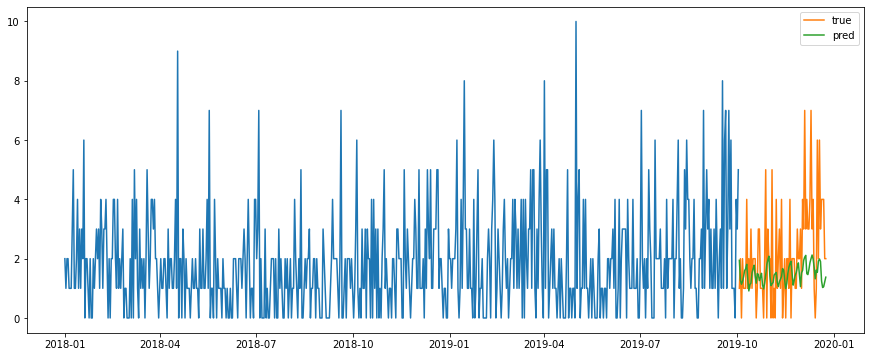

Test MSE: 2.928
Test RMSE: 1.711
Test MAPE: inf
성별:  남성 , 연령:  30대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


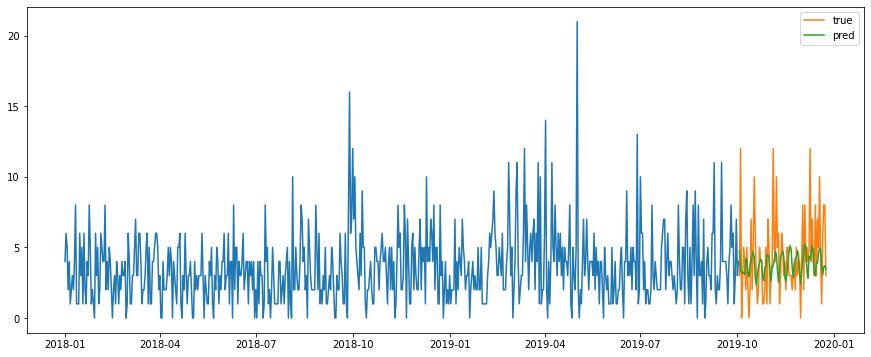

Test MSE: 7.141
Test RMSE: 2.672
Test MAPE: inf
성별:  남성 , 연령:  40대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


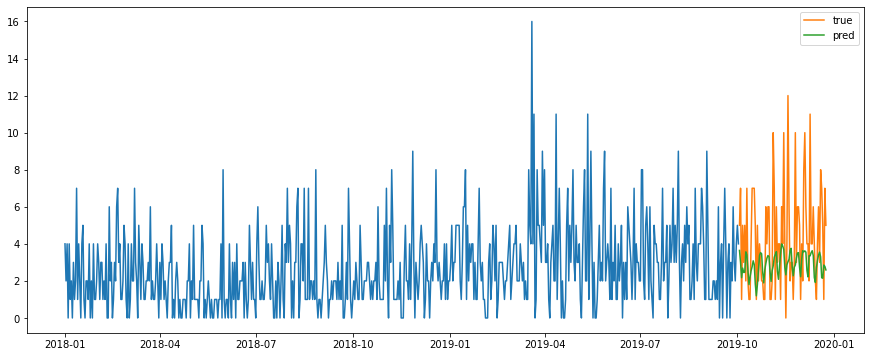

Test MSE: 8.402
Test RMSE: 2.899
Test MAPE: inf
성별:  남성 , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


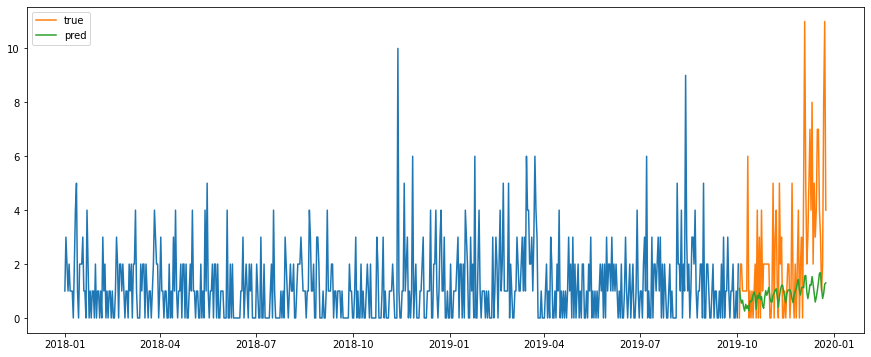

Test MSE: 7.880
Test RMSE: 2.807
Test MAPE: inf
성별:  남성 , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


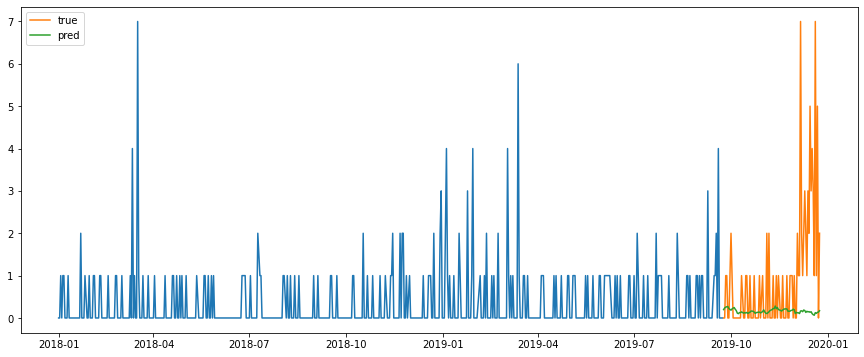

Test MSE: 2.746
Test RMSE: 1.657
Test MAPE: inf
성별:  여성  , 연령:  20대


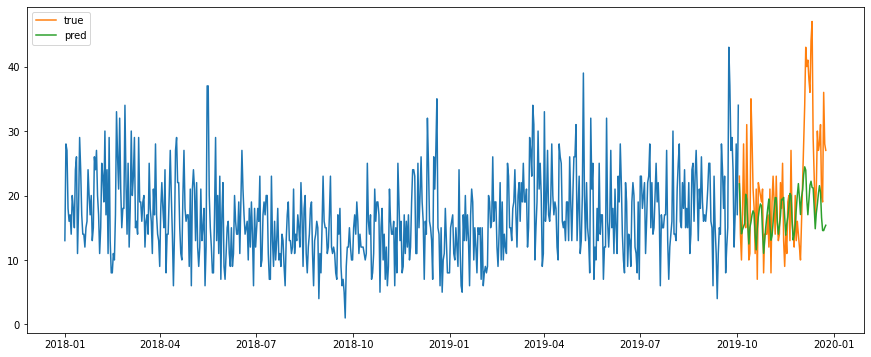

Test MSE: 76.701
Test RMSE: 8.758
Test MAPE: 29.905
성별:  여성  , 연령:  30대


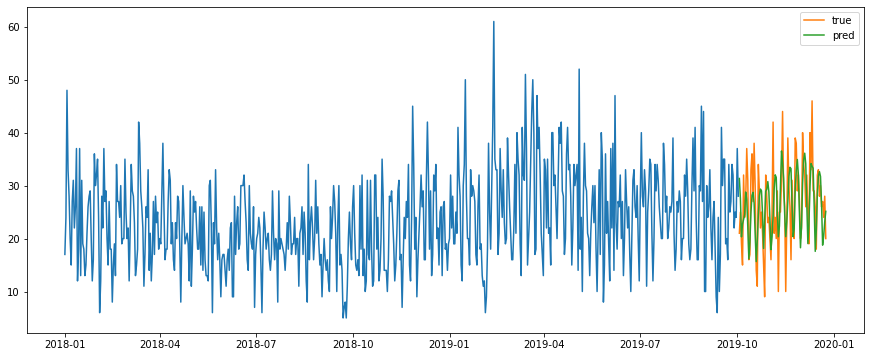

Test MSE: 46.190
Test RMSE: 6.796
Test MAPE: 23.743
성별:  여성  , 연령:  40대


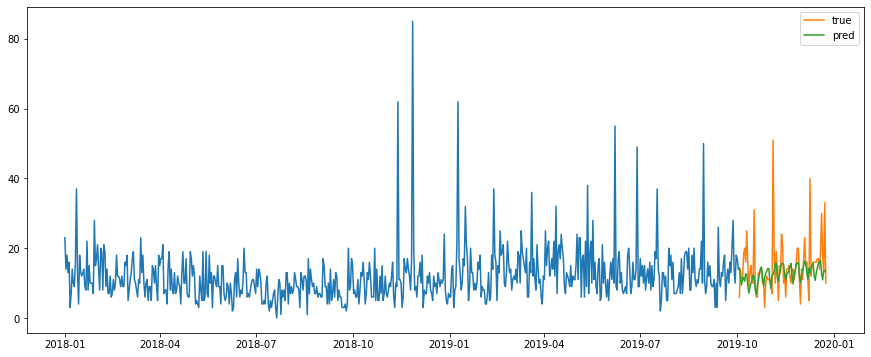

Test MSE: 55.449
Test RMSE: 7.446
Test MAPE: 33.236
성별:  여성  , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


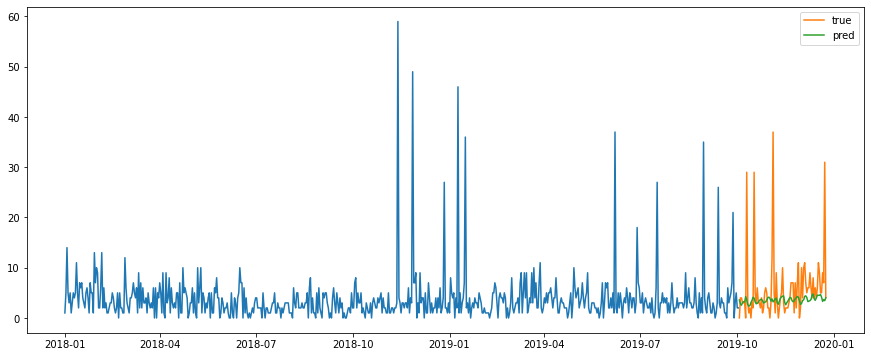

Test MSE: 46.788
Test RMSE: 6.840
Test MAPE: inf
성별:  여성  , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


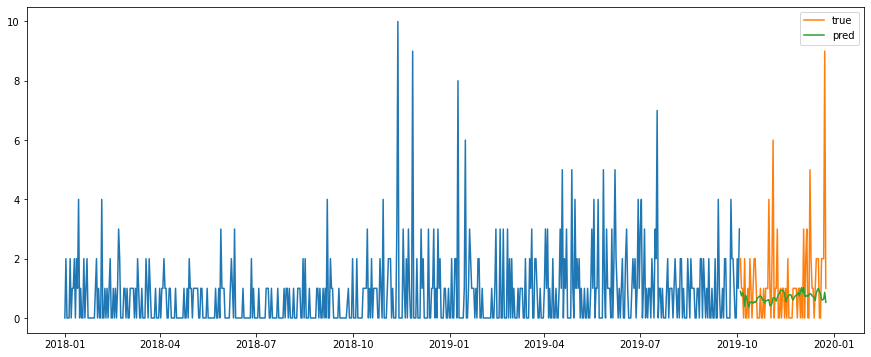

Test MSE: 2.247
Test RMSE: 1.499
Test MAPE: inf
소분류:  뷰티용 기름종이
성별:  남성 , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


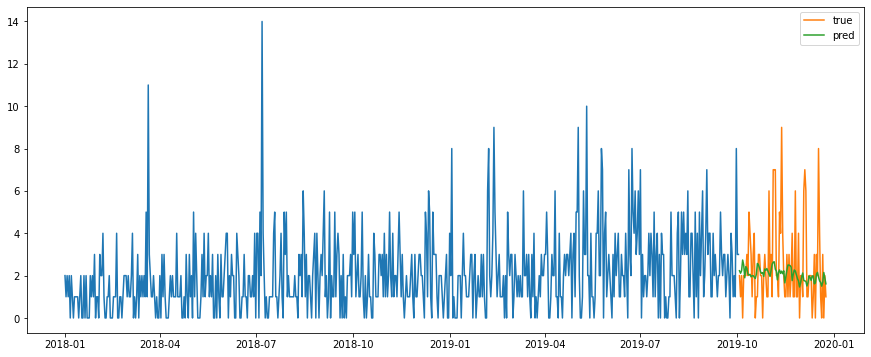

Test MSE: 4.239
Test RMSE: 2.059
Test MAPE: inf
성별:  남성 , 연령:  30대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


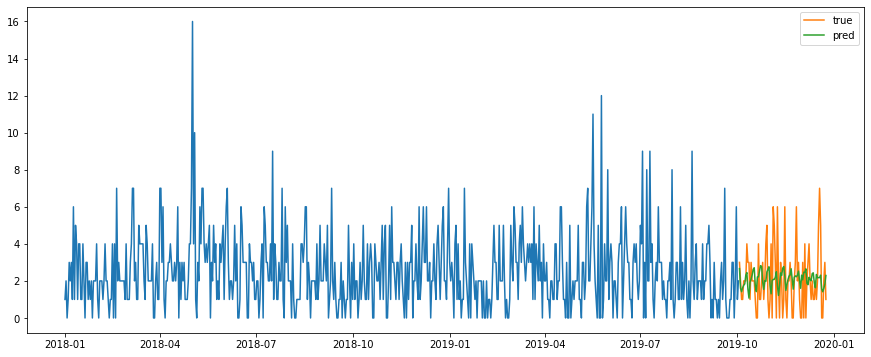

Test MSE: 2.999
Test RMSE: 1.732
Test MAPE: inf
성별:  남성 , 연령:  40대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


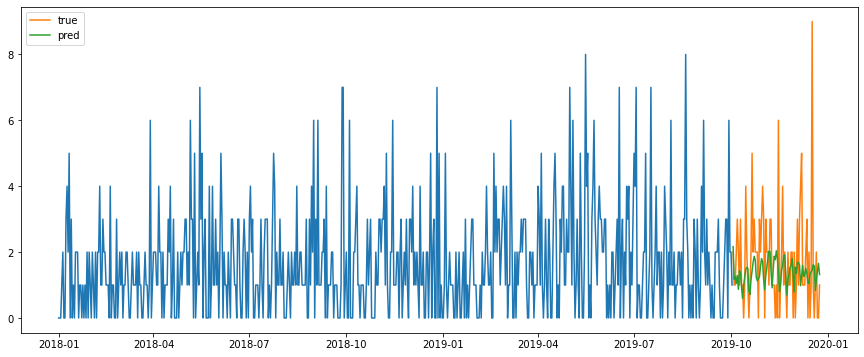

Test MSE: 2.426
Test RMSE: 1.557
Test MAPE: inf
성별:  남성 , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


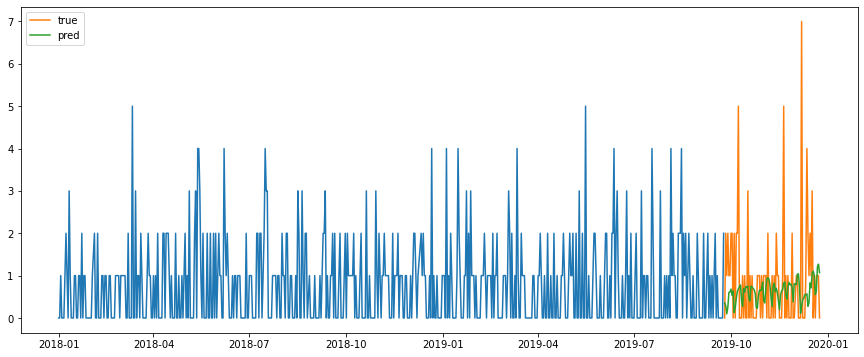

Test MSE: 1.715
Test RMSE: 1.310
Test MAPE: inf
성별:  남성 , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


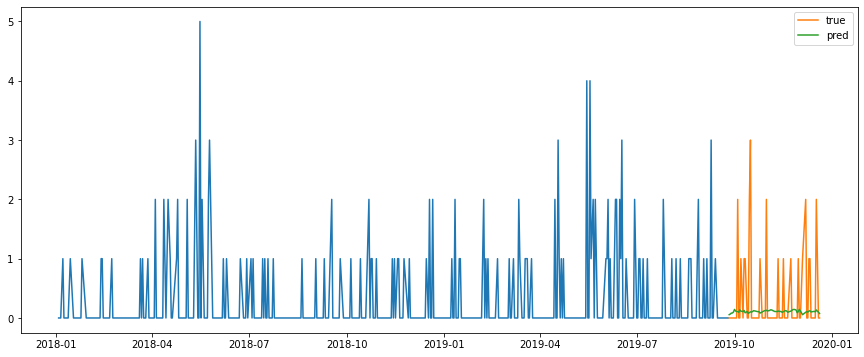

Test MSE: 0.514
Test RMSE: 0.717
Test MAPE: inf
성별:  여성  , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


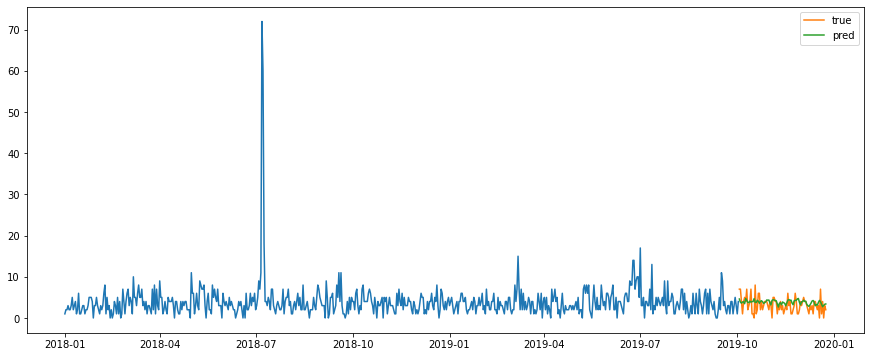

Test MSE: 3.799
Test RMSE: 1.949
Test MAPE: inf
성별:  여성  , 연령:  30대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


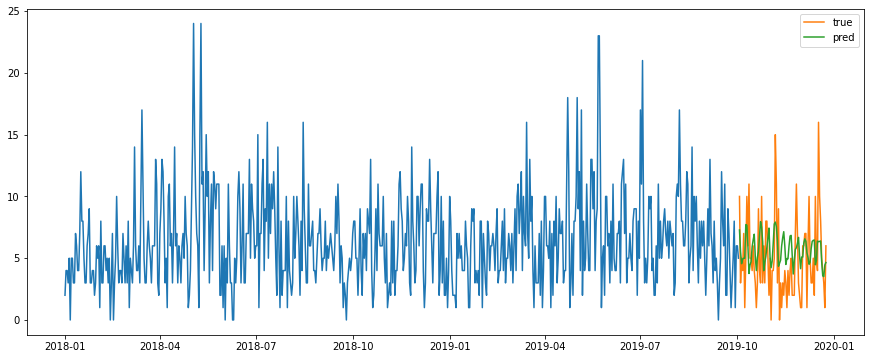

Test MSE: 10.409
Test RMSE: 3.226
Test MAPE: inf
성별:  여성  , 연령:  40대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


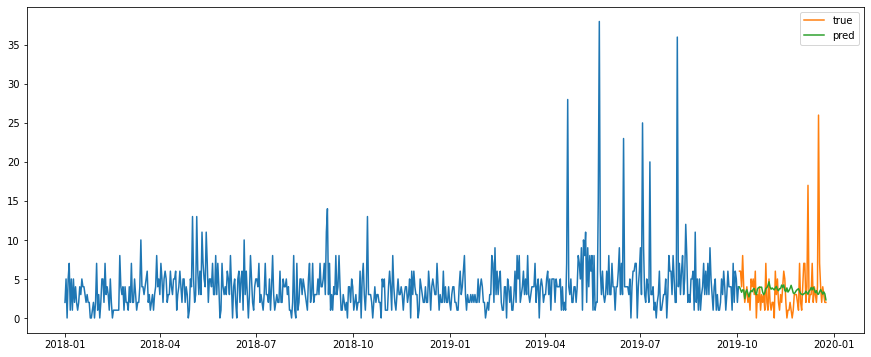

Test MSE: 12.596
Test RMSE: 3.549
Test MAPE: inf
성별:  여성  , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


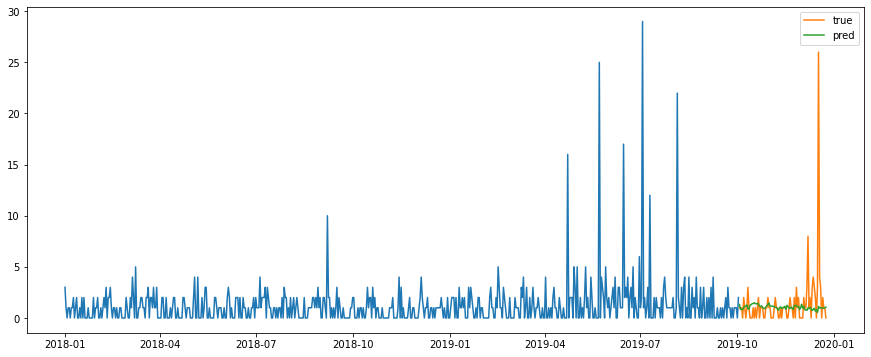

Test MSE: 9.209
Test RMSE: 3.035
Test MAPE: inf
성별:  여성  , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


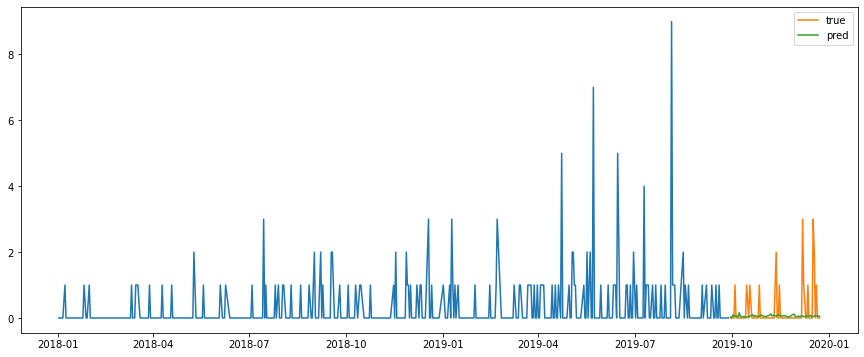

Test MSE: 0.449
Test RMSE: 0.670
Test MAPE: inf
소분류:  뷰티용 뷰러
성별:  남성 , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


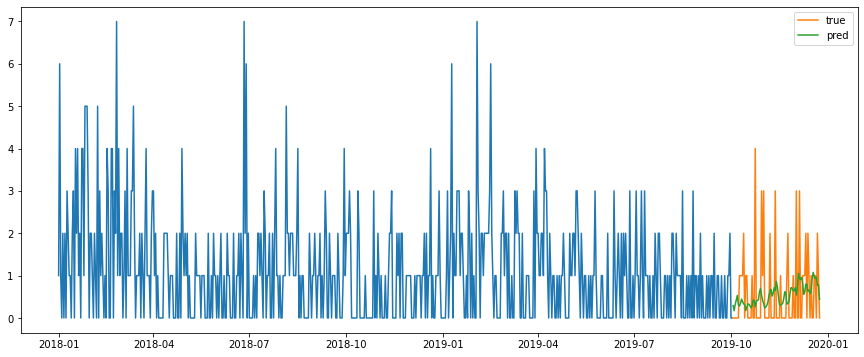

Test MSE: 0.947
Test RMSE: 0.973
Test MAPE: inf
성별:  남성 , 연령:  30대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


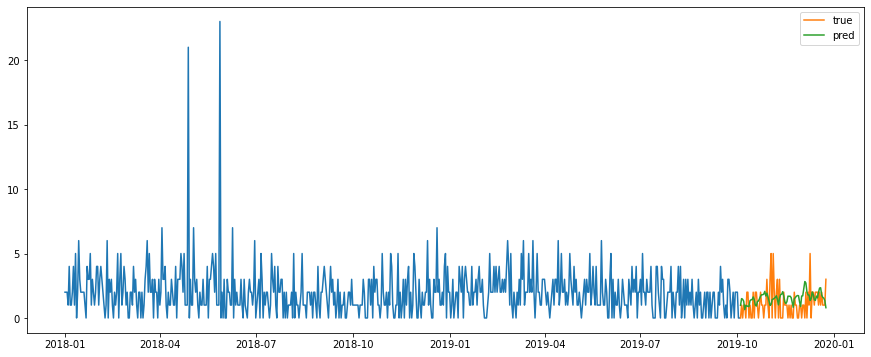

Test MSE: 1.716
Test RMSE: 1.310
Test MAPE: inf
성별:  남성 , 연령:  40대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


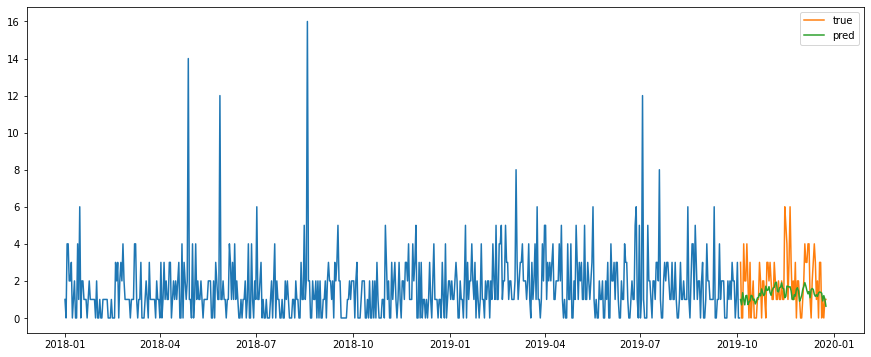

Test MSE: 2.273
Test RMSE: 1.508
Test MAPE: inf
성별:  남성 , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


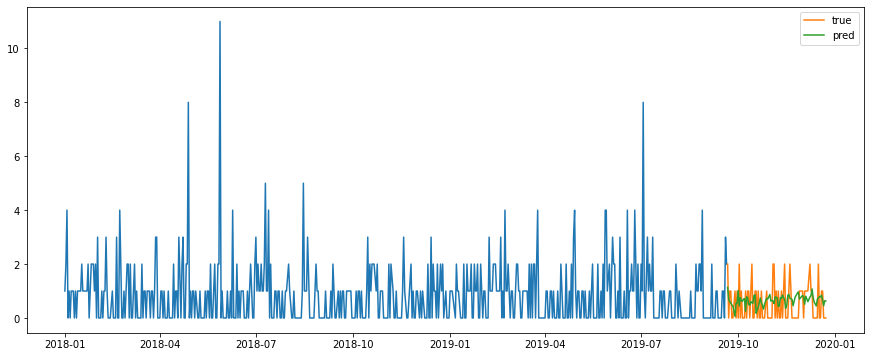

Test MSE: 0.509
Test RMSE: 0.714
Test MAPE: inf
성별:  남성 , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


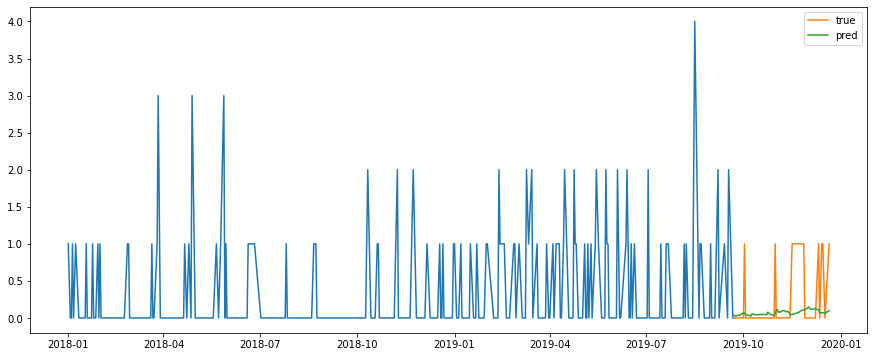

Test MSE: 0.185
Test RMSE: 0.430
Test MAPE: inf
성별:  여성  , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


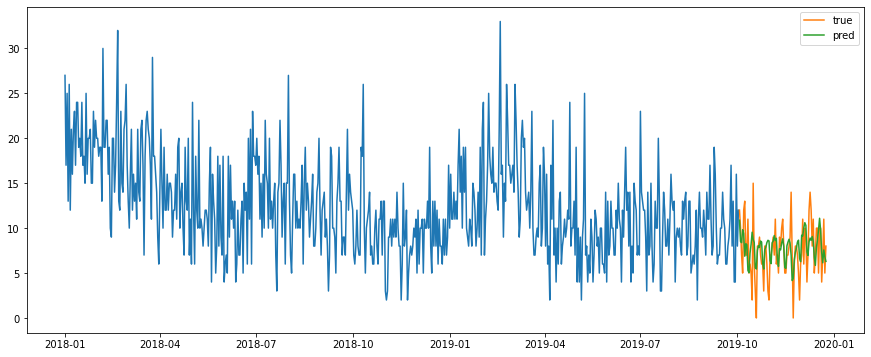

Test MSE: 8.015
Test RMSE: 2.831
Test MAPE: inf
성별:  여성  , 연령:  30대


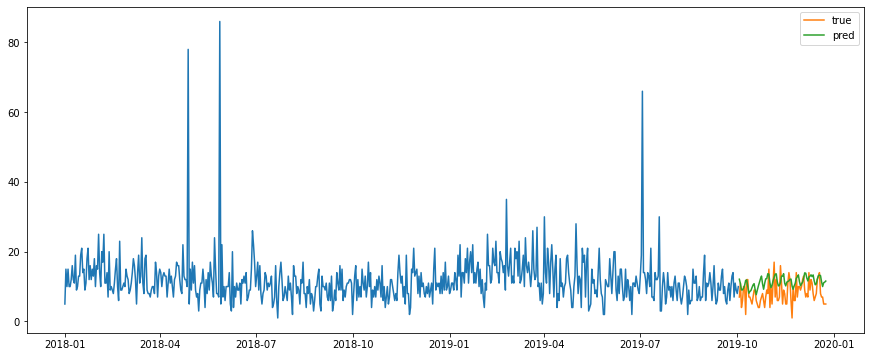

Test MSE: 18.472
Test RMSE: 4.298
Test MAPE: 69.760
성별:  여성  , 연령:  40대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


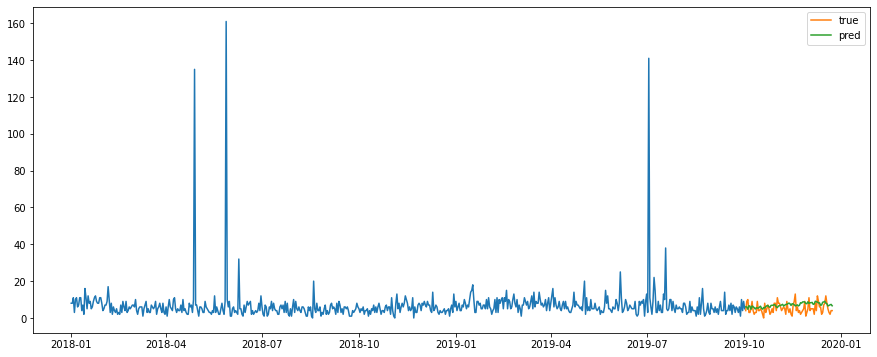

Test MSE: 11.500
Test RMSE: 3.391
Test MAPE: inf
성별:  여성  , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


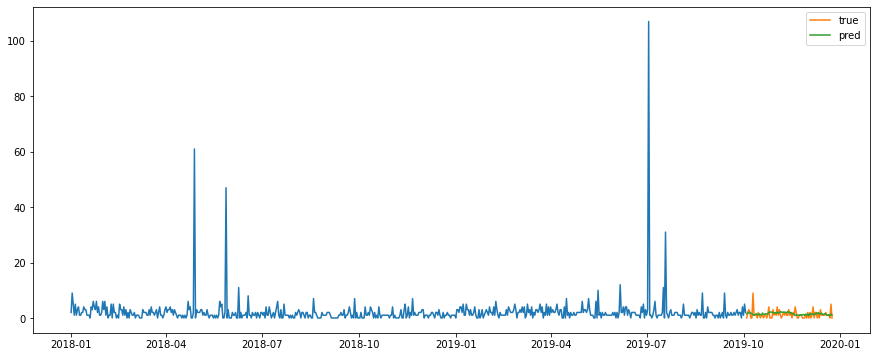

Test MSE: 2.162
Test RMSE: 1.471
Test MAPE: inf
성별:  여성  , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


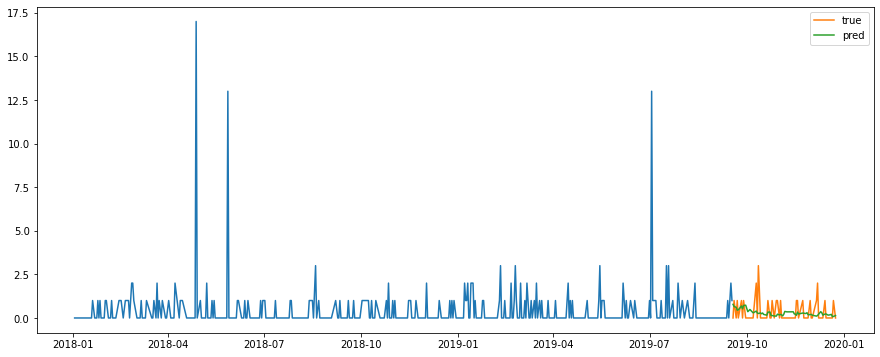

Test MSE: 0.425
Test RMSE: 0.652
Test MAPE: inf
소분류:  뷰티용 여드름압출기
성별:  남성 , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


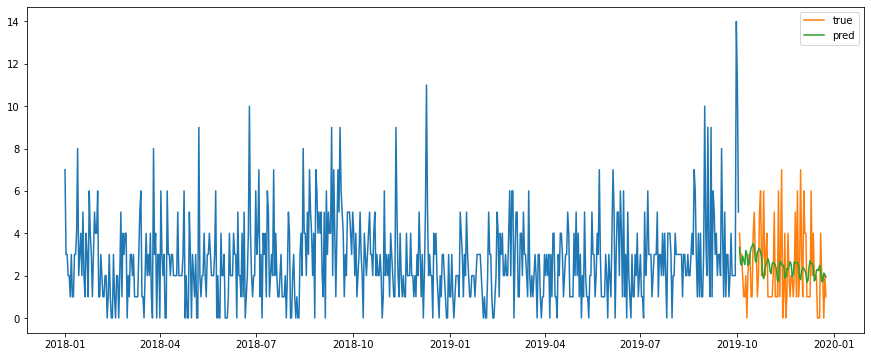

Test MSE: 3.332
Test RMSE: 1.825
Test MAPE: inf
성별:  남성 , 연령:  30대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


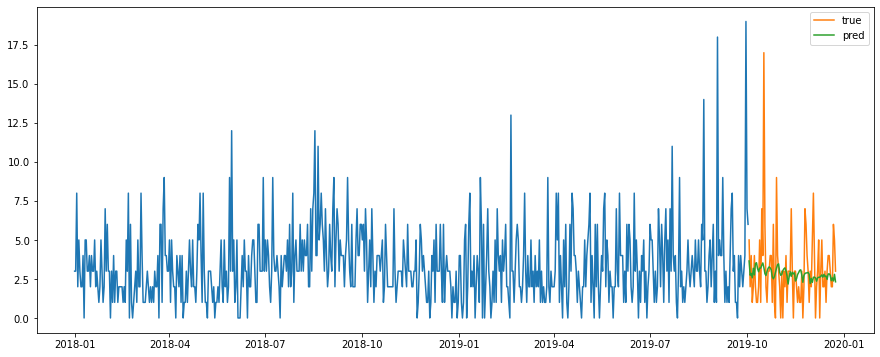

Test MSE: 6.041
Test RMSE: 2.458
Test MAPE: inf
성별:  남성 , 연령:  40대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


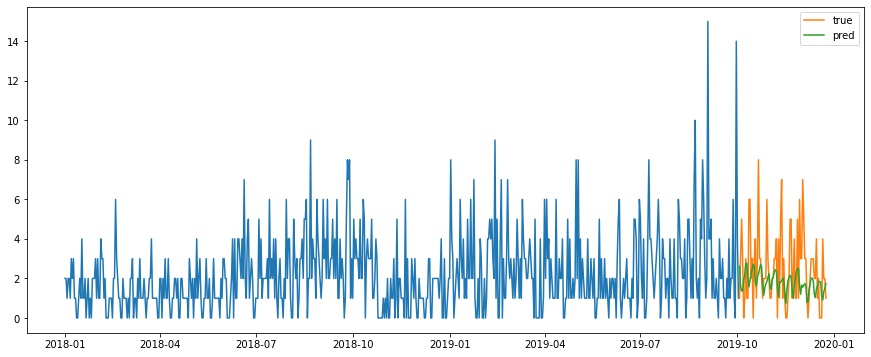

Test MSE: 3.926
Test RMSE: 1.981
Test MAPE: inf
성별:  남성 , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


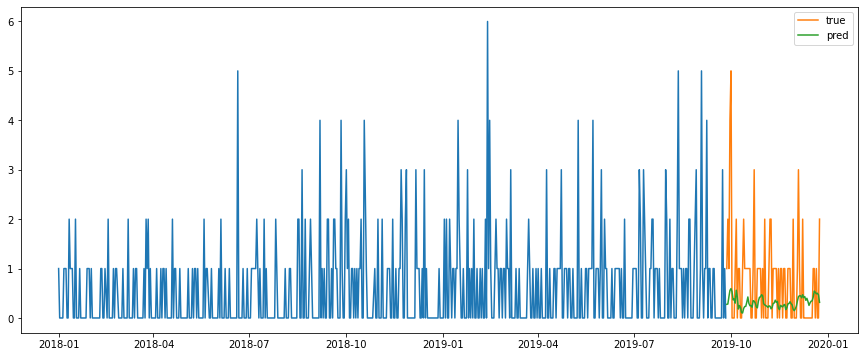

Test MSE: 1.041
Test RMSE: 1.020
Test MAPE: inf
성별:  남성 , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


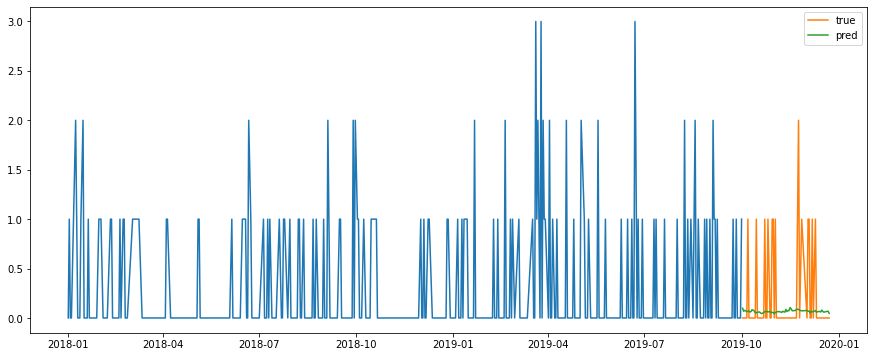

Test MSE: 0.212
Test RMSE: 0.461
Test MAPE: inf
성별:  여성  , 연령:  20대


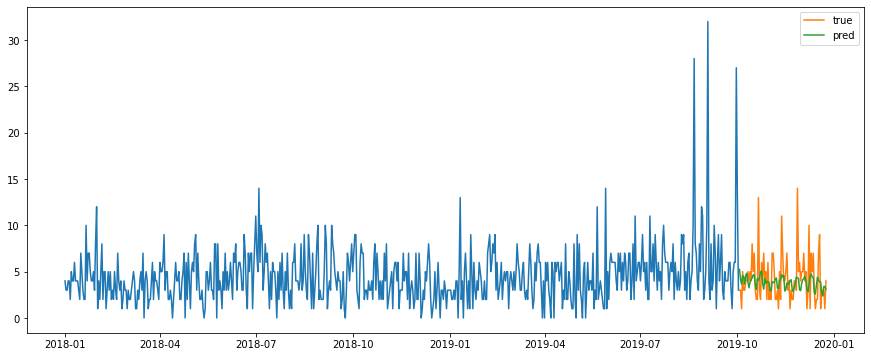

Test MSE: 6.399
Test RMSE: 2.530
Test MAPE: 59.649
성별:  여성  , 연령:  30대


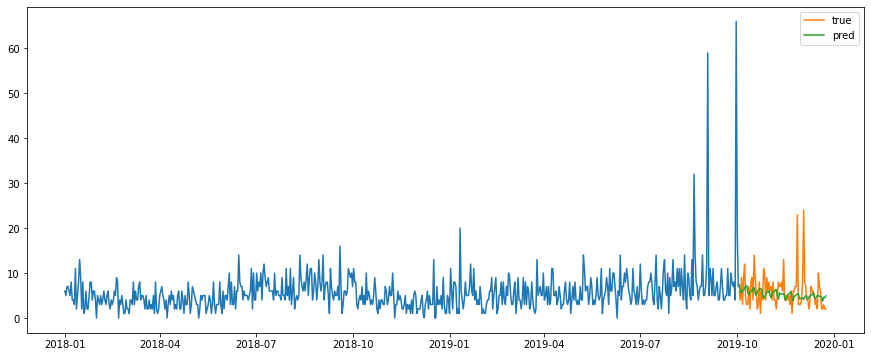

Test MSE: 16.059
Test RMSE: 4.007
Test MAPE: 59.150
성별:  여성  , 연령:  40대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


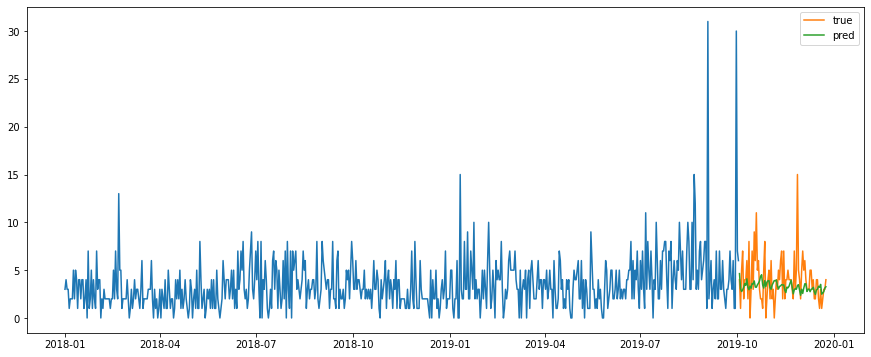

Test MSE: 6.392
Test RMSE: 2.528
Test MAPE: inf
성별:  여성  , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


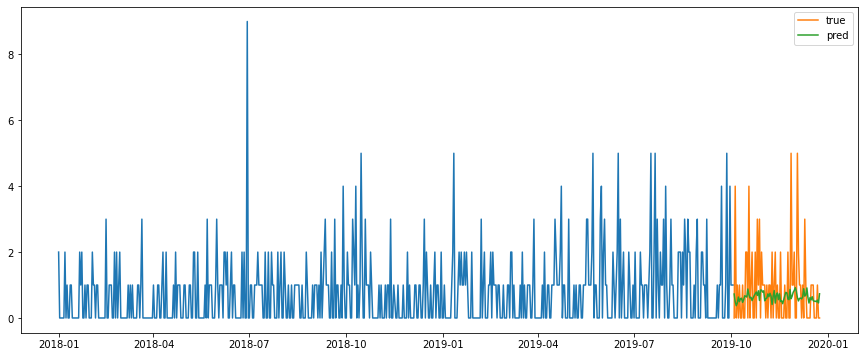

Test MSE: 1.481
Test RMSE: 1.217
Test MAPE: inf
성별:  여성  , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


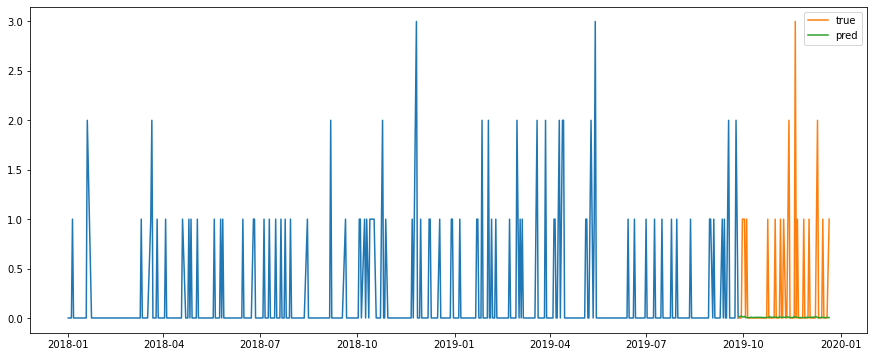

Test MSE: 0.417
Test RMSE: 0.646
Test MAPE: inf
소분류:  삼치
성별:  남성 , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


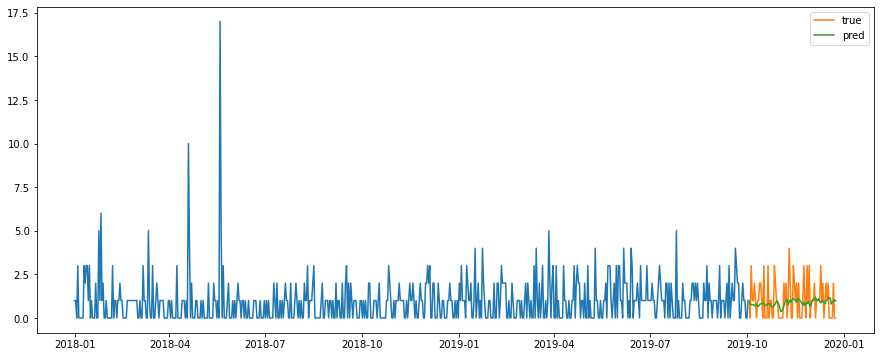

Test MSE: 1.117
Test RMSE: 1.057
Test MAPE: inf
성별:  남성 , 연령:  30대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


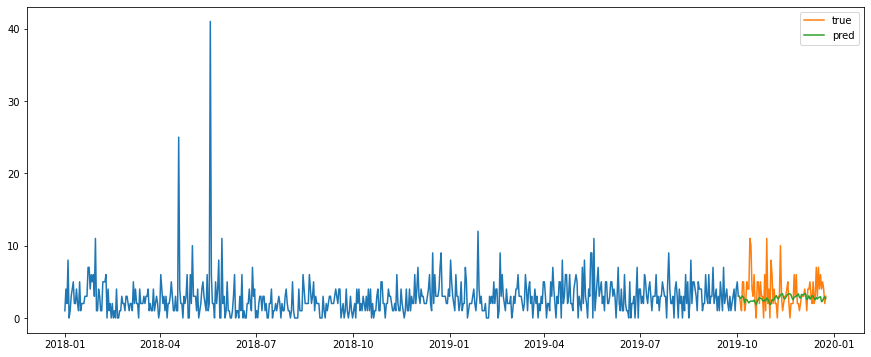

Test MSE: 6.366
Test RMSE: 2.523
Test MAPE: inf
성별:  남성 , 연령:  40대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


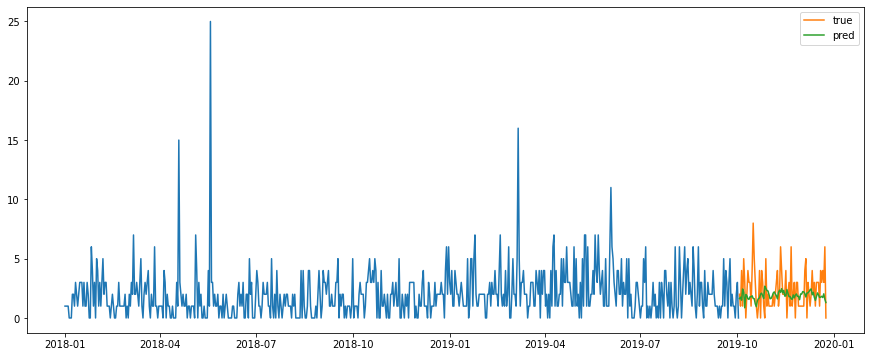

Test MSE: 3.225
Test RMSE: 1.796
Test MAPE: inf
성별:  남성 , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


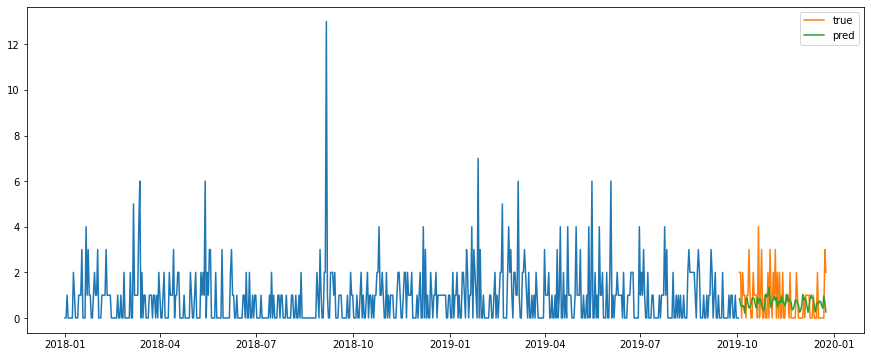

Test MSE: 1.057
Test RMSE: 1.028
Test MAPE: inf
성별:  남성 , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


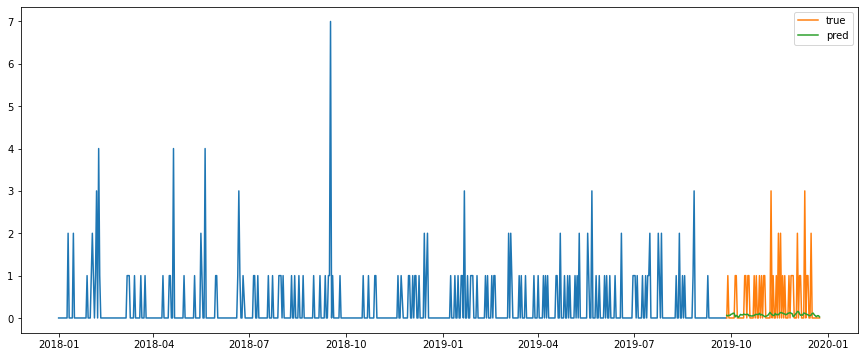

Test MSE: 0.595
Test RMSE: 0.771
Test MAPE: inf
성별:  여성  , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


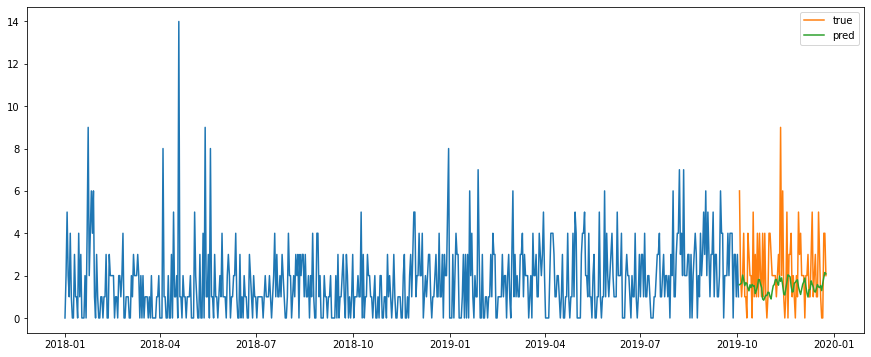

Test MSE: 3.549
Test RMSE: 1.884
Test MAPE: inf
성별:  여성  , 연령:  30대


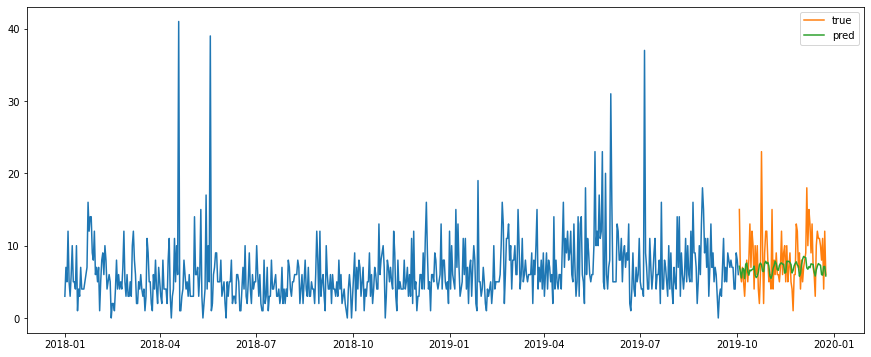

Test MSE: 15.039
Test RMSE: 3.878
Test MAPE: 43.779
성별:  여성  , 연령:  40대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


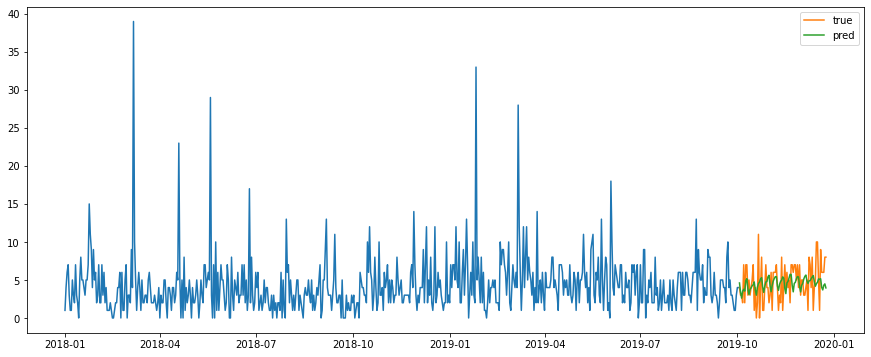

Test MSE: 6.147
Test RMSE: 2.479
Test MAPE: inf
성별:  여성  , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


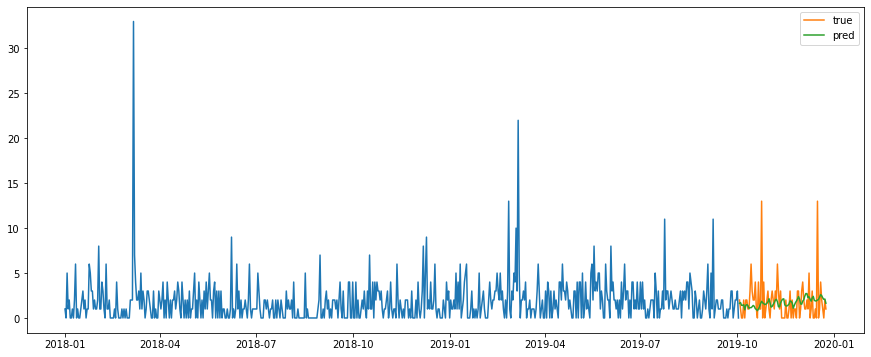

Test MSE: 5.256
Test RMSE: 2.293
Test MAPE: inf
성별:  여성  , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


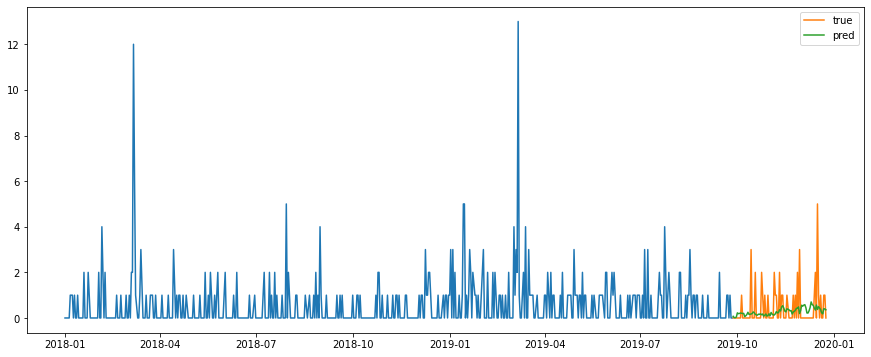

Test MSE: 0.795
Test RMSE: 0.891
Test MAPE: inf
소분류:  색조 메이크업 립글로스
성별:  남성 , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


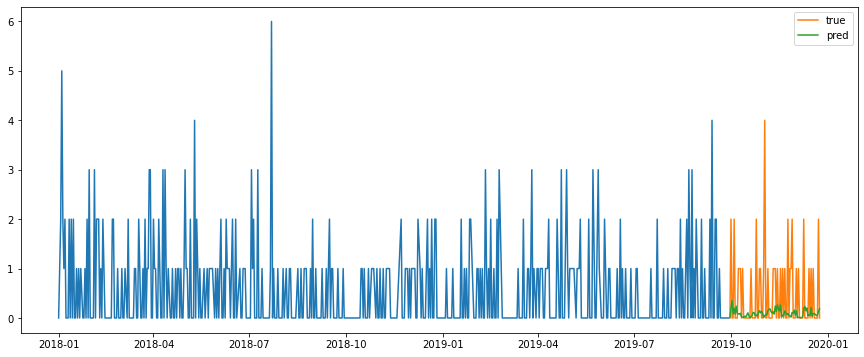

Test MSE: 0.686
Test RMSE: 0.828
Test MAPE: inf
성별:  남성 , 연령:  30대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


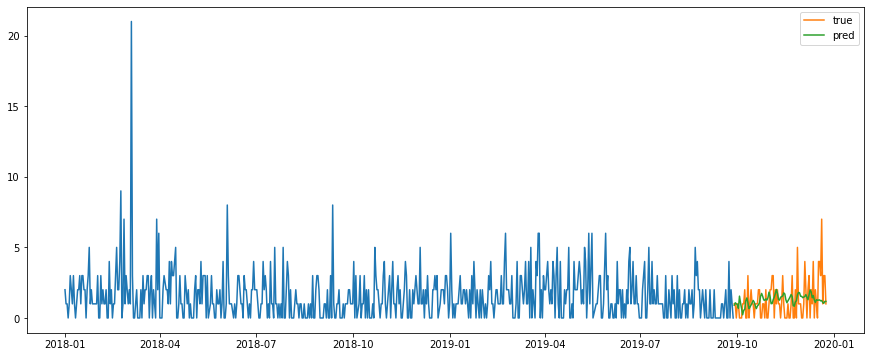

Test MSE: 1.882
Test RMSE: 1.372
Test MAPE: inf
성별:  남성 , 연령:  40대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


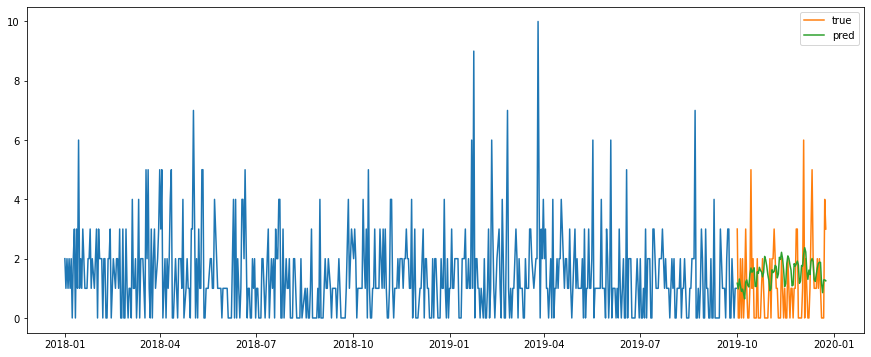

Test MSE: 1.757
Test RMSE: 1.326
Test MAPE: inf
성별:  남성 , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


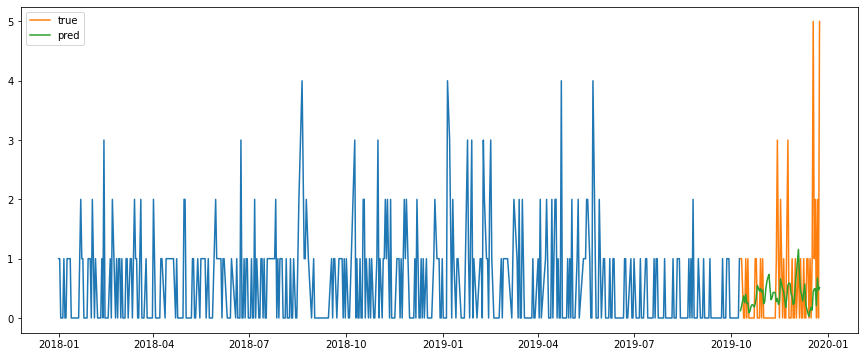

Test MSE: 1.085
Test RMSE: 1.042
Test MAPE: inf
성별:  남성 , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


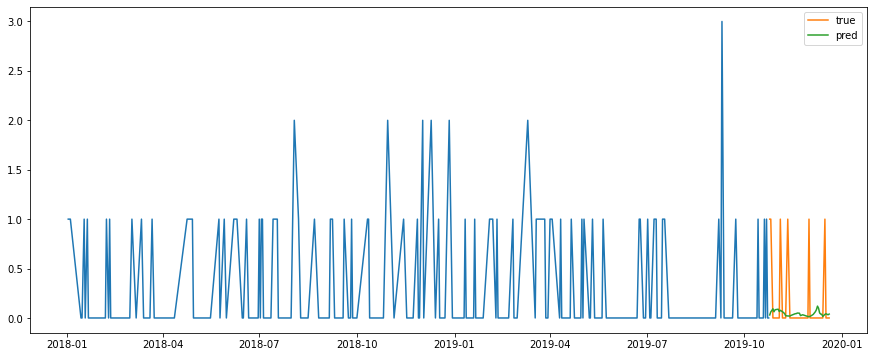

Test MSE: 0.141
Test RMSE: 0.376
Test MAPE: inf
성별:  여성  , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


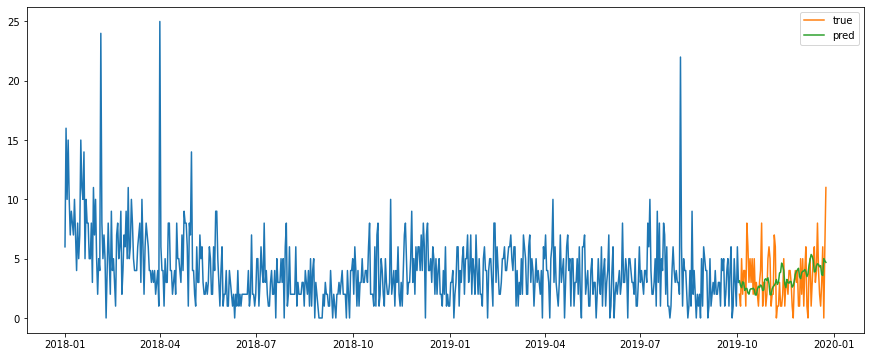

Test MSE: 5.178
Test RMSE: 2.275
Test MAPE: inf
성별:  여성  , 연령:  30대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


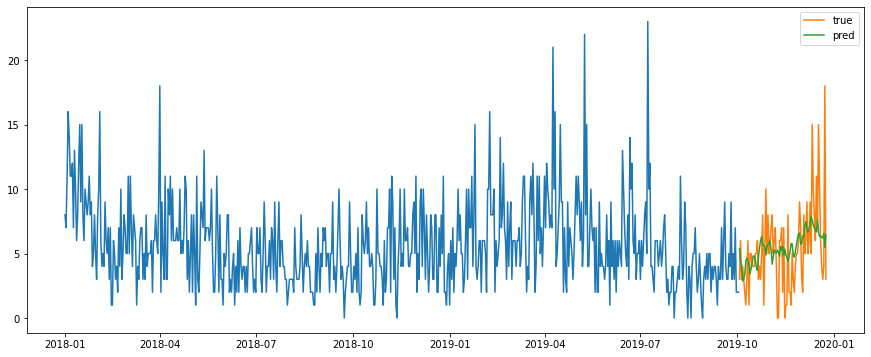

Test MSE: 9.292
Test RMSE: 3.048
Test MAPE: inf
성별:  여성  , 연령:  40대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


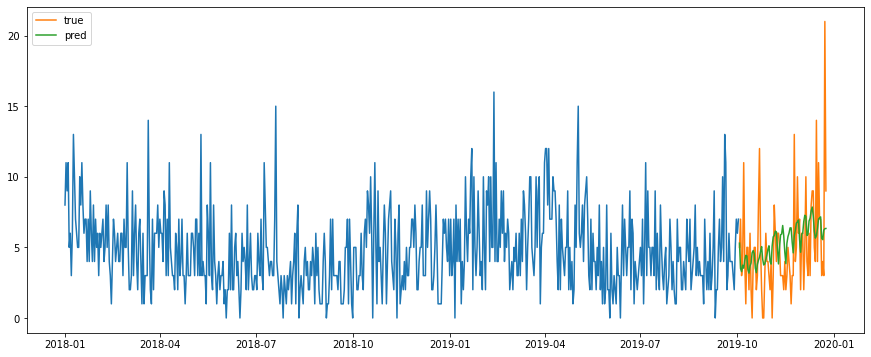

Test MSE: 10.698
Test RMSE: 3.271
Test MAPE: inf
성별:  여성  , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


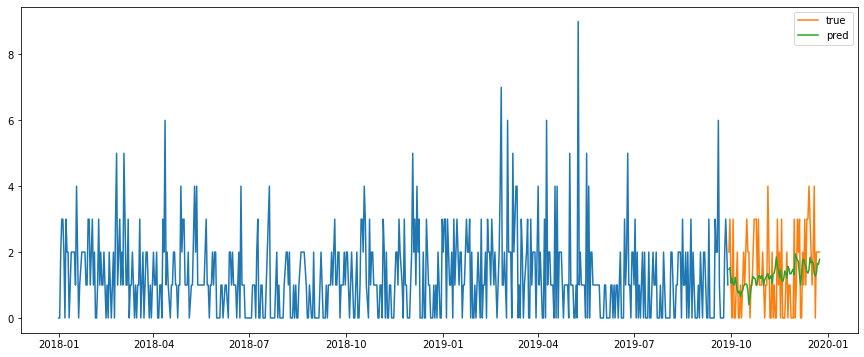

Test MSE: 1.412
Test RMSE: 1.188
Test MAPE: inf
성별:  여성  , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


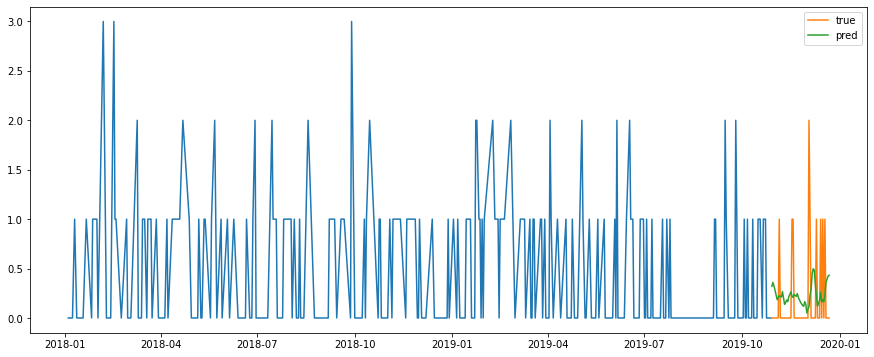

Test MSE: 0.223
Test RMSE: 0.472
Test MAPE: inf
소분류:  색조 메이크업 마스카라
성별:  남성 , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


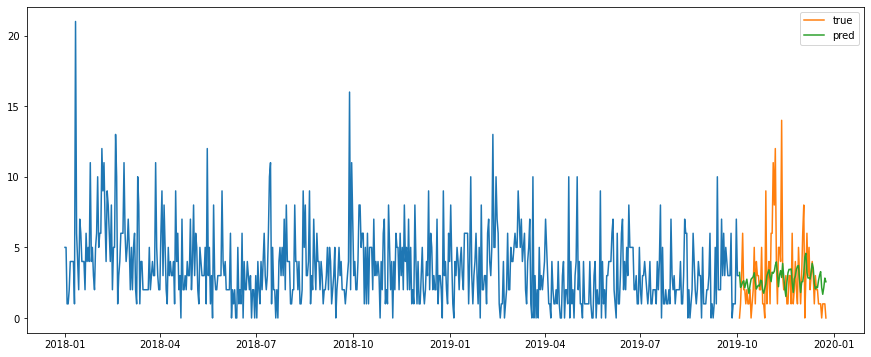

Test MSE: 6.887
Test RMSE: 2.624
Test MAPE: inf
성별:  남성 , 연령:  30대


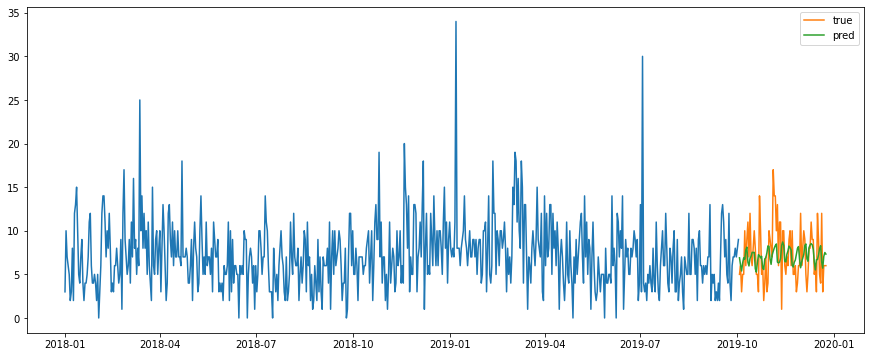

Test MSE: 9.824
Test RMSE: 3.134
Test MAPE: 46.397
성별:  남성 , 연령:  40대


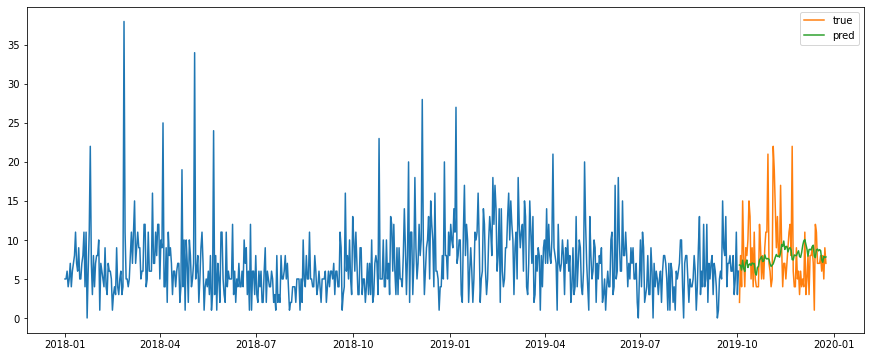

Test MSE: 19.808
Test RMSE: 4.451
Test MAPE: 53.779
성별:  남성 , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


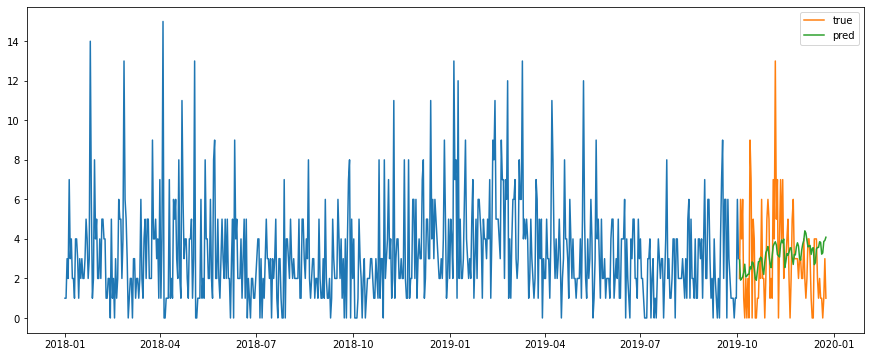

Test MSE: 5.850
Test RMSE: 2.419
Test MAPE: inf
성별:  남성 , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


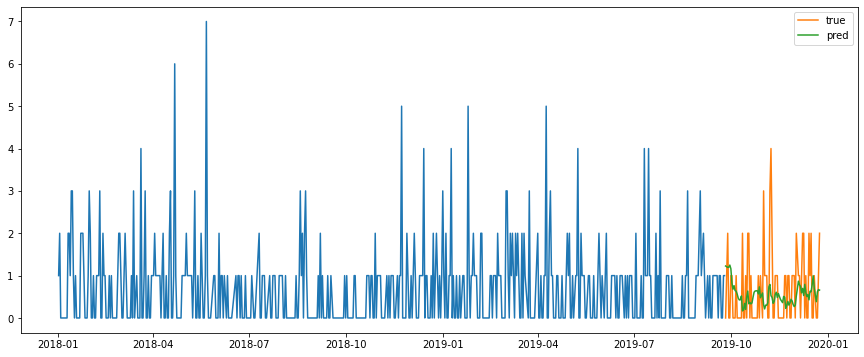

Test MSE: 0.855
Test RMSE: 0.925
Test MAPE: inf
성별:  여성  , 연령:  20대


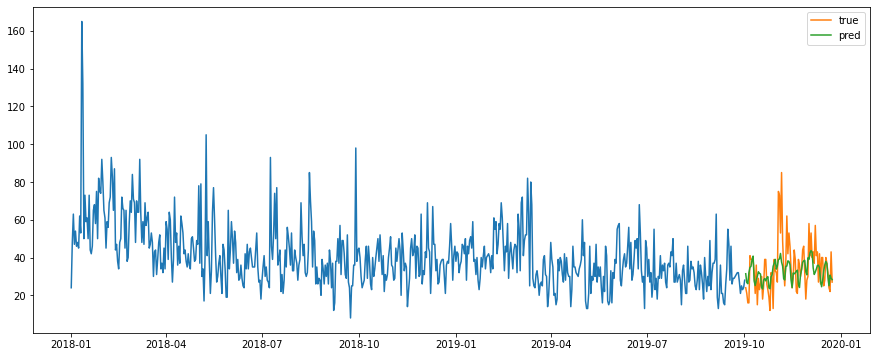

Test MSE: 140.405
Test RMSE: 11.849
Test MAPE: 26.659
성별:  여성  , 연령:  30대


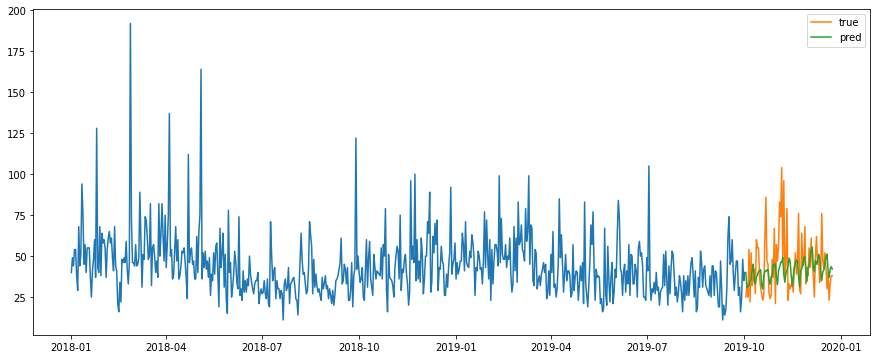

Test MSE: 309.995
Test RMSE: 17.607
Test MAPE: 28.515
성별:  여성  , 연령:  40대


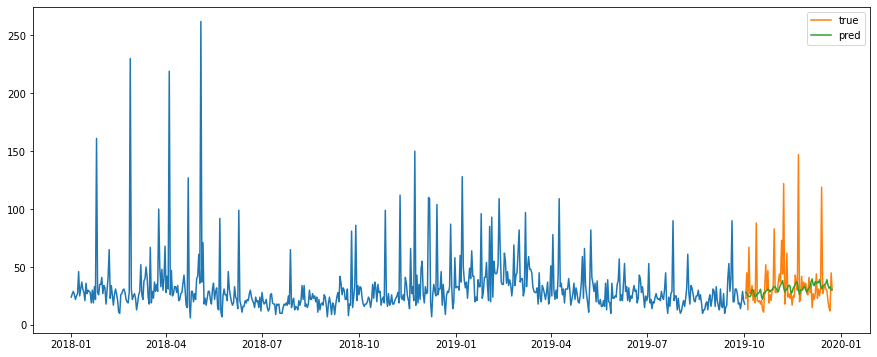

Test MSE: 559.148
Test RMSE: 23.646
Test MAPE: 35.923
성별:  여성  , 연령:  50대


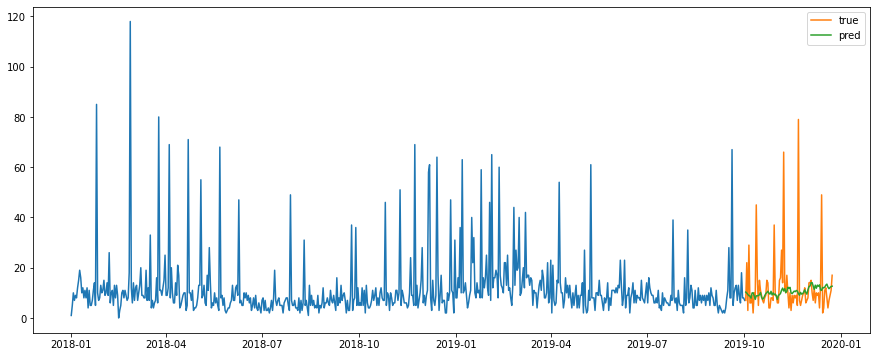

Test MSE: 162.170
Test RMSE: 12.735
Test MAPE: 60.862
성별:  여성  , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


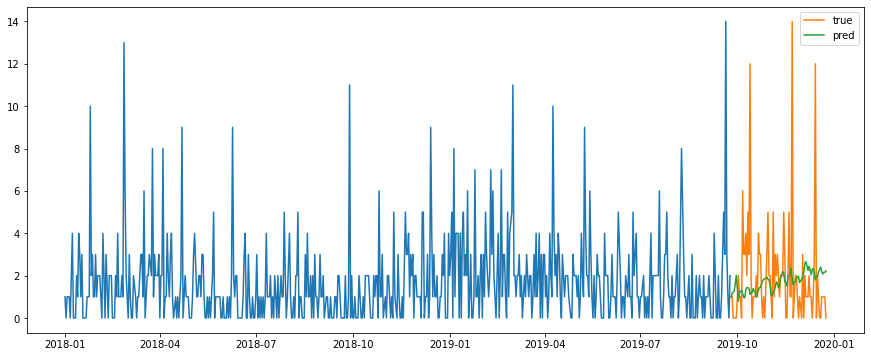

Test MSE: 6.686
Test RMSE: 2.586
Test MAPE: inf
소분류:  색조 메이크업 볼터치
성별:  남성 , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


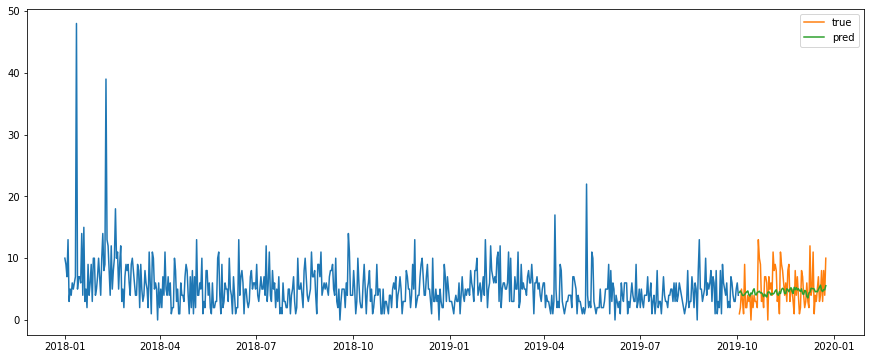

Test MSE: 9.144
Test RMSE: 3.024
Test MAPE: inf
성별:  남성 , 연령:  30대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


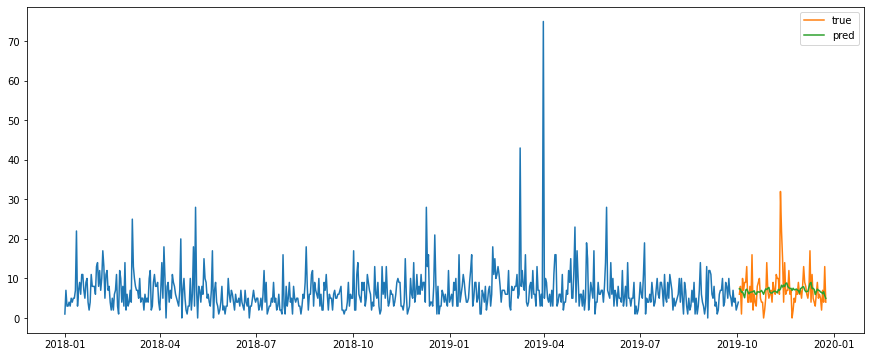

Test MSE: 21.134
Test RMSE: 4.597
Test MAPE: inf
성별:  남성 , 연령:  40대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


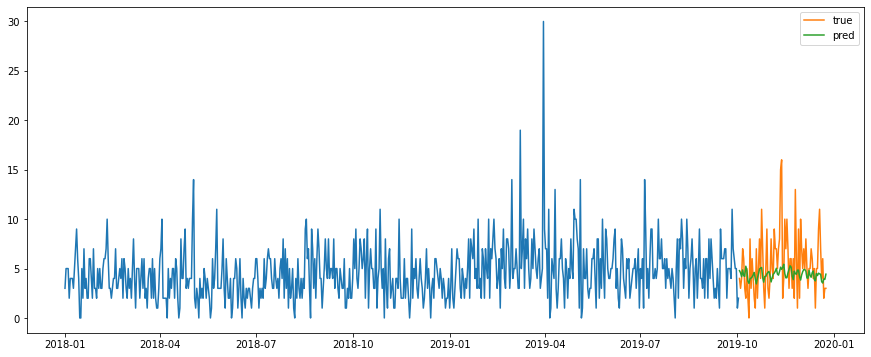

Test MSE: 10.370
Test RMSE: 3.220
Test MAPE: inf
성별:  남성 , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


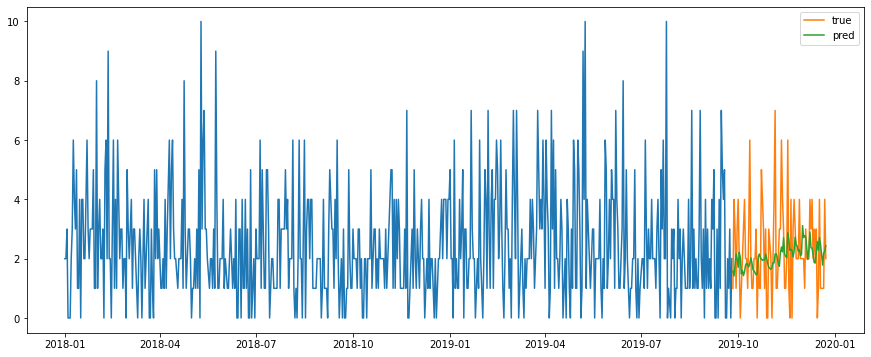

Test MSE: 2.273
Test RMSE: 1.508
Test MAPE: inf
성별:  남성 , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


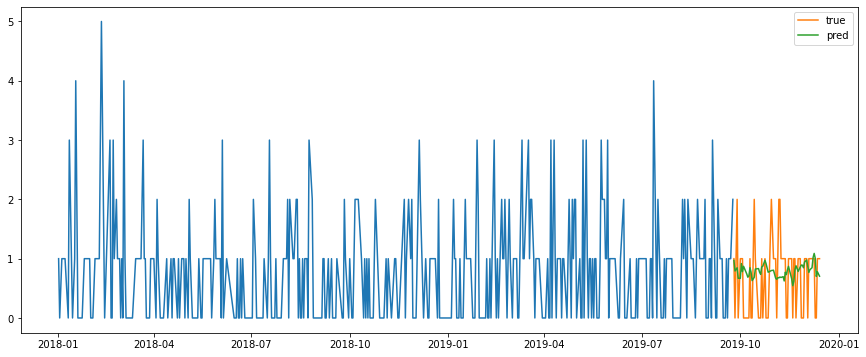

Test MSE: 0.419
Test RMSE: 0.647
Test MAPE: inf
성별:  여성  , 연령:  20대


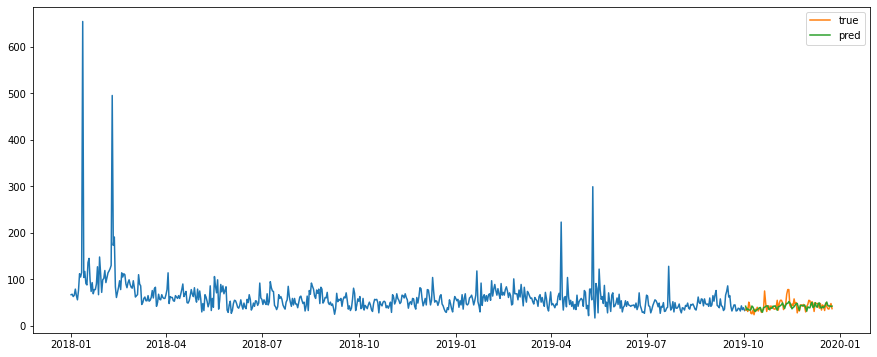

Test MSE: 97.095
Test RMSE: 9.854
Test MAPE: 17.094
성별:  여성  , 연령:  30대


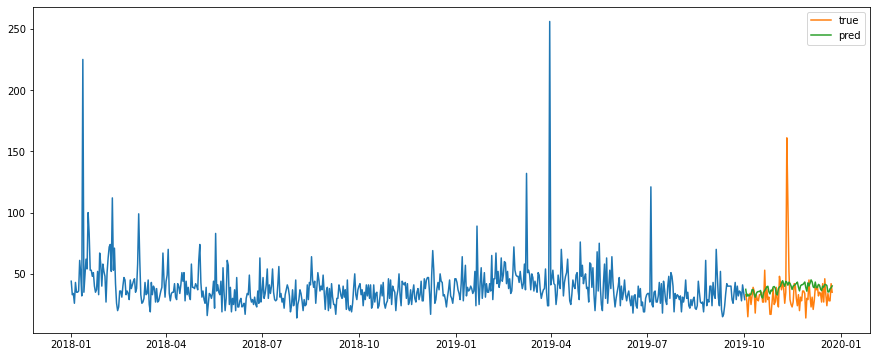

Test MSE: 321.314
Test RMSE: 17.925
Test MAPE: 33.045
성별:  여성  , 연령:  40대


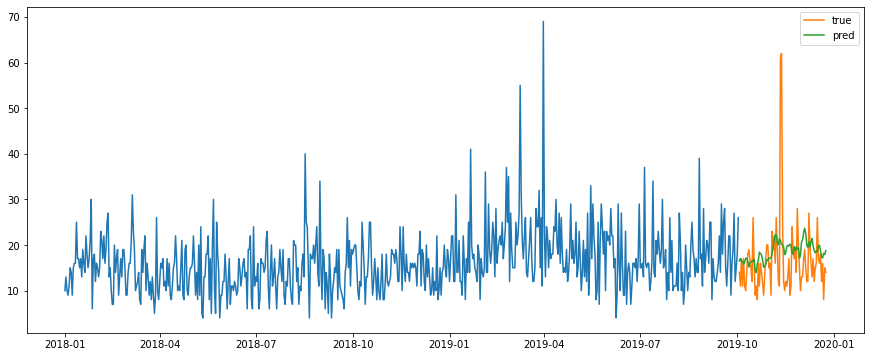

Test MSE: 69.692
Test RMSE: 8.348
Test MAPE: 36.593
성별:  여성  , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


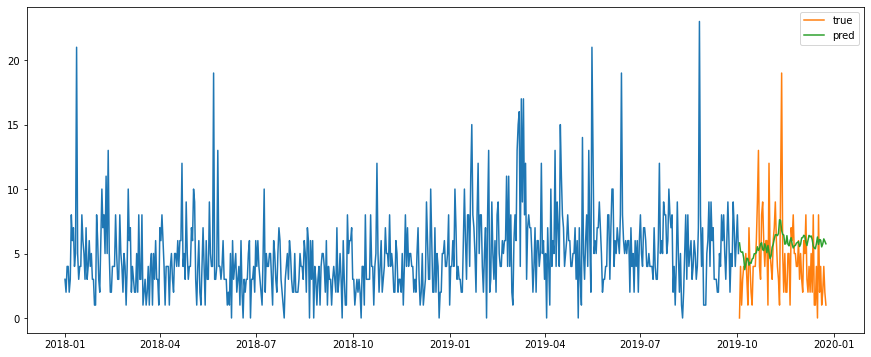

Test MSE: 10.874
Test RMSE: 3.298
Test MAPE: inf
성별:  여성  , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


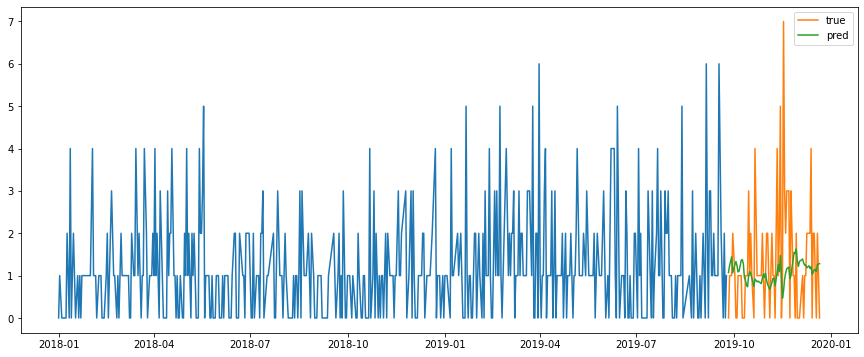

Test MSE: 1.951
Test RMSE: 1.397
Test MAPE: inf
소분류:  색조 메이크업 쉐딩/하이라이터
성별:  남성 , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


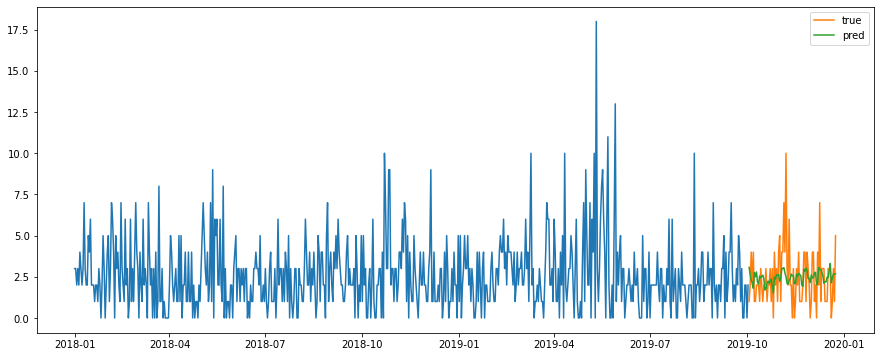

Test MSE: 2.830
Test RMSE: 1.682
Test MAPE: inf
성별:  남성 , 연령:  30대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


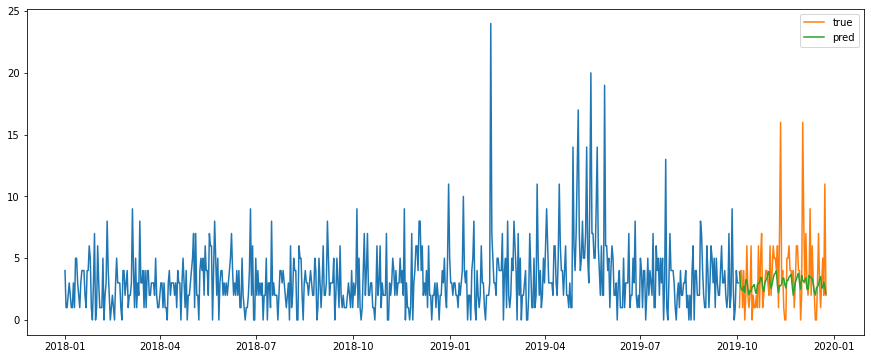

Test MSE: 8.891
Test RMSE: 2.982
Test MAPE: inf
성별:  남성 , 연령:  40대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


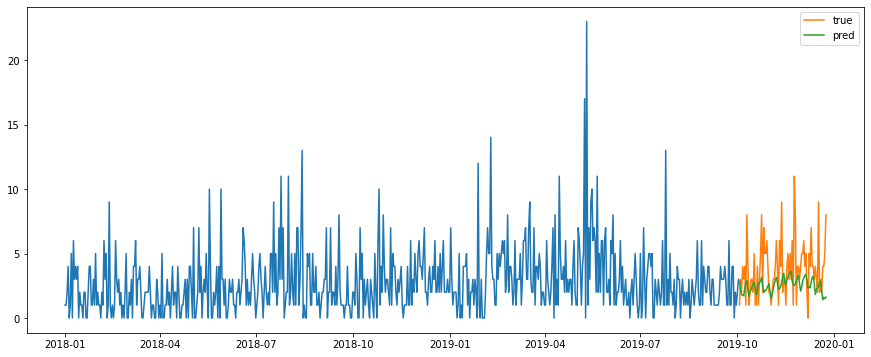

Test MSE: 6.303
Test RMSE: 2.510
Test MAPE: inf
성별:  남성 , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


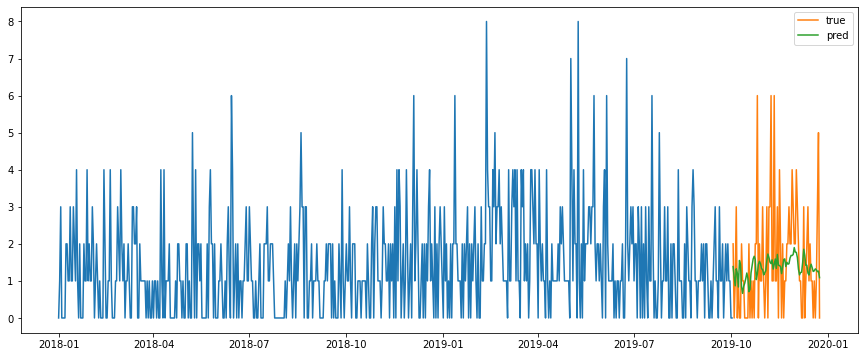

Test MSE: 2.094
Test RMSE: 1.447
Test MAPE: inf
성별:  남성 , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


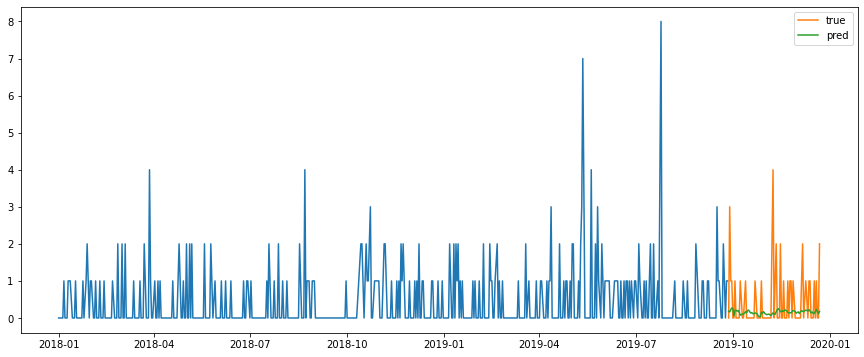

Test MSE: 0.694
Test RMSE: 0.833
Test MAPE: inf
성별:  여성  , 연령:  20대


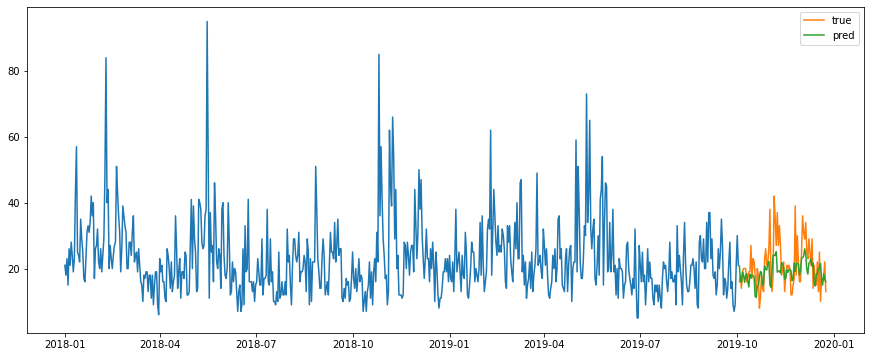

Test MSE: 45.013
Test RMSE: 6.709
Test MAPE: 23.398
성별:  여성  , 연령:  30대


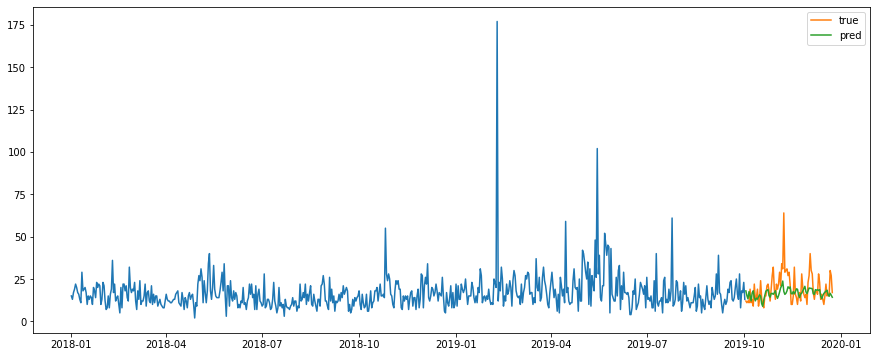

Test MSE: 73.758
Test RMSE: 8.588
Test MAPE: 29.292
성별:  여성  , 연령:  40대


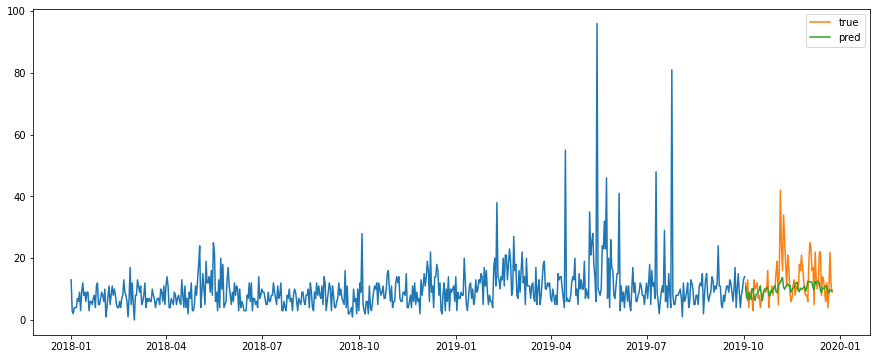

Test MSE: 47.115
Test RMSE: 6.864
Test MAPE: 38.881
성별:  여성  , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


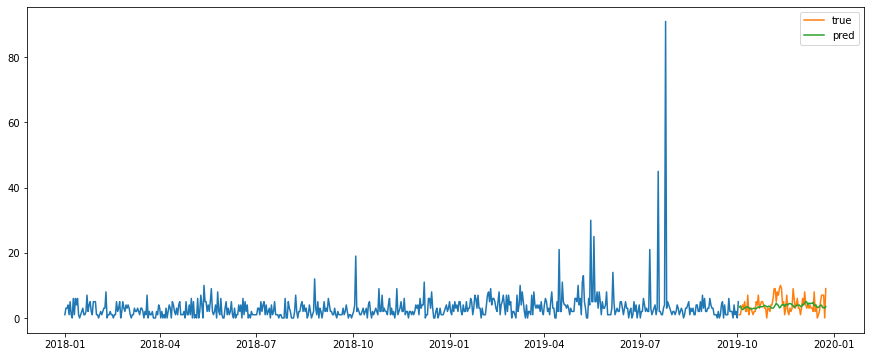

Test MSE: 6.329
Test RMSE: 2.516
Test MAPE: inf
성별:  여성  , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


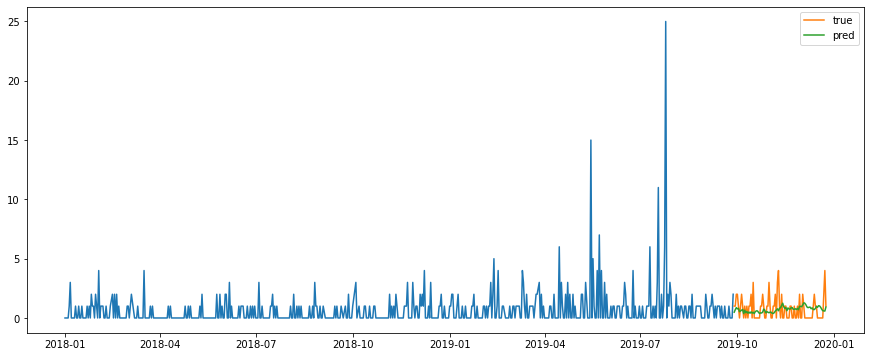

Test MSE: 1.012
Test RMSE: 1.006
Test MAPE: inf
소분류:  생수
성별:  남성 , 연령:  20대


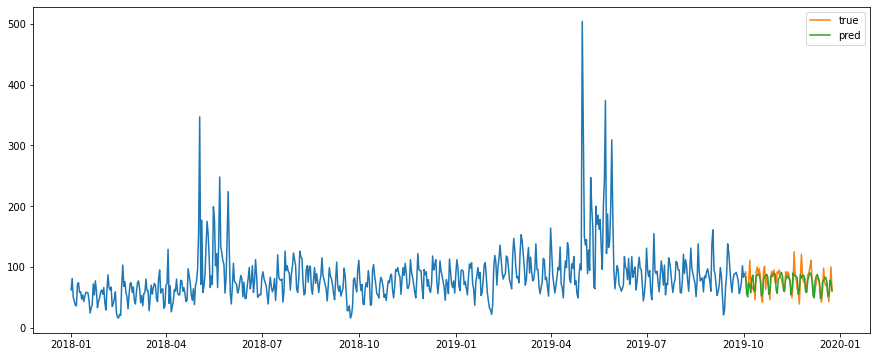

Test MSE: 191.293
Test RMSE: 13.831
Test MAPE: 14.155
성별:  남성 , 연령:  30대


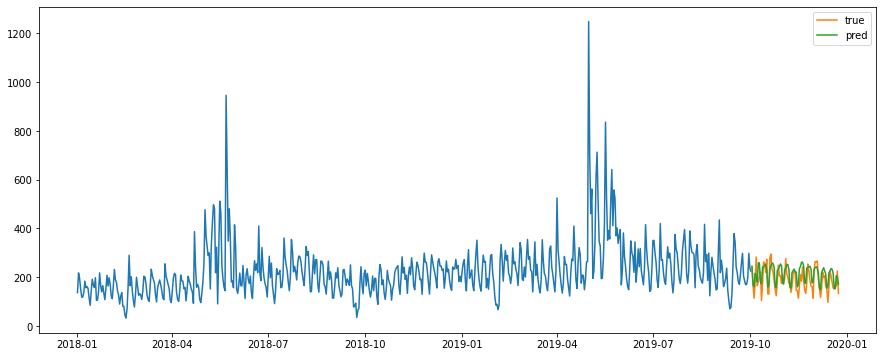

Test MSE: 1792.390
Test RMSE: 42.337
Test MAPE: 20.962
성별:  남성 , 연령:  40대


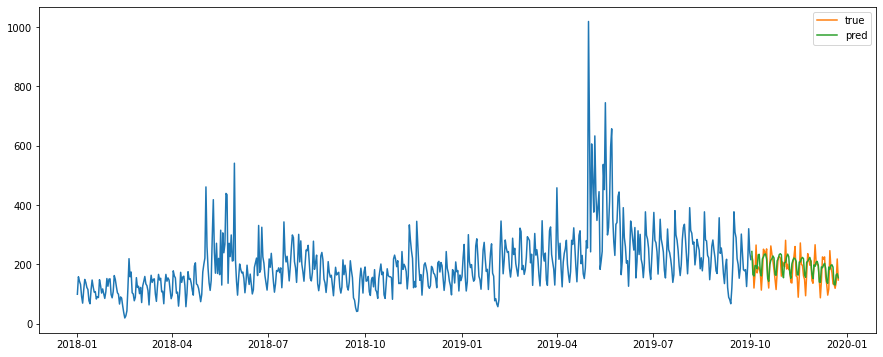

Test MSE: 1377.581
Test RMSE: 37.116
Test MAPE: 18.378
성별:  남성 , 연령:  50대


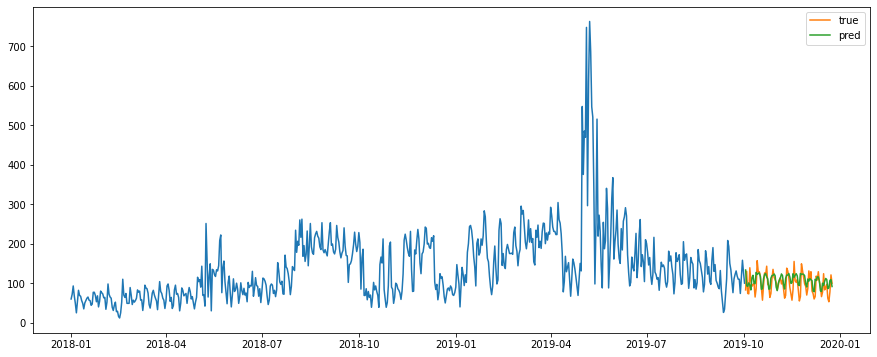

Test MSE: 555.081
Test RMSE: 23.560
Test MAPE: 22.752
성별:  남성 , 연령:  60대


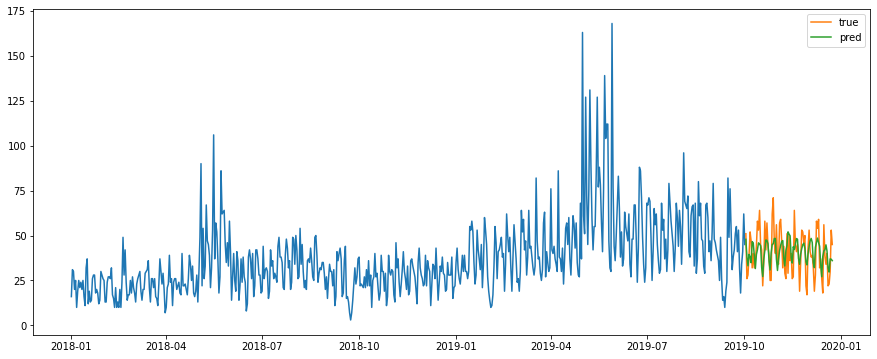

Test MSE: 118.070
Test RMSE: 10.866
Test MAPE: 25.210
성별:  여성  , 연령:  20대


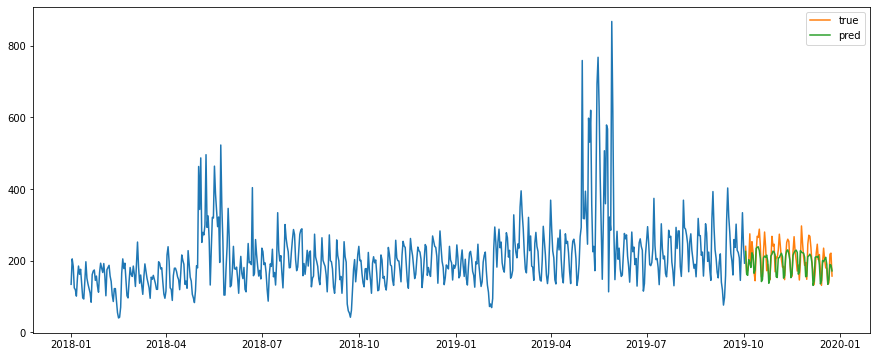

Test MSE: 981.797
Test RMSE: 31.334
Test MAPE: 11.787
성별:  여성  , 연령:  30대


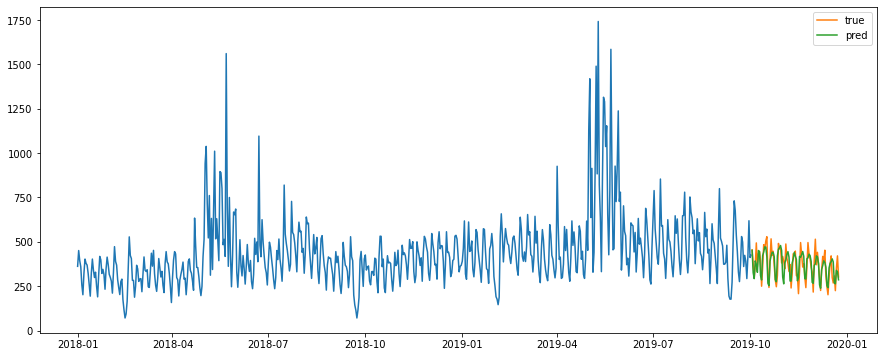

Test MSE: 3455.458
Test RMSE: 58.783
Test MAPE: 13.026
성별:  여성  , 연령:  40대


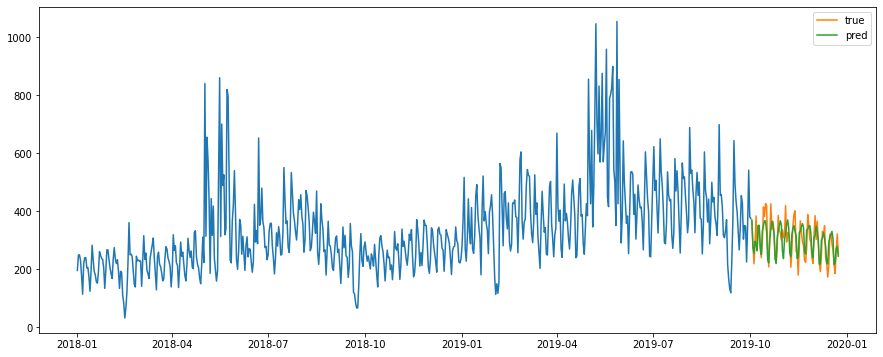

Test MSE: 1810.765
Test RMSE: 42.553
Test MAPE: 11.618
성별:  여성  , 연령:  50대


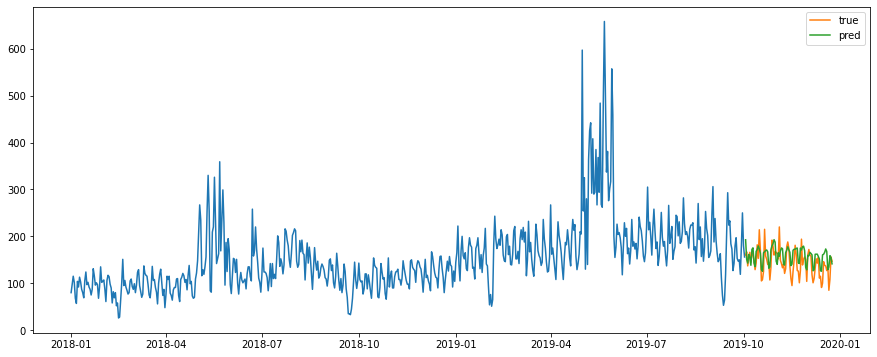

Test MSE: 749.529
Test RMSE: 27.378
Test MAPE: 17.310
성별:  여성  , 연령:  60대


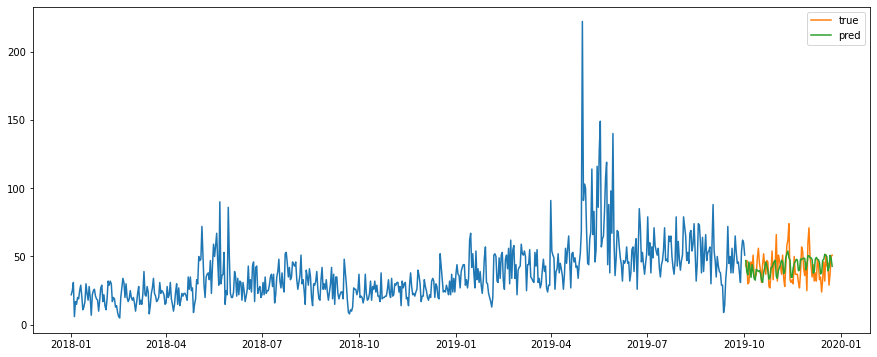

Test MSE: 102.004
Test RMSE: 10.100
Test MAPE: 20.964


In [25]:
# 숫자만 맞춰서 돌려주세요 감삼당..
for sm_cats in df_lstm['sm_cat'].unique()[29:58]:
    print('소분류: ', sm_cats)
    ## 데이터 전처리 ##
    # 각 소분류에 대하여
    df_ex = df_group[df_group['sm_cat']==sm_cats]

    # 성별 1: "여성", 0: "남성"
    for sex in [0,1]:
        df_sex = df_ex[df_ex['sex']==sex]
        
        # 연령
        for age in [[1,0,0,0,0], [0,1,0,0,0], [0,0,1,0,0], [0,0,0,1,0], [0,0,0,0,1]]:
            age_20, age_30, age_40, age_50, age_60 = age[0], age[1], age[2], age[3], age[4]
            df_select = df_sex[(df_sex['age_20']==age_20)&(df_sex['age_30']==age_30)&(df_sex['age_40']==age_40)&(df_sex['age_50']==age_50)&(df_sex['age_60']==age_60)]

            성별 = "여성 "if sex == 1 else "남성"
            연령 = "20대" if age_20 == 1 else "30대" if age_30 == 1 else "40대" if age_40 == 1 else "50대" if age_50 == 1 else "60대"
            print('성별: ', 성별, ", 연령: ", 연령)

            # 지역
            for regions in ['서울','강릉','대구','부산','광주','전주','대전','청주','제주']:
                # 사용할 변수만 선택
                df_select = df_select.rename(columns={"date" : "날짜"})
                default = ['qty', 'ratio','오늘날씨','미세먼지검색량','오늘 비', '기상정보', '태풍정보', 'cnt', '공휴일여부', '주말여부', '날짜']
                causal = []
                df_var = df_causal[df_causal['sm_cat']==sm_cats]
                for cols in df_var.columns.tolist():
                    if len(df_var[df_var[cols]=='causality'])>=1:
                        causal.append(cols)
                default.extend(causal)
                df_use = df_select[default]

                # 지역
                df_merge = df_use.merge(region_weather(regions), on="날짜", how='left')
                df_merge.index = df_merge['날짜']
                df_merge = df_merge.drop(['날짜'], axis=1)

                # 스케일링
                scaler = MinMaxScaler(feature_range=(0, 1))
                df_scale = scaler.fit_transform(df_merge)

                # 데이터 프레임
                n_hours = 7; n_features = df_merge.shape[1]
                df_reframe = series_to_supervised(df_scale, n_hours, 1)

                # 트테분리
                values = df_reframe.values
                n_train_hours = round(df_reframe.shape[0]*0.875) if df_reframe.shape[0] < 720 else 730 - 90
                train = values[:n_train_hours, :]
                test = values[n_train_hours:, :]
                # split into input and outputs
                n_obs = n_hours * n_features
                train_X, train_y = train[:, :n_obs], train[:, -n_features]
                test_X, test_y = test[:, :n_obs], test[:, -n_features]
                # reshape input to be 3D [samples, timesteps, features]
                train_X = train_X.reshape((train_X.shape[0], n_hours, n_features))
                test_X = test_X.reshape((test_X.shape[0], n_hours, n_features))
                
                ## 모델링 ##
                # design network
                model = Sequential()
                model.add(LSTM(50, input_shape=(train_X.shape[1], train_X.shape[2])))
                model.add(Dense(1))
                model.compile(loss='mae', optimizer='adam')

                # fit network
                # verbose = 0: 결과 출력 안하는 옵션
                history = model.fit(train_X, train_y, epochs=50, batch_size=72, validation_data=(test_X, test_y), verbose=0, shuffle=False)

                # make a prediction
                yhat = model.predict(test_X)
                test_X = test_X.reshape((test_X.shape[0], n_hours*n_features))
                # invert scaling for forecast
                inv_yhat = np.concatenate((yhat, test_X[:, -(n_features-1):]), axis=1)
                inv_yhat = scaler.inverse_transform(inv_yhat)
                inv_yhat = inv_yhat[:,0]
                inv_yhat = list([0  if  x<0 else x for x in inv_yhat])
                locals()['pred_'+regions] = inv_yhat
                # invert scaling for actual
                test_y = test_y.reshape((len(test_y), 1))
                inv_y = np.concatenate((test_y, test_X[:, -(n_features-1):]), axis=1)
                inv_y = scaler.inverse_transform(inv_y)
                inv_y = inv_y[:,0]

            # 지역별 가중치 합
            y_pred = loc_weighted_sum(pred_서울, pred_강릉, pred_대구, pred_부산, pred_광주, pred_전주, pred_대전, pred_청주, pred_제주)

            # calculate RMSE
            mse = mean_squared_error(inv_y, y_pred)
            rmse = np.sqrt(mean_squared_error(inv_y, y_pred))
            mape = MAPE(inv_y, y_pred)
            mse_ls.append(mse); rmse_ls.append(rmse); mape_ls.append(mape)

            # plot predict
            plt.figure(figsize=(15,6))
            plt.plot(df_use.iloc[:n_train_hours,:]['qty'])
            plt.plot(df_use.iloc[n_train_hours:-n_hours,:].index, inv_y, label='true')
            plt.plot(df_use.iloc[n_train_hours:-n_hours,:].index, y_pred, label='pred')
            plt.legend()
            plt.show()
            
            print('Test MSE: %.3f' % mse)
            print('Test RMSE: %.3f' % rmse)
            print('Test MAPE: %.3f' % mape)
            print('=========='*10)

            # result
            date.append(df_use.iloc[n_train_hours:-n_hours,:].index)
            sex_ls.append(성별)
            age_ls.append(연령)
            sm_cat.append(sm_cats)
            pred.append(inv_yhat) 
            

In [26]:
# prediction
df_result = pd.DataFrame(columns=['date','sex','age','sm_cat','pred'])
for i in range(len(sm_cat)):
    df_result = pd.concat([df_result, pd.DataFrame({'date':date[i],'pred':pred[i],'sm_cat':sm_cat[i],'sex':sex_ls[i],'age':age_ls[i]})])

df_result.reset_index(drop=True).to_csv('df_pred.csv', encoding='CP949', index=False)

In [27]:
# metric
df_metric = pd.DataFrame({'age':age_ls,'sex':sex_ls,'sm_cat':sm_cat,'mse':mse_ls,'rmse':rmse_ls,'mape':mape_ls})
df_metric.to_csv('df_metric.csv', encoding='CP949', index=False)